In [1]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import datasets
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for testing purposes, please do not change!
from torchsummary import summary
import torch.nn.functional as F

# library to get dataloader
from dataloaders import get_pkmn_dataloader

# library to get loss functions
from loss_functions import *

# generators and discriminators
from DCGeneratorCustom import DCGeneratorCustom
from DCDiscriminatorCustom import DCDiscriminatorCustom
from DCGeneratorStandard import DCGeneratorStandard
from DCDiscriminatorStandard import DCDiscriminatorStandard
from DCDiscriminatorStandardDropout import DCDiscriminatorStandardDropout

# util methods
from utils import get_noise

# whether to use CPU/GPU (pass this along everywhere)
device_str = "cuda:0" if torch.cuda.is_available() else "cpu"
device = torch.device(device_str)

print("Using device: {}".format(device_str))

Using device: cpu


In [2]:
print(torch.__version__)

# if apply_denormalization is true, then we re-scale the images back 
def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28), denorm_transform = None, use_uniform_transform = False):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    
    # We don't specifically need this since we are doing the denormalization ourself
    
    if denorm_transform is not None:
      assert use_uniform_transform == False
      image_tensor = denorm_transform(image_tensor)
    if use_uniform_transform:
      # cannot use both uniform and denorm transform together
      assert denorm_transform == None
      image_tensor = (image_tensor + 1) / 2 # scale from [-1, 1] to [0, 1] space
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=5)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    plt.show()

def save_model(model, output_filename):
  torch.save(model.state_dict(), output_filename)

1.10.2


In [5]:
# playing around with the generator the output shape. These layers give an output shape of 64
show_summary = True
test_batch_size = 4

test_gen = DCGeneratorStandard(hidden_dim = 55)
out = test_gen(torch.ones(test_batch_size,16))

assert out.shape[0] == test_batch_size
assert out.shape[1] == 3 # output should have 3 channels (r,g,b)
assert out.shape[2] == test_gen.output_dim # output should have the proper [width, height]

# shape does not include the batch size
# just force the cpu to display the graph
if show_summary:
  summary(test_gen, (1,16), device = 'cpu')

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
   ConvTranspose2d-1            [-1, 440, 4, 4]         113,080
       BatchNorm2d-2            [-1, 440, 4, 4]             880
              ReLU-3            [-1, 440, 4, 4]               0
   ConvTranspose2d-4            [-1, 220, 8, 8]       1,549,020
       BatchNorm2d-5            [-1, 220, 8, 8]             440
              ReLU-6            [-1, 220, 8, 8]               0
   ConvTranspose2d-7          [-1, 110, 16, 16]         387,310
       BatchNorm2d-8          [-1, 110, 16, 16]             220
              ReLU-9          [-1, 110, 16, 16]               0
  ConvTranspose2d-10           [-1, 55, 32, 32]          96,855
      BatchNorm2d-11           [-1, 55, 32, 32]             110
             ReLU-12           [-1, 55, 32, 32]               0
  ConvTranspose2d-13            [-1, 3, 64, 64]           2,643
             Tanh-14            [-1, 3,

In [6]:
# playing around with the discriminator and the output shape
show_summary = True
test_batch_size = 7

test_disc = DCDiscriminatorCustom(hidden_dim = 64, dropout_prob = 0.1)
out = test_disc(torch.ones(test_batch_size, 3, 64, 64))

print(out.shape)

# output shape is (1,64) ---> why does it have 64 dimensions ? Don't we want a single prediction between 0 and 1 ?
assert out.shape[0] == test_batch_size
assert out.shape[1] == 1 # should only have one probability for the output

if show_summary:
  summary(test_disc, (3, 64, 64), device = 'cpu')

torch.Size([7, 1])
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           [-1, 64, 31, 31]           3,136
       BatchNorm2d-2           [-1, 64, 31, 31]             128
         LeakyReLU-3           [-1, 64, 31, 31]               0
            Conv2d-4          [-1, 128, 14, 14]         131,200
       BatchNorm2d-5          [-1, 128, 14, 14]             256
         LeakyReLU-6          [-1, 128, 14, 14]               0
            Conv2d-7              [-1, 1, 6, 6]           2,049
           Flatten-8                   [-1, 36]               0
           Dropout-9                   [-1, 36]               0
           Linear-10                    [-1, 1]              37
          Sigmoid-11                    [-1, 1]               0
Total params: 136,806
Trainable params: 136,806
Non-trainable params: 0
----------------------------------------------------------------
Input size 

In [7]:
# ======= Define the basic hyper-parameters =====


# training epochs (50 seems to work well, takes a while before it generates good results)
n_epochs = 150
# dimension of noise vector
z_dim = 32
hidden_dim_gen = 55
hidden_dim_disc = 64
batch_size = 32
# how often to display images and debug info. Basically, the numerator is how many images you want to
# process before showing some debug info
display_step = int((4000 / batch_size))
periodic_saving = True
# after how many epochs do you save the model?
epoch_save_step = 1
save_prefix = "experiment_3/dc_gen_standard_dc_disc_custom_p01"

print("Planning to display images every {} steps".format(display_step))

# other sources say 0.00275 works better...but the DCGAn paper used 0.0002 (ie. about 10-4 instead of 10-3)
gen_lr = 0.0002 # 0.0002 works for both, but takes at least 10-15 epochs before anything interesting happens?
disc_lr = 0.0002
beta_1 = 0.5
beta_2 = 0.999
disc_repeats = 1
gen_repeats = 1

# loss functions
gen_loss_func = get_generator_loss_func("basic_gen_loss")
disc_loss_func = get_disc_loss_func("noisy_disc_loss")

assert imgs_to_display <= batch_size

Planning to display images every 125 steps


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/1234 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


[Dataloader Stats] Final mean per channel is: tensor([0.8914, 0.8799, 0.8626]), final std per channel is: tensor([0.2062, 0.2199, 0.2391])


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


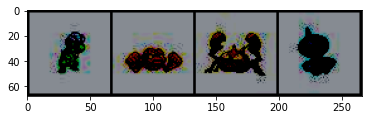

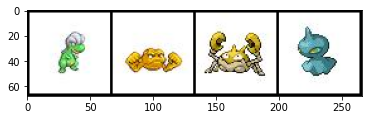

In [8]:
# Create the dataloader, based on the appropriate batch size. 

show_preview = True
dataloader_name = "shiny_64_dim_normalize_and_random_flip_concat_from_data"
pkmn_dataloader, denorm_transform = get_pkmn_dataloader(dataloader_name, batch_size)
test_size = 4

# show a batch before and after denorm
test_data_iter = iter(pkmn_dataloader)
test_images, test_labels = next(test_data_iter)

# shape = (bs, num_channels, width, height)
#print(test_images.shape)
#print(test_labels)

if show_preview:
  show_tensor_images(test_images[0:test_size], num_images = test_size, size = (3,64,64), denorm_transform = None)
  show_tensor_images(test_images[0:test_size], num_images = test_size, size = (3,64,64), denorm_transform = denorm_transform)


In [9]:
# Create the generator/discriminator and use them
# layer initialization for Generator and Discriminator (for Conv2d and ConvTranpose2d)

gen = DCGeneratorStandard(z_dim = z_dim, hidden_dim = hidden_dim_gen).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=gen_lr, betas=(beta_1, beta_2))
disc = DCDiscriminatorCustom(hidden_dim = hidden_dim_disc).to(device) 
disc_opt = torch.optim.Adam(disc.parameters(), lr=disc_lr, betas=(beta_1, beta_2))

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
disc = disc.apply(weights_init)


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


Step 125: Epoch: 0: Generator loss: 0.7732285656929017, discriminator loss: 0.5990919632911682 mean disc pred on real images: 0.6167763471603394, fake images: 0.4847065210342407


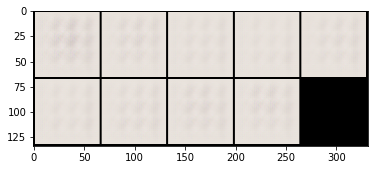

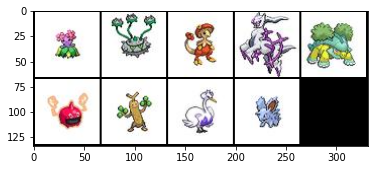

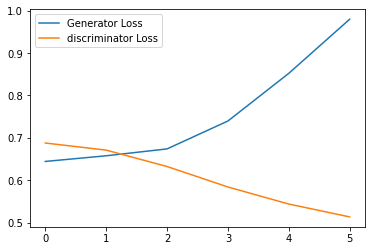

Step 250: Epoch: 0: Generator loss: 1.1599121770858765, discriminator loss: 0.5201724910736084 mean disc pred on real images: 0.6590595841407776, fake images: 0.3833671510219574


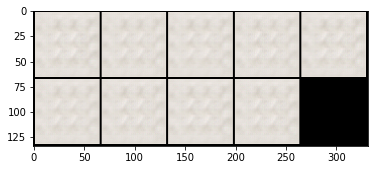

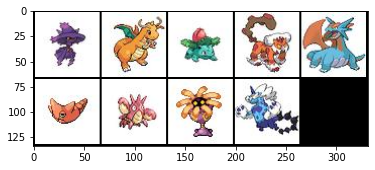

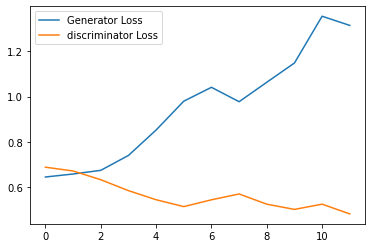

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_250.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 375: Epoch: 1: Generator loss: 1.4258377630710601, discriminator loss: 0.513455463886261 mean disc pred on real images: 0.6725085377693176, fake images: 0.34513387084007263


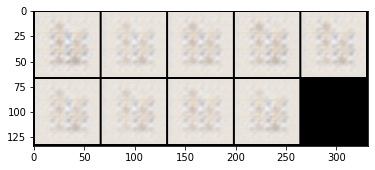

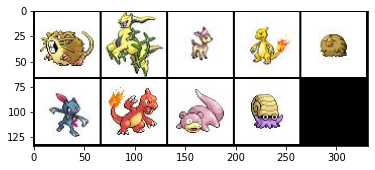

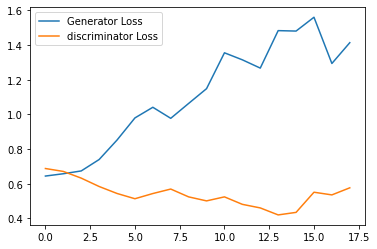

Step 500: Epoch: 1: Generator loss: 1.3976751828193665, discriminator loss: 0.521477956533432 mean disc pred on real images: 0.6723266839981079, fake images: 0.37536001205444336


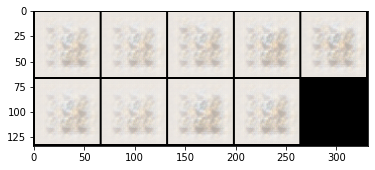

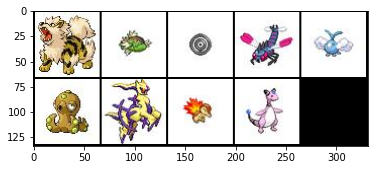

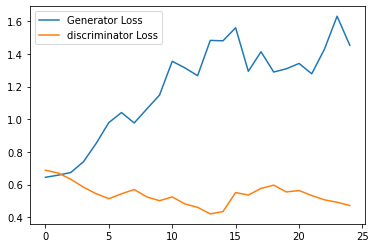

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_500.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 625: Epoch: 2: Generator loss: 1.4157948007583618, discriminator loss: 0.5114995515346528 mean disc pred on real images: 0.6728891730308533, fake images: 0.3539509177207947


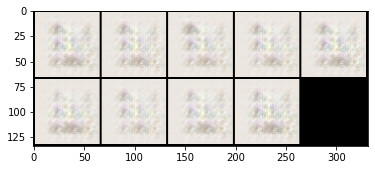

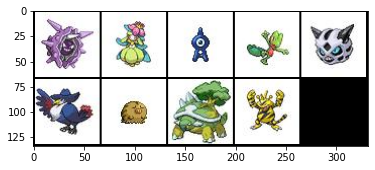

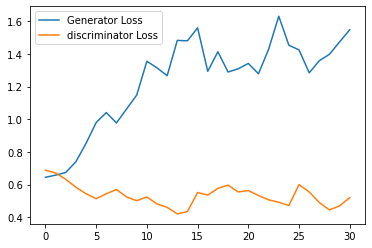

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 750: Epoch: 2: Generator loss: 1.327094604730606, discriminator loss: 0.5578009729385376 mean disc pred on real images: 0.655532717704773, fake images: 0.39014357328414917


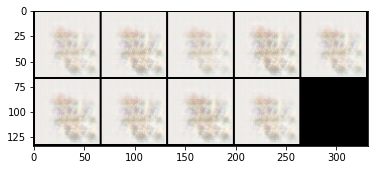

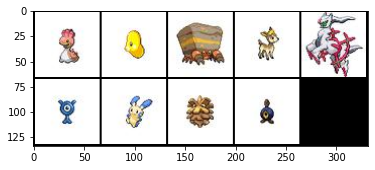

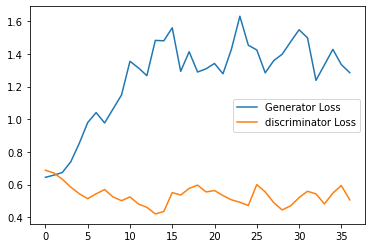

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_750.pt !


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 875: Epoch: 2: Generator loss: 1.1551387207508088, discriminator loss: 0.6028462369441986 mean disc pred on real images: 0.5978444814682007, fake images: 0.4266457259654999


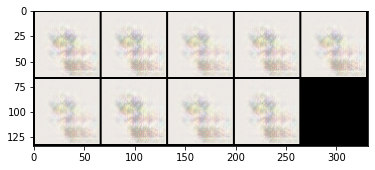

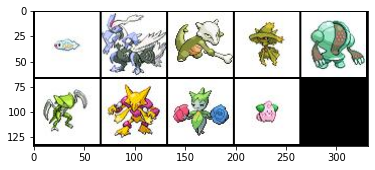

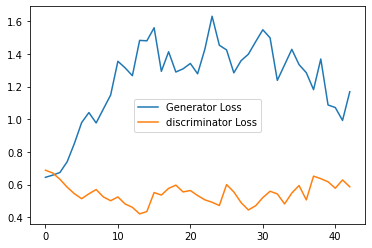

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fd068fc50e0>
Traceback (most recent call last):
  File "/Users/moose_abdool/miniconda3/envs/cs236g_py37/lib/python3.7/site-packages/torch/utils/data/dataloader.py", line 1328, in __del__
    self._shutdown_workers()
  File "/Users/moose_abdool/miniconda3/envs/cs236g_py37/lib/python3.7/site-packages/torch/utils/data/dataloader.py", line 1320, in _shutdown_workers
    if w.is_alive():
  File "/Users/moose_abdool/miniconda3/envs/cs236g_py37/lib/python3.7/multiprocessing/process.py", line 151, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: [W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fd068fc50e0>
Traceba

Step 1000: Epoch: 3: Generator loss: 1.1589689993858336, discriminator loss: 0.6046431832313538 mean disc pred on real images: 0.5833146572113037, fake images: 0.4206312596797943


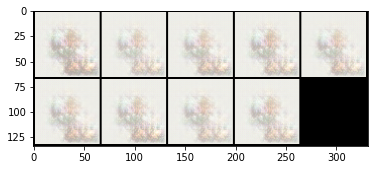

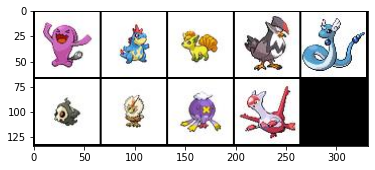

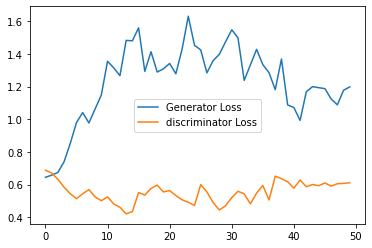

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_1000.pt !


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1125: Epoch: 3: Generator loss: 1.1607365062236785, discriminator loss: 0.5799844496250153 mean disc pred on real images: 0.6144556999206543, fake images: 0.41531383991241455


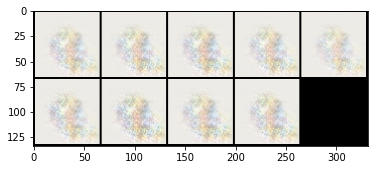

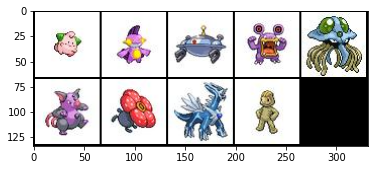

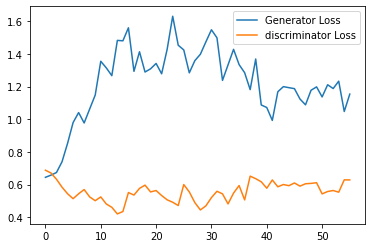

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1250: Epoch: 4: Generator loss: 1.1720470280647277, discriminator loss: 0.5732199826240539 mean disc pred on real images: 0.6217475533485413, fake images: 0.4138467609882355


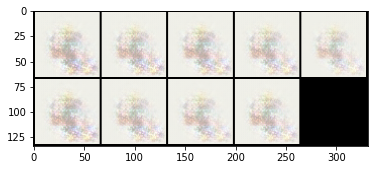

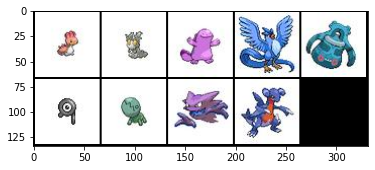

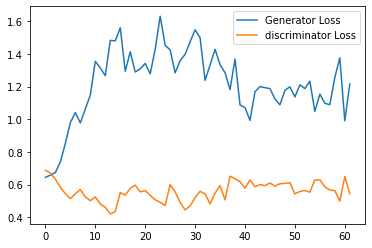

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_1250.pt !


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1375: Epoch: 4: Generator loss: 1.1248172664642333, discriminator loss: 0.5980402202606201 mean disc pred on real images: 0.593372106552124, fake images: 0.42966726422309875


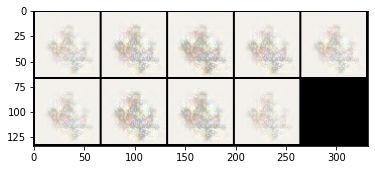

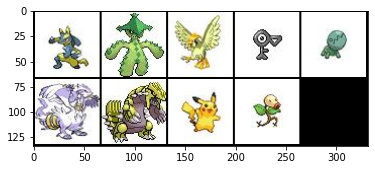

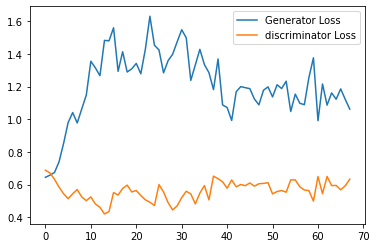

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1500: Epoch: 4: Generator loss: 1.1572216153144836, discriminator loss: 0.6177938921451569 mean disc pred on real images: 0.596257209777832, fake images: 0.4333696663379669


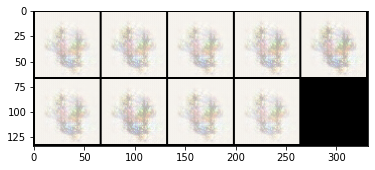

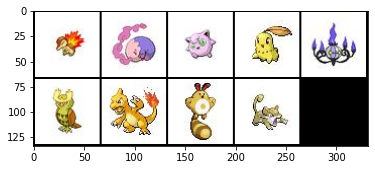

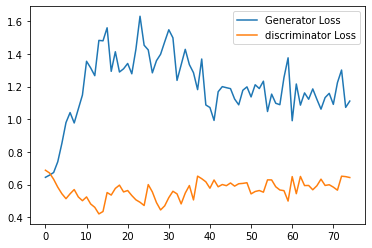

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_1500.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1625: Epoch: 5: Generator loss: 1.0302061524391175, discriminator loss: 0.6453942427635193 mean disc pred on real images: 0.5496700406074524, fake images: 0.4600245952606201


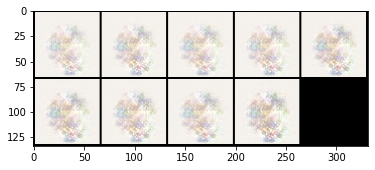

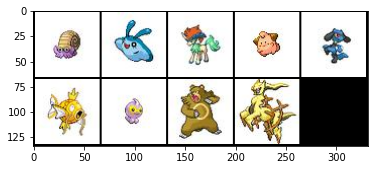

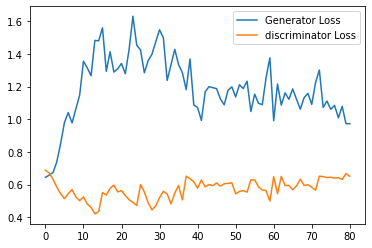

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1750: Epoch: 5: Generator loss: 0.9731125435829162, discriminator loss: 0.628020733833313 mean disc pred on real images: 0.5586513876914978, fake images: 0.45540422201156616


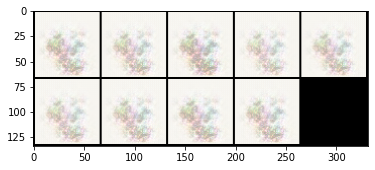

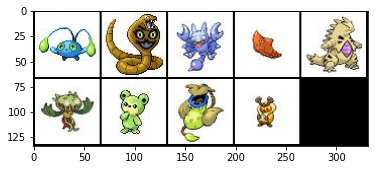

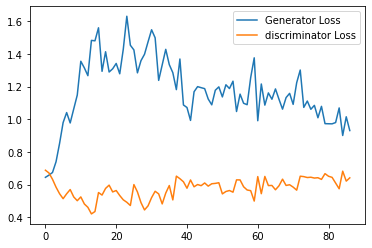

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_1750.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1875: Epoch: 6: Generator loss: 0.9913765656948089, discriminator loss: 0.6243132481575012 mean disc pred on real images: 0.5596328377723694, fake images: 0.44918856024742126


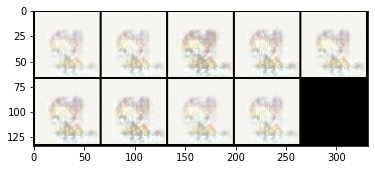

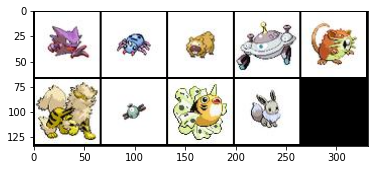

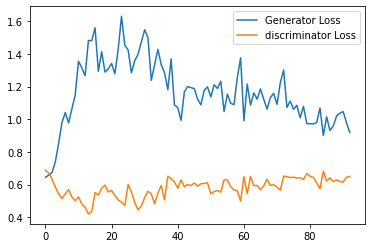

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2000: Epoch: 6: Generator loss: 1.0514308547973632, discriminator loss: 0.5837560017108917 mean disc pred on real images: 0.6099536418914795, fake images: 0.43973734974861145


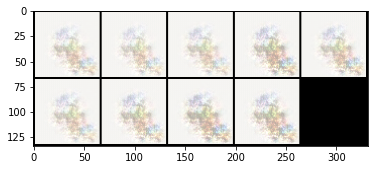

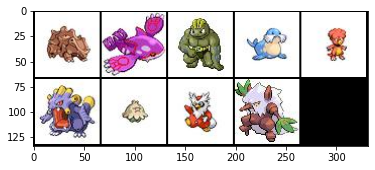

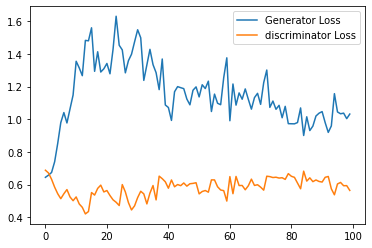

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_2000.pt !


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2125: Epoch: 6: Generator loss: 1.115119664669037, discriminator loss: 0.5869692606925965 mean disc pred on real images: 0.5997626185417175, fake images: 0.4272657632827759


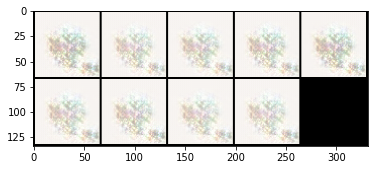

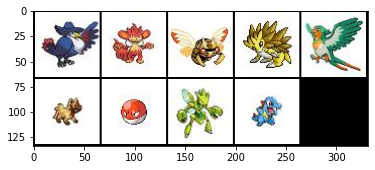

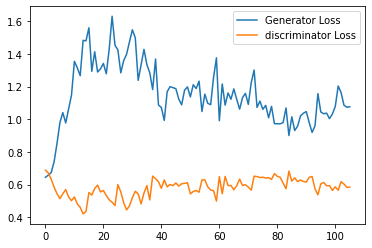

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2250: Epoch: 7: Generator loss: 1.1443114762306212, discriminator loss: 0.6114972486495972 mean disc pred on real images: 0.5813902616500854, fake images: 0.42780208587646484


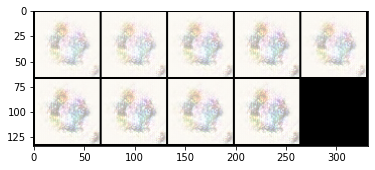

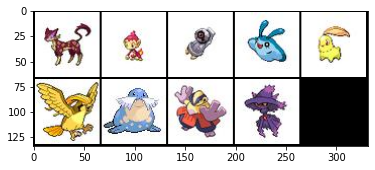

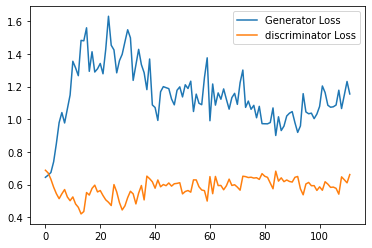

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_2250.pt !


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2375: Epoch: 7: Generator loss: 1.0831990690231323, discriminator loss: 0.5900202994346618 mean disc pred on real images: 0.6160441637039185, fake images: 0.4418485164642334


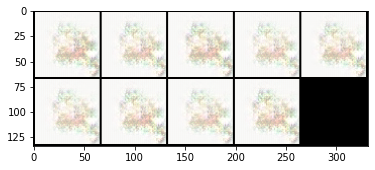

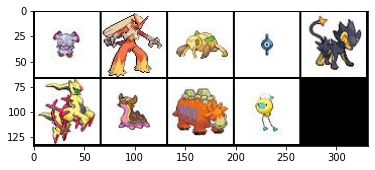

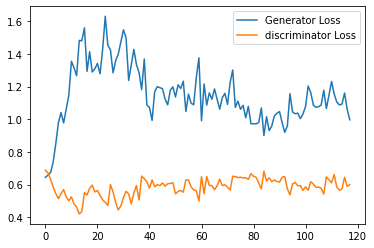

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2500: Epoch: 8: Generator loss: 1.1167421462535858, discriminator loss: 0.6325729405879974 mean disc pred on real images: 0.5569776892662048, fake images: 0.43669602274894714


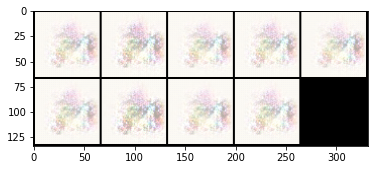

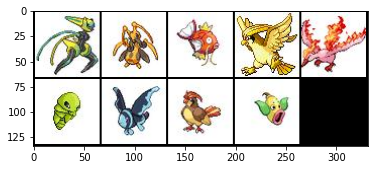

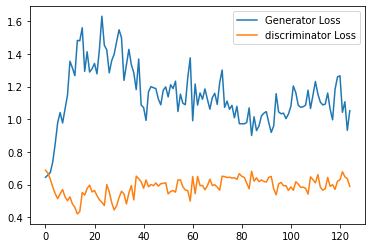

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_2500.pt !
Step 2625: Epoch: 8: Generator loss: 1.0097334237098694, discriminator loss: 0.6343387343883514 mean disc pred on real images: 0.5626864433288574, fake images: 0.45645758509635925


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


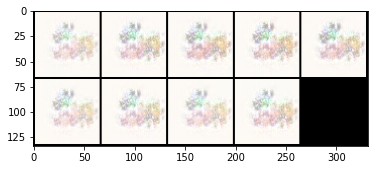

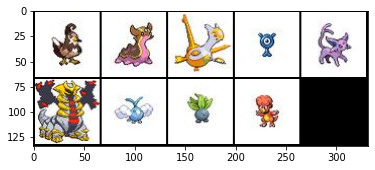

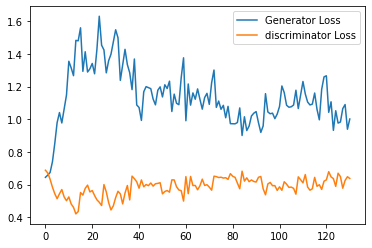

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2750: Epoch: 8: Generator loss: 1.0975372595787047, discriminator loss: 0.600113626241684 mean disc pred on real images: 0.5992433428764343, fake images: 0.428072065114975


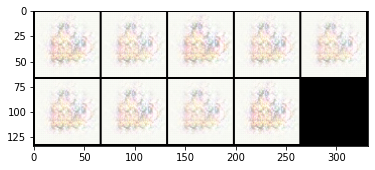

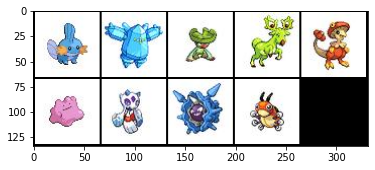

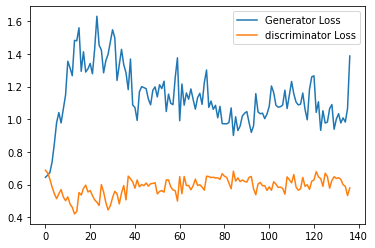

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_2750.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2875: Epoch: 9: Generator loss: 1.1859162418842315, discriminator loss: 0.587514398097992 mean disc pred on real images: 0.5922064781188965, fake images: 0.4065087139606476


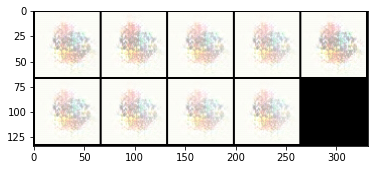

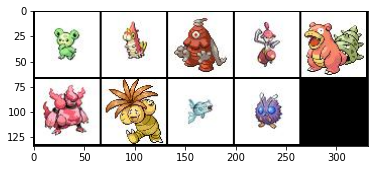

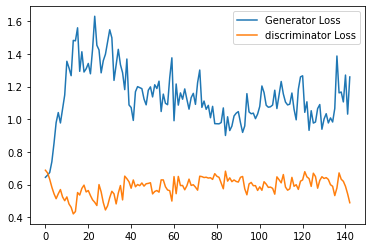

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 3000: Epoch: 9: Generator loss: 1.1797235908508301, discriminator loss: 0.5931254916191101 mean disc pred on real images: 0.6080817580223083, fake images: 0.4300229549407959


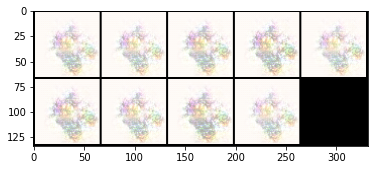

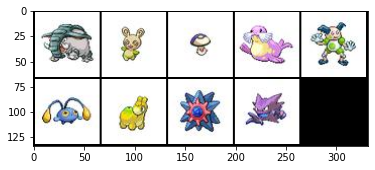

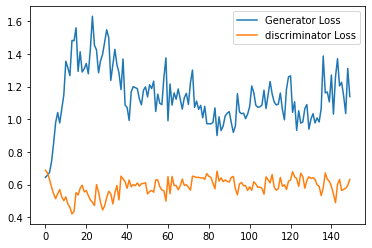

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_3000.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 3125: Epoch: 10: Generator loss: 1.1375886340141297, discriminator loss: 0.5967932004928589 mean disc pred on real images: 0.5765863656997681, fake images: 0.4212040603160858


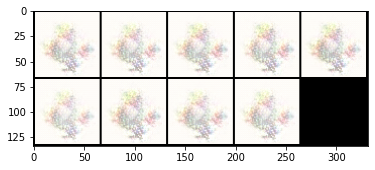

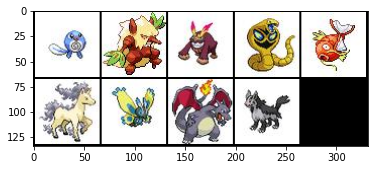

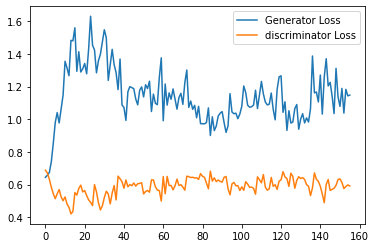

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 3250: Epoch: 10: Generator loss: 1.163414261341095, discriminator loss: 0.5659288713932037 mean disc pred on real images: 0.6177021861076355, fake images: 0.4169391691684723


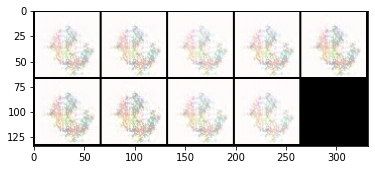

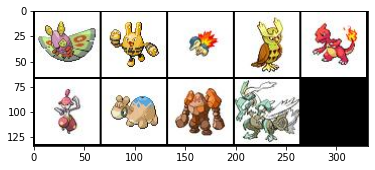

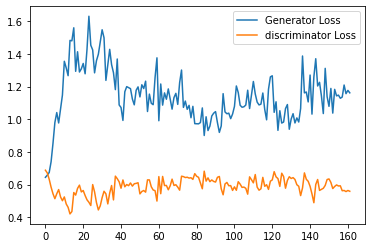

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_3250.pt !


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 3375: Epoch: 10: Generator loss: 1.262117477416992, discriminator loss: 0.564420640707016 mean disc pred on real images: 0.6256142854690552, fake images: 0.40704068541526794


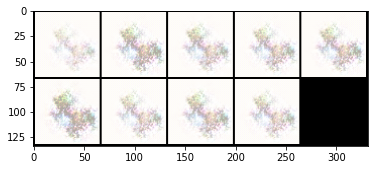

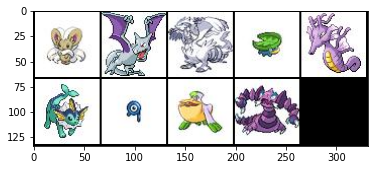

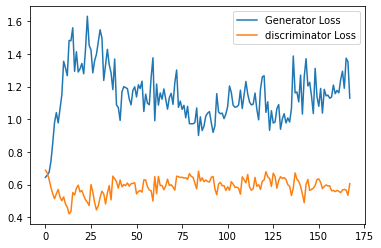

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 3500: Epoch: 11: Generator loss: 1.232385447740555, discriminator loss: 0.5526842913627624 mean disc pred on real images: 0.6315526366233826, fake images: 0.3918769061565399


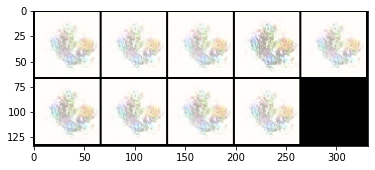

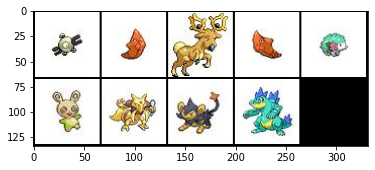

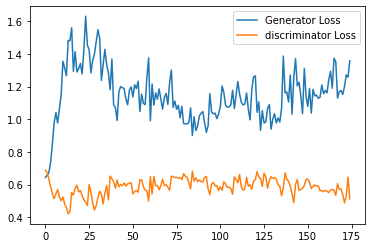

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_3500.pt !


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 3625: Epoch: 11: Generator loss: 1.2765933108329772, discriminator loss: 0.546973299741745 mean disc pred on real images: 0.6606100797653198, fake images: 0.4012516736984253


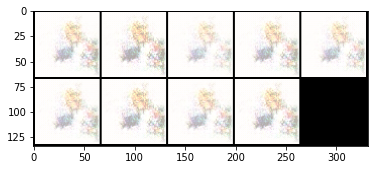

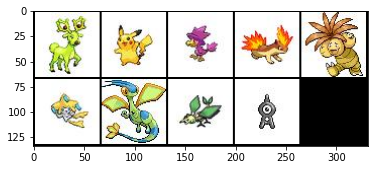

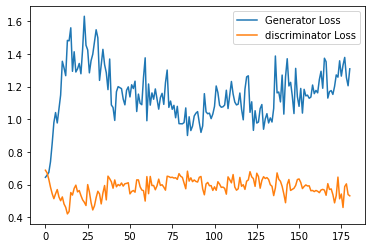

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fd068fc50e0>
Traceback (most recent call last):
  File "/Users/moose_abdool/miniconda3/envs/cs236g_py37/lib/python3.7/site-packages/torch/utils/data/dataloader.py", line 1328, in __del__
    self._shutdown_workers()
  File "/Users/moose_abdool/miniconda3/envs/cs236g_py37/lib/python3.7/site-packages/torch/utils/data/dataloader.py", line 1320, in _shutdown_workers
    if w.is_alive():
  File "/Users/moose_abdool/miniconda3/envs/cs236g_py37/lib/python3.7/multiprocessing/process.py", line 151, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fd068fc50e0>
Traceba

Step 3750: Epoch: 12: Generator loss: 1.3308005867004395, discriminator loss: 0.562009174823761 mean disc pred on real images: 0.615704357624054, fake images: 0.3911212682723999


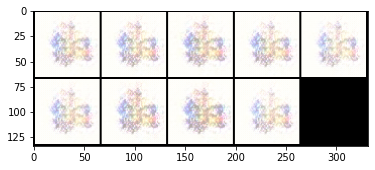

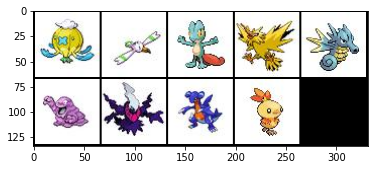

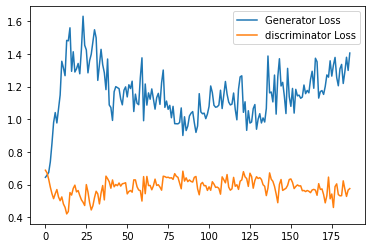

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_3750.pt !


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 3875: Epoch: 12: Generator loss: 1.2173977370262146, discriminator loss: 0.569918219089508 mean disc pred on real images: 0.6175537109375, fake images: 0.40948545932769775


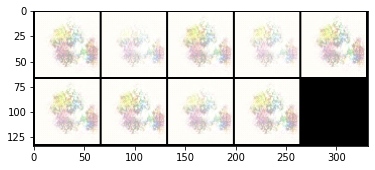

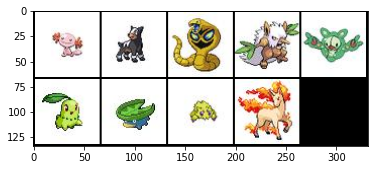

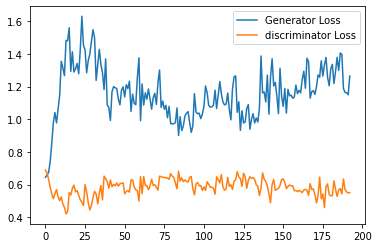

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 4000: Epoch: 12: Generator loss: 1.1336443662643432, discriminator loss: 0.6085235517024994 mean disc pred on real images: 0.574125349521637, fake images: 0.4256354570388794


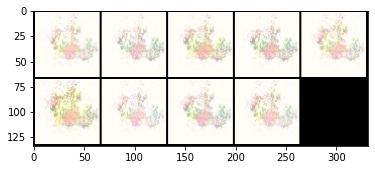

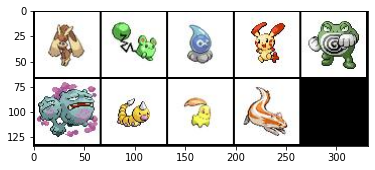

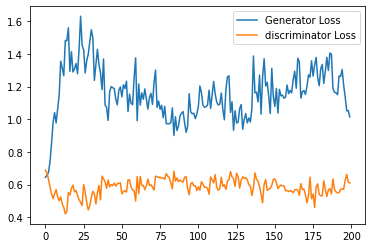

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_4000.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 4125: Epoch: 13: Generator loss: 1.000777494907379, discriminator loss: 0.6339884266853333 mean disc pred on real images: 0.5582456588745117, fake images: 0.44746118783950806


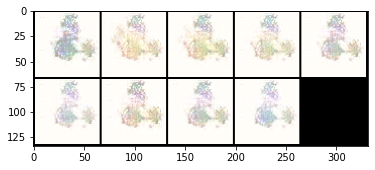

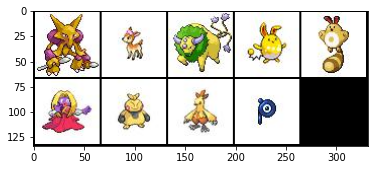

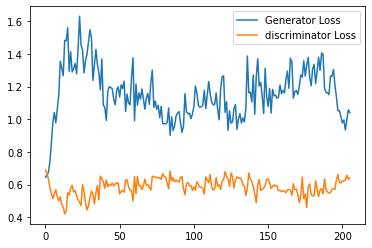

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 4250: Epoch: 13: Generator loss: 1.0347929303646088, discriminator loss: 0.6306042127609253 mean disc pred on real images: 0.5537532567977905, fake images: 0.4386741816997528


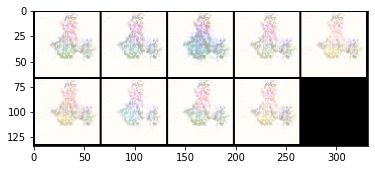

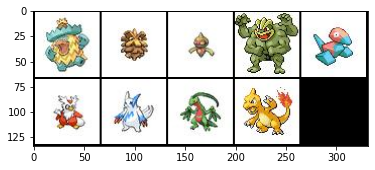

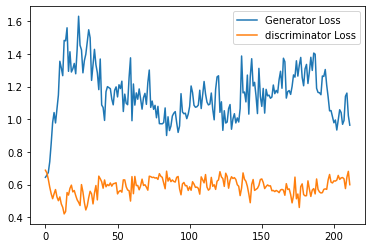

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_4250.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 4375: Epoch: 14: Generator loss: 1.0392393593788147, discriminator loss: 0.6336214509010315 mean disc pred on real images: 0.5438253283500671, fake images: 0.43385744094848633


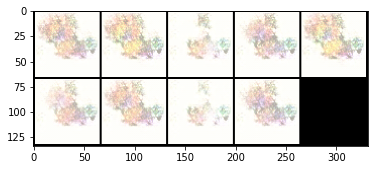

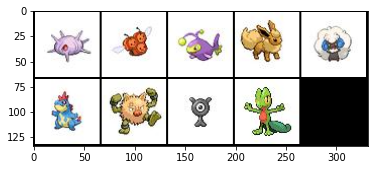

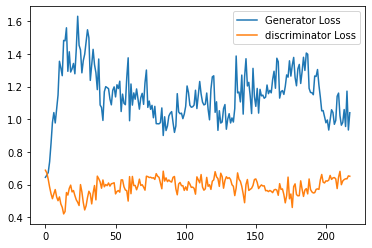

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 4500: Epoch: 14: Generator loss: 0.9394174122810364, discriminator loss: 0.6256620092391968 mean disc pred on real images: 0.5641804933547974, fake images: 0.4565083384513855


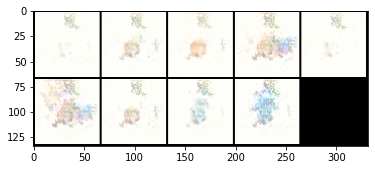

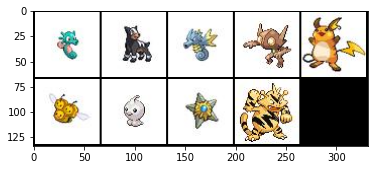

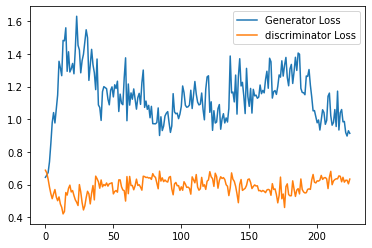

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_4500.pt !


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 4625: Epoch: 14: Generator loss: 0.8793324832916259, discriminator loss: 0.6552660083770752 mean disc pred on real images: 0.5432273149490356, fake images: 0.4696785807609558


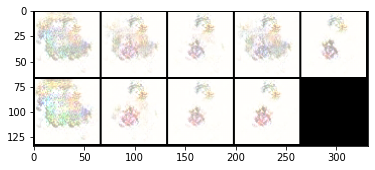

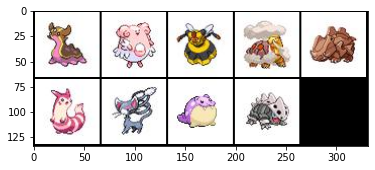

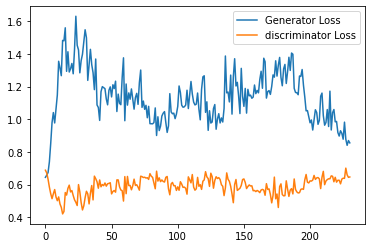

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 4750: Epoch: 15: Generator loss: 0.8774666309356689, discriminator loss: 0.667436264038086 mean disc pred on real images: 0.5175312757492065, fake images: 0.4640423655509949


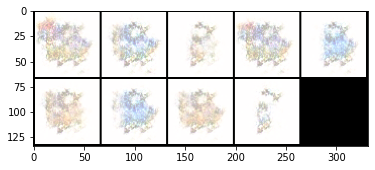

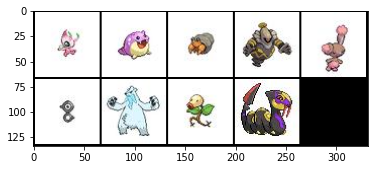

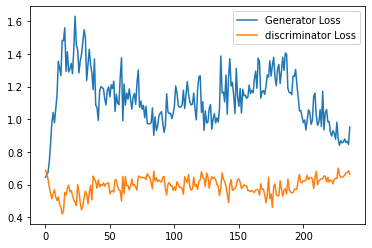

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_4750.pt !


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 4875: Epoch: 15: Generator loss: 0.9120144963264465, discriminator loss: 0.6678845357894897 mean disc pred on real images: 0.5223692059516907, fake images: 0.47140178084373474


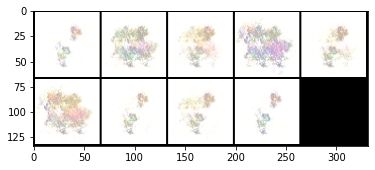

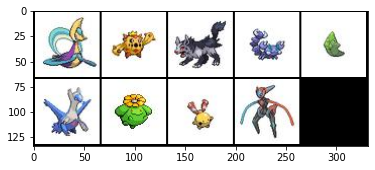

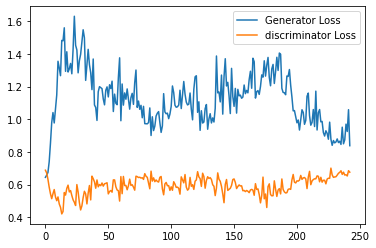

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 5000: Epoch: 16: Generator loss: 0.8381022250652314, discriminator loss: 0.6604735159873962 mean disc pred on real images: 0.5465112328529358, fake images: 0.4822933077812195


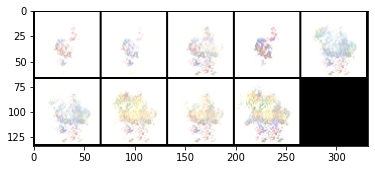

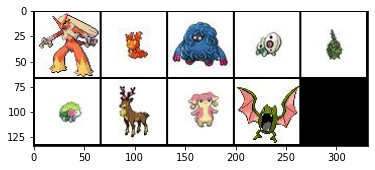

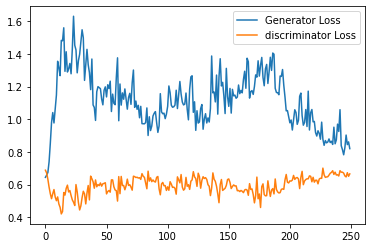

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_5000.pt !


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 5125: Epoch: 16: Generator loss: 0.8522136902809143, discriminator loss: 0.6776971225738525 mean disc pred on real images: 0.5231155157089233, fake images: 0.4780616760253906


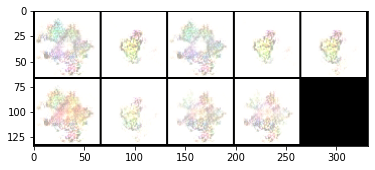

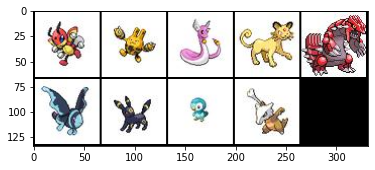

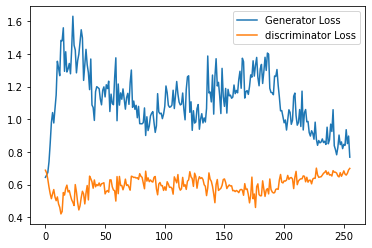

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 5250: Epoch: 16: Generator loss: 0.8303545055389404, discriminator loss: 0.6726773166656494 mean disc pred on real images: 0.5189387798309326, fake images: 0.4770794212818146


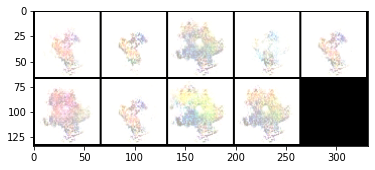

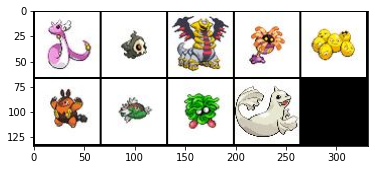

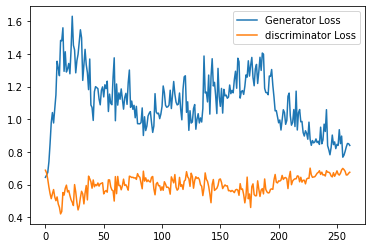

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_5250.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 5375: Epoch: 17: Generator loss: 0.8197476527690888, discriminator loss: 0.6740211172103882 mean disc pred on real images: 0.5152586698532104, fake images: 0.47957322001457214


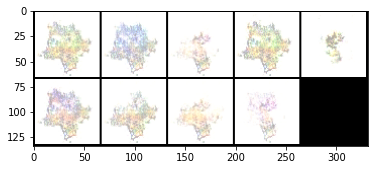

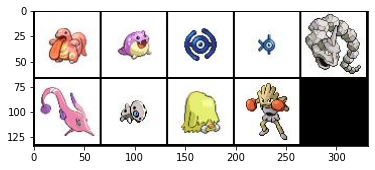

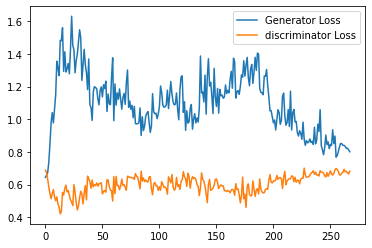

Step 5500: Epoch: 17: Generator loss: 0.8867271320819855, discriminator loss: 0.6498933119773864 mean disc pred on real images: 0.5358419418334961, fake images: 0.4622071087360382


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


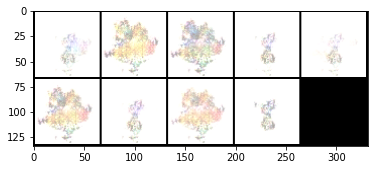

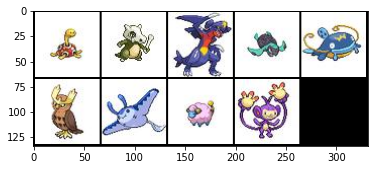

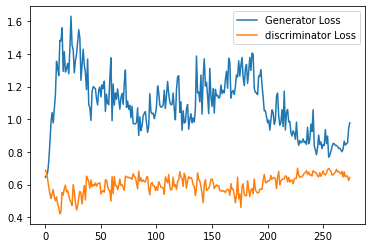

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_5500.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 5625: Epoch: 18: Generator loss: 0.9335983082056045, discriminator loss: 0.6650438017845154 mean disc pred on real images: 0.5393418669700623, fake images: 0.4636267125606537


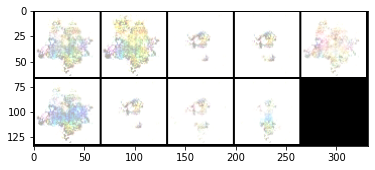

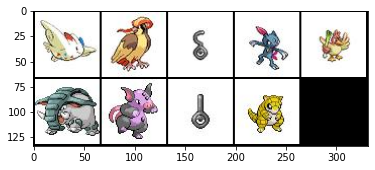

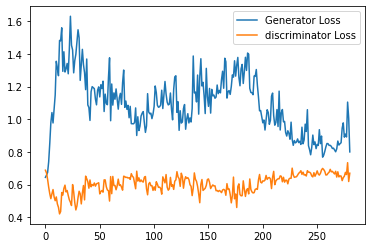

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 5750: Epoch: 18: Generator loss: 0.87324627327919, discriminator loss: 0.6573548107147217 mean disc pred on real images: 0.5371378064155579, fake images: 0.47157374024391174


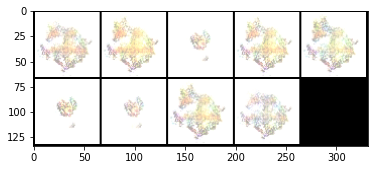

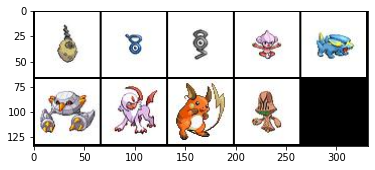

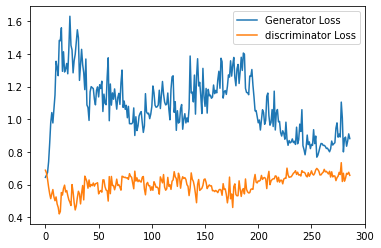

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_5750.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 5875: Epoch: 19: Generator loss: 0.8418837563991547, discriminator loss: 0.6649432616233826 mean disc pred on real images: 0.5374578833580017, fake images: 0.4814070463180542


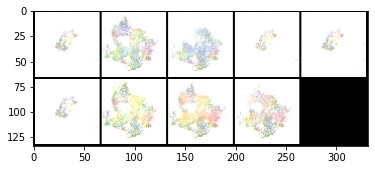

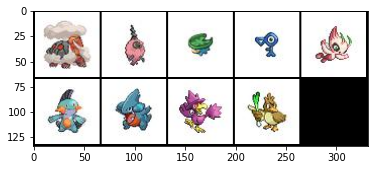

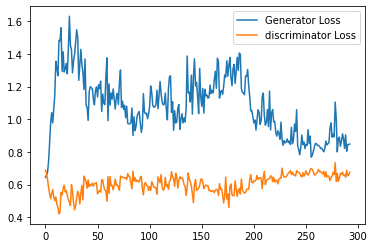

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 6000: Epoch: 19: Generator loss: 0.8293212480545044, discriminator loss: 0.6649535741806031 mean disc pred on real images: 0.5313082933425903, fake images: 0.48087766766548157


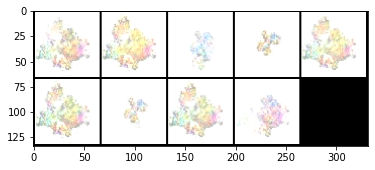

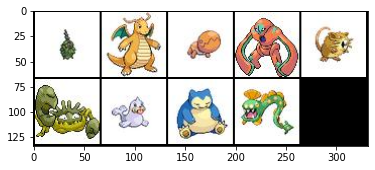

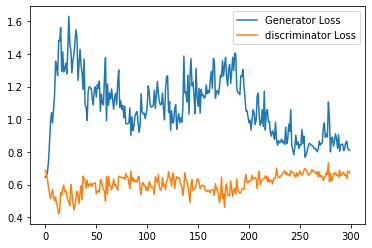

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_6000.pt !


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 6125: Epoch: 19: Generator loss: 0.8403888401985169, discriminator loss: 0.667482415676117 mean disc pred on real images: 0.5278018116950989, fake images: 0.48023951053619385


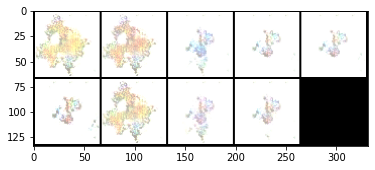

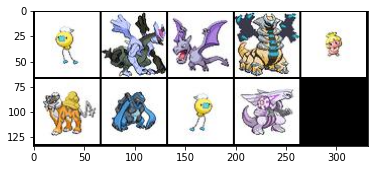

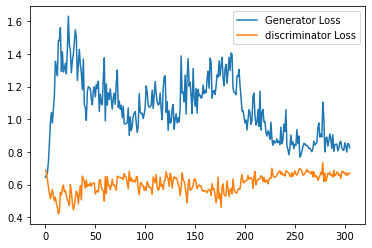

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 6250: Epoch: 20: Generator loss: 0.7660923290252686, discriminator loss: 0.6949821925163269 mean disc pred on real images: 0.5018624067306519, fake images: 0.48921531438827515


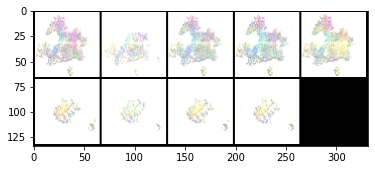

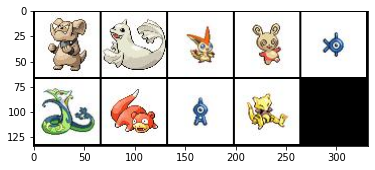

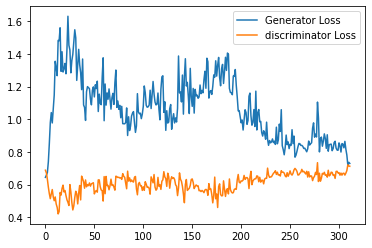

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_6250.pt !


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 6375: Epoch: 20: Generator loss: 0.7781500663757325, discriminator loss: 0.6854582161903381 mean disc pred on real images: 0.5146656632423401, fake images: 0.4901749789714813


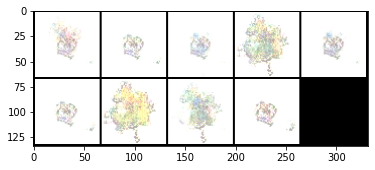

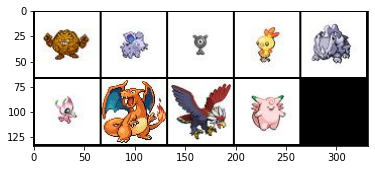

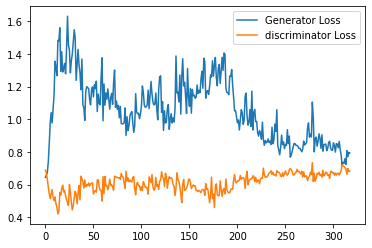

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 6500: Epoch: 21: Generator loss: 0.7892750856876374, discriminator loss: 0.6811364951133728 mean disc pred on real images: 0.5165223479270935, fake images: 0.48512253165245056


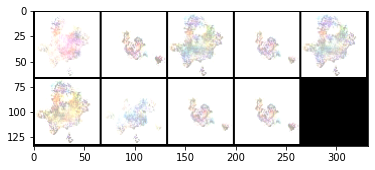

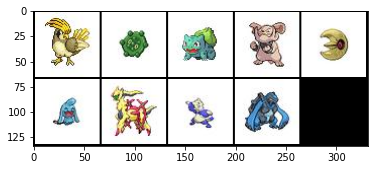

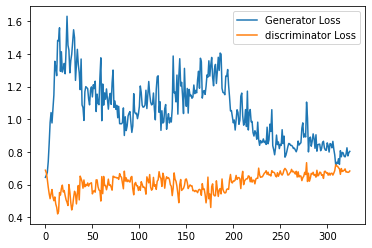

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_6500.pt !


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 6625: Epoch: 21: Generator loss: 0.7915797224044799, discriminator loss: 0.6778402857780457 mean disc pred on real images: 0.5151702761650085, fake images: 0.4844982326030731


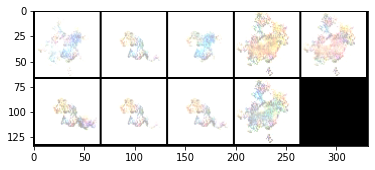

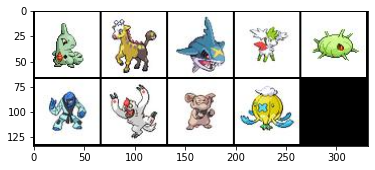

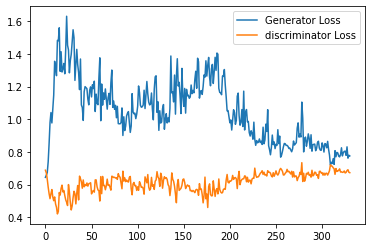

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 6750: Epoch: 21: Generator loss: 0.8266888620853424, discriminator loss: 0.6633605623245239 mean disc pred on real images: 0.5190452933311462, fake images: 0.47089993953704834


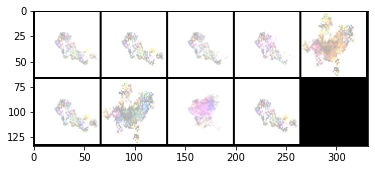

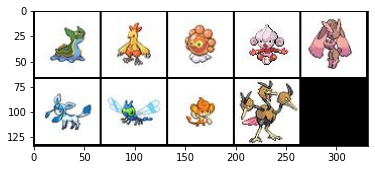

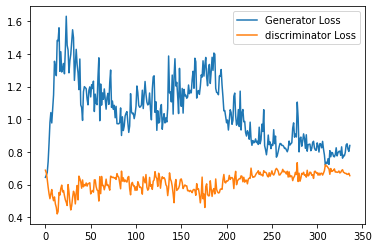

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_6750.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 6875: Epoch: 22: Generator loss: 0.8036247460842133, discriminator loss: 0.6790027141571044 mean disc pred on real images: 0.5097672939300537, fake images: 0.47945350408554077


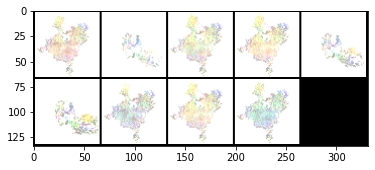

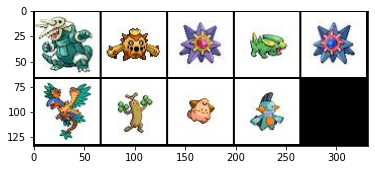

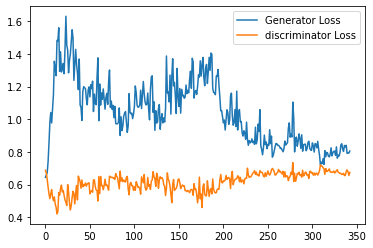

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 7000: Epoch: 22: Generator loss: 0.7741715435981751, discriminator loss: 0.6950163373947144 mean disc pred on real images: 0.49754682183265686, fake images: 0.4897446036338806


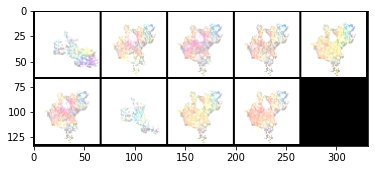

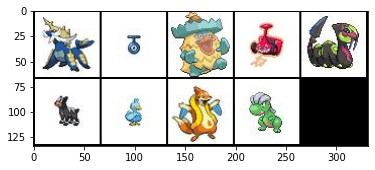

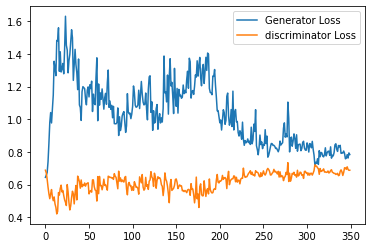

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_7000.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 7125: Epoch: 23: Generator loss: 0.8199886755943299, discriminator loss: 0.6751138315200805 mean disc pred on real images: 0.5186973810195923, fake images: 0.4833153784275055


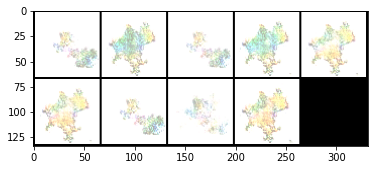

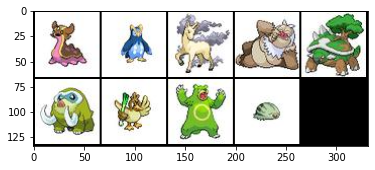

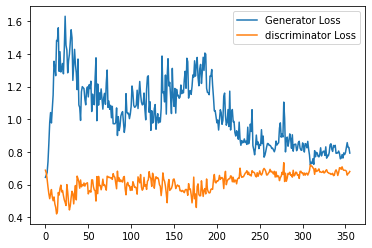

Step 7250: Epoch: 23: Generator loss: 0.7867957394123077, discriminator loss: 0.6870477390289307 mean disc pred on real images: 0.5151398181915283, fake images: 0.4927853047847748


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


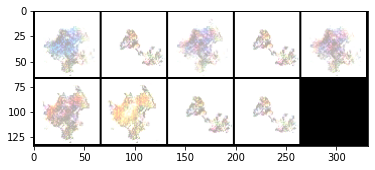

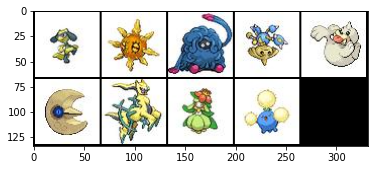

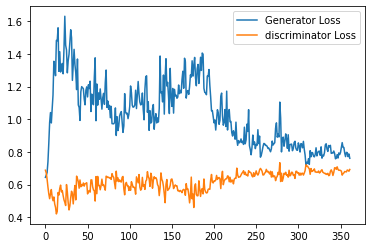

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_7250.pt !


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 7375: Epoch: 23: Generator loss: 0.8011393866539002, discriminator loss: 0.6630073070526123 mean disc pred on real images: 0.5355851054191589, fake images: 0.48431697487831116


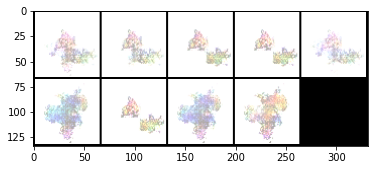

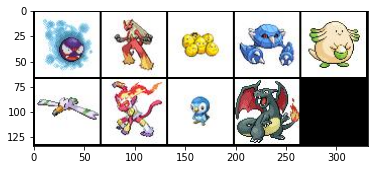

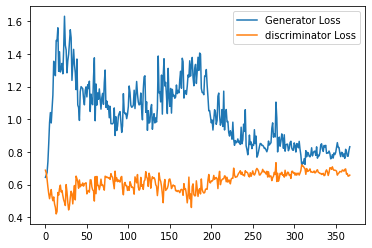

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 7500: Epoch: 24: Generator loss: 0.7843504929542542, discriminator loss: 0.6862940101623535 mean disc pred on real images: 0.5066830515861511, fake images: 0.4866030216217041


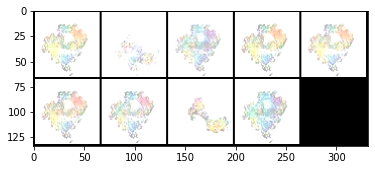

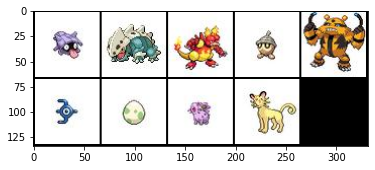

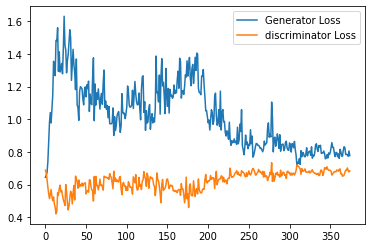

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_7500.pt !


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 7625: Epoch: 24: Generator loss: 0.8060624866485596, discriminator loss: 0.6738715629577636 mean disc pred on real images: 0.5180105566978455, fake images: 0.48403286933898926


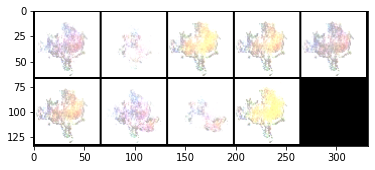

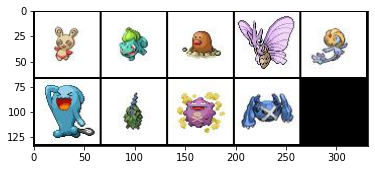

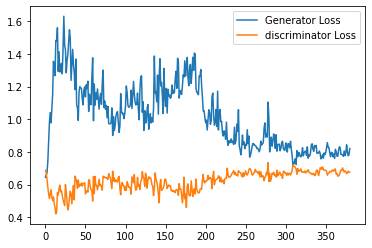

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 7750: Epoch: 25: Generator loss: 0.8628264203071594, discriminator loss: 0.665770688533783 mean disc pred on real images: 0.5246275663375854, fake images: 0.47296401858329773


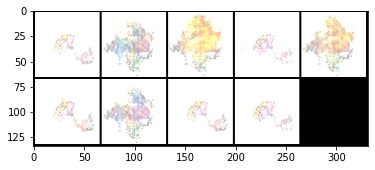

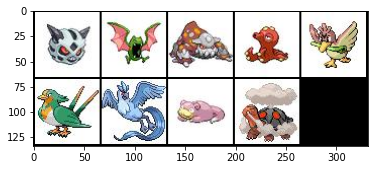

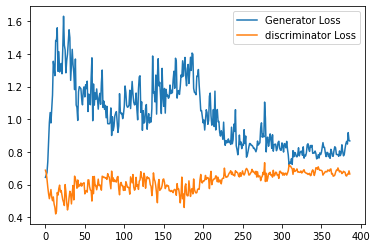

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_7750.pt !


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 7875: Epoch: 25: Generator loss: 0.8150808734893799, discriminator loss: 0.6699517364501953 mean disc pred on real images: 0.5247282385826111, fake images: 0.48149824142456055


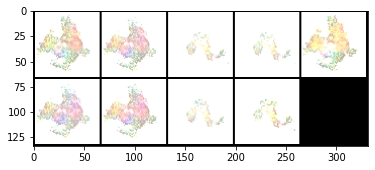

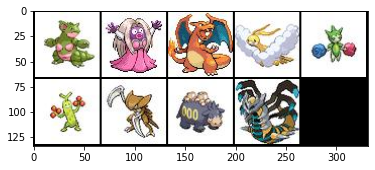

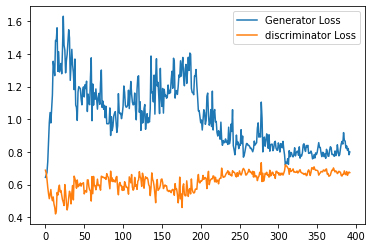

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 8000: Epoch: 25: Generator loss: 0.8226424789428711, discriminator loss: 0.67831977891922 mean disc pred on real images: 0.5151246190071106, fake images: 0.48119449615478516


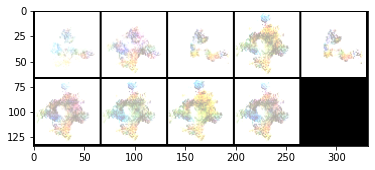

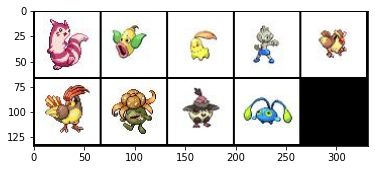

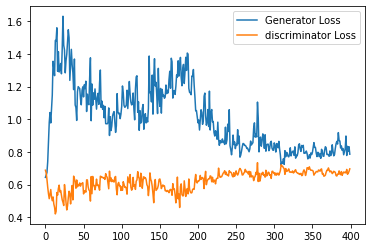

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_8000.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 8125: Epoch: 26: Generator loss: 0.7828707184791565, discriminator loss: 0.6749188108444214 mean disc pred on real images: 0.5214349031448364, fake images: 0.48782822489738464


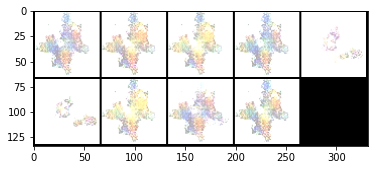

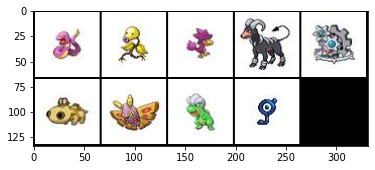

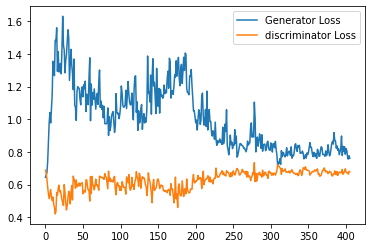

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 8250: Epoch: 26: Generator loss: 0.8150857393741607, discriminator loss: 0.671713071346283 mean disc pred on real images: 0.5271211862564087, fake images: 0.4857316017150879


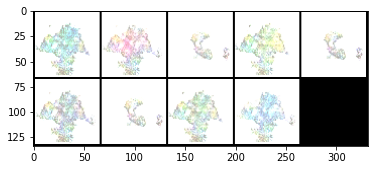

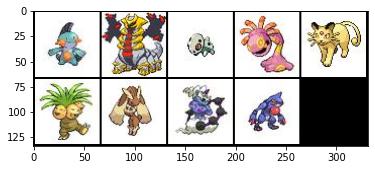

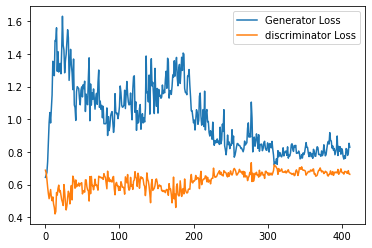

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_8250.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 8375: Epoch: 27: Generator loss: 0.861334358215332, discriminator loss: 0.6644335589408874 mean disc pred on real images: 0.5269748568534851, fake images: 0.4720616936683655


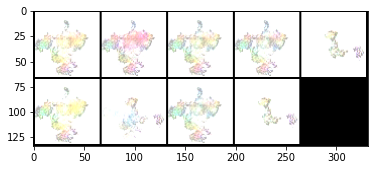

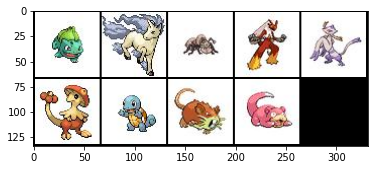

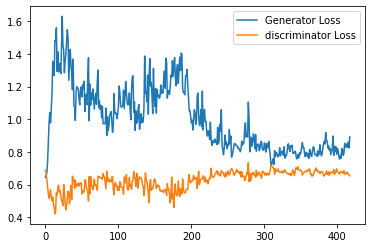

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 8500: Epoch: 27: Generator loss: 0.833406412601471, discriminator loss: 0.6715259013175965 mean disc pred on real images: 0.5205628275871277, fake images: 0.4810098707675934


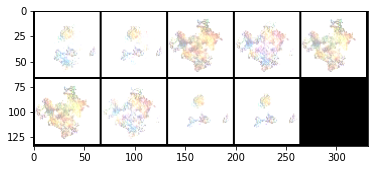

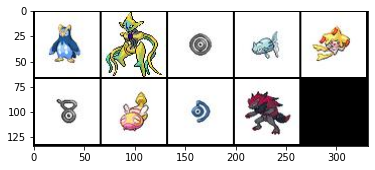

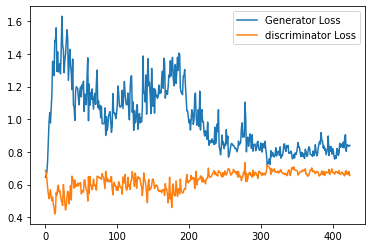

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_8500.pt !


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 8625: Epoch: 27: Generator loss: 0.8281415755748749, discriminator loss: 0.6767888135910034 mean disc pred on real images: 0.5302863121032715, fake images: 0.48556944727897644


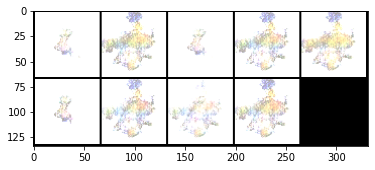

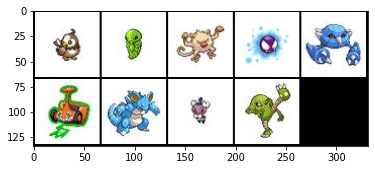

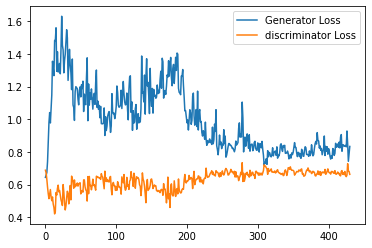

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 8750: Epoch: 28: Generator loss: 0.7806298570632935, discriminator loss: 0.686056487083435 mean disc pred on real images: 0.5151066184043884, fake images: 0.49470990896224976


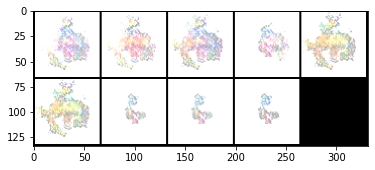

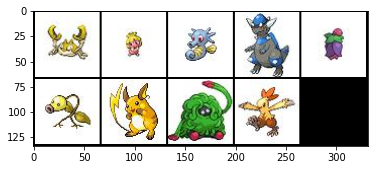

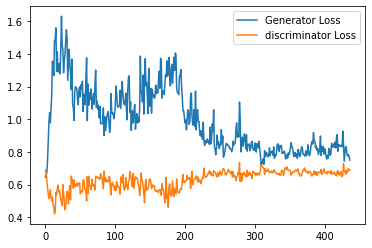

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_8750.pt !


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 8875: Epoch: 28: Generator loss: 0.7917149391174316, discriminator loss: 0.6790306191444397 mean disc pred on real images: 0.5098849534988403, fake images: 0.48343539237976074


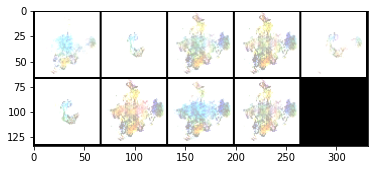

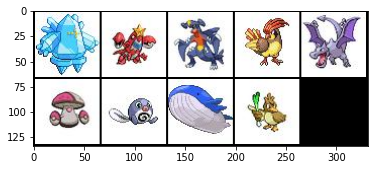

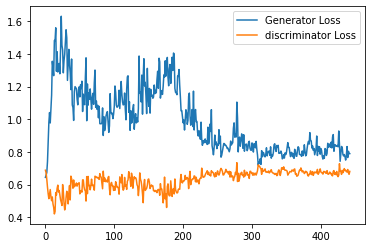

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 9000: Epoch: 29: Generator loss: 0.7654256205558777, discriminator loss: 0.6859873423576355 mean disc pred on real images: 0.5163511633872986, fake images: 0.4945250451564789


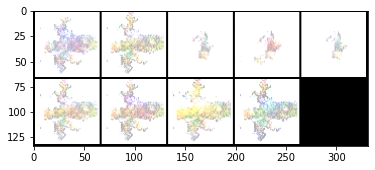

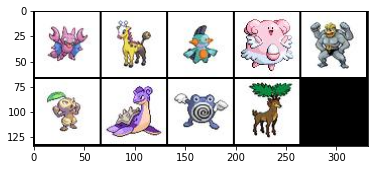

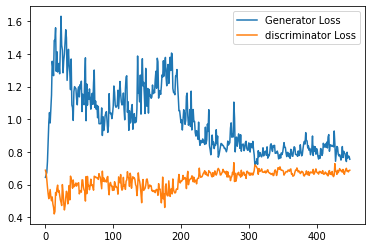

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_9000.pt !


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 9125: Epoch: 29: Generator loss: 0.7691791124343872, discriminator loss: 0.6900059537887573 mean disc pred on real images: 0.5082892775535583, fake images: 0.49331891536712646


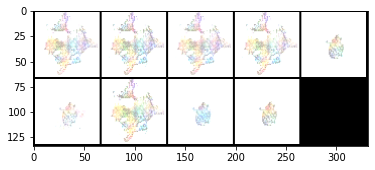

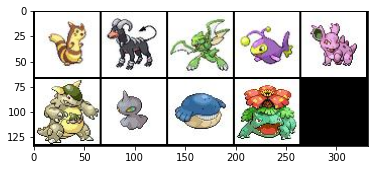

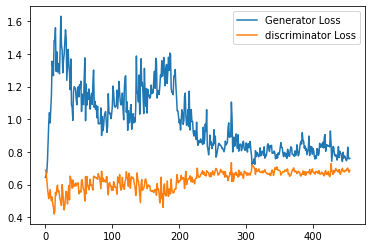

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 9250: Epoch: 29: Generator loss: 0.7813065938949585, discriminator loss: 0.6795597796440125 mean disc pred on real images: 0.5096799731254578, fake images: 0.48653149604797363


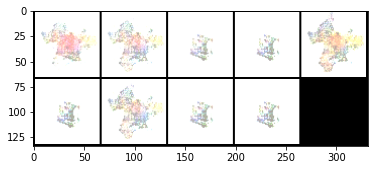

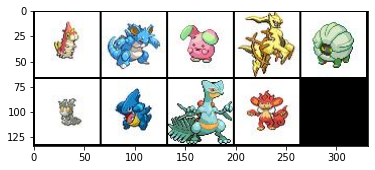

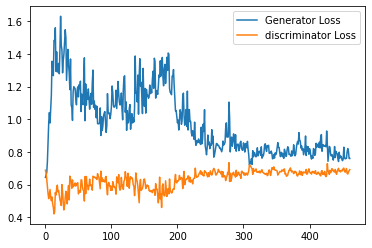

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_9250.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 9375: Epoch: 30: Generator loss: 0.7866029276847839, discriminator loss: 0.6731666688919067 mean disc pred on real images: 0.5124624371528625, fake images: 0.4802282750606537


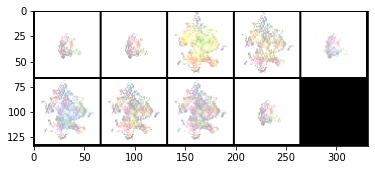

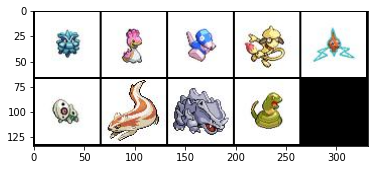

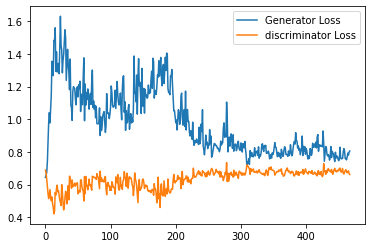

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 9500: Epoch: 30: Generator loss: 0.7778995127677918, discriminator loss: 0.6778574891090393 mean disc pred on real images: 0.5154391527175903, fake images: 0.4879738688468933


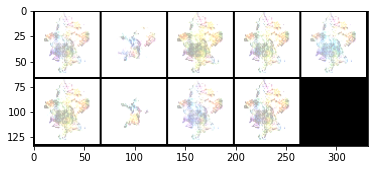

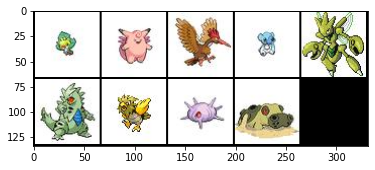

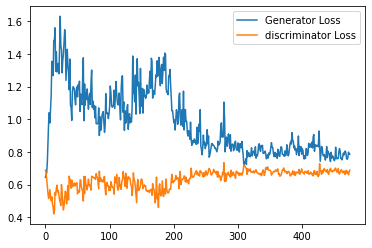

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_9500.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 9625: Epoch: 31: Generator loss: 0.7838748259544372, discriminator loss: 0.6781451683044434 mean disc pred on real images: 0.5136134624481201, fake images: 0.48370906710624695


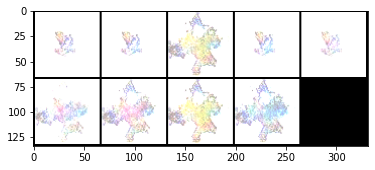

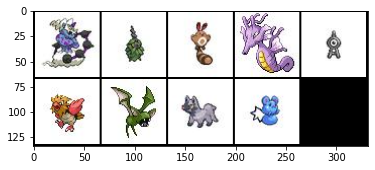

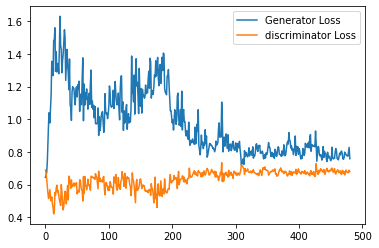

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 9750: Epoch: 31: Generator loss: 0.7813114528656006, discriminator loss: 0.6889210643768311 mean disc pred on real images: 0.509076714515686, fake images: 0.49424871802330017


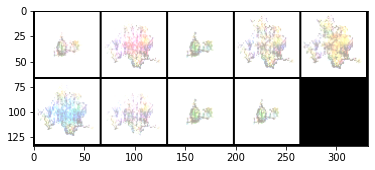

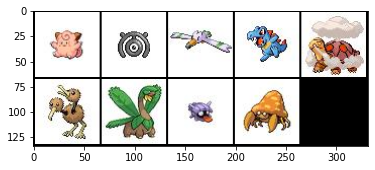

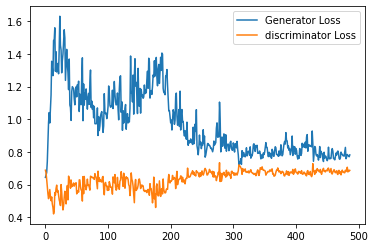

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_9750.pt !


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 9875: Epoch: 31: Generator loss: 0.7712247629165649, discriminator loss: 0.6882508640289307 mean disc pred on real images: 0.511506974697113, fake images: 0.49606531858444214


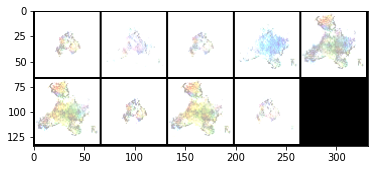

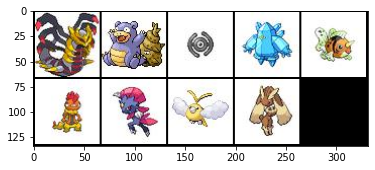

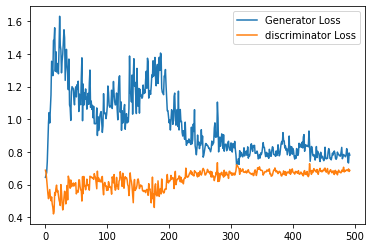

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 10000: Epoch: 32: Generator loss: 0.7742375068664551, discriminator loss: 0.6840405535697937 mean disc pred on real images: 0.511023759841919, fake images: 0.49097293615341187


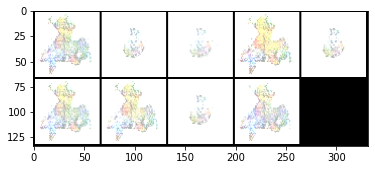

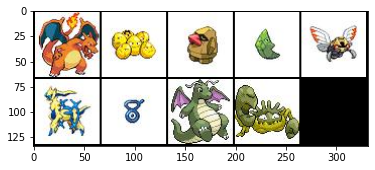

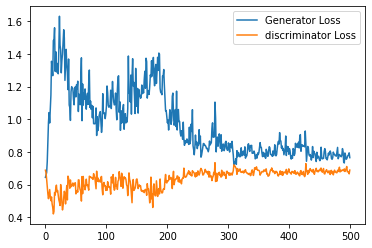

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_10000.pt !


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 10125: Epoch: 32: Generator loss: 0.7883507776260376, discriminator loss: 0.682535168170929 mean disc pred on real images: 0.5071641802787781, fake images: 0.48553401231765747


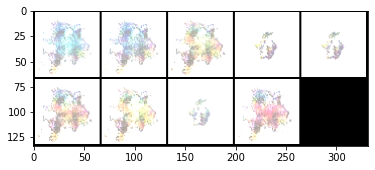

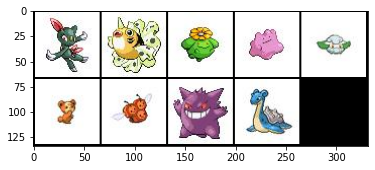

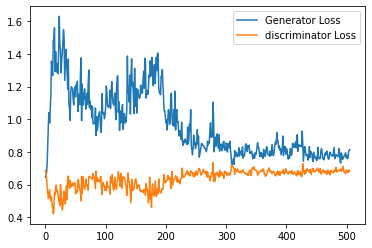

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 10250: Epoch: 33: Generator loss: 0.8076758704185486, discriminator loss: 0.6777435207366943 mean disc pred on real images: 0.5144622325897217, fake images: 0.48479777574539185


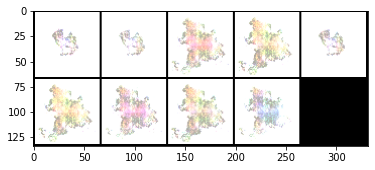

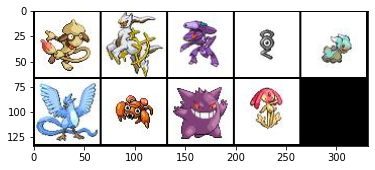

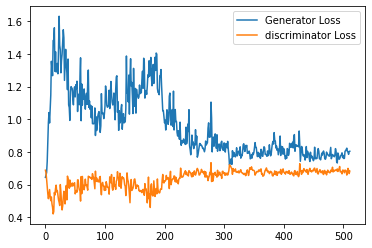

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_10250.pt !


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 10375: Epoch: 33: Generator loss: 0.8026293406486511, discriminator loss: 0.6765657162666321 mean disc pred on real images: 0.5161790251731873, fake images: 0.48425590991973877


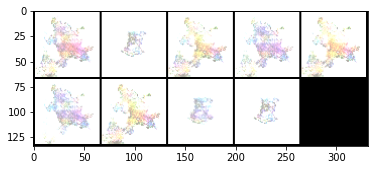

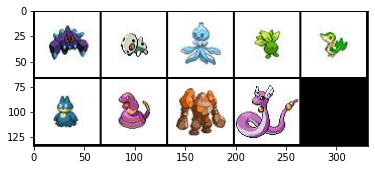

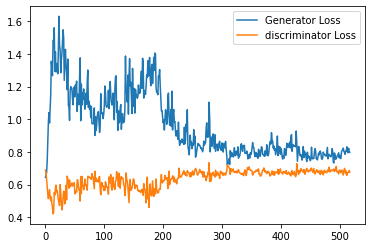

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 10500: Epoch: 33: Generator loss: 0.802888751745224, discriminator loss: 0.6758163928985595 mean disc pred on real images: 0.5224061608314514, fake images: 0.4883544445037842


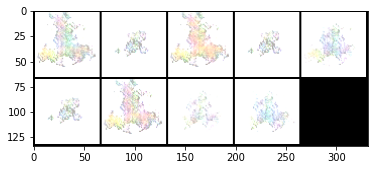

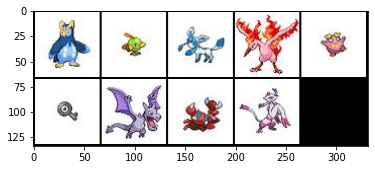

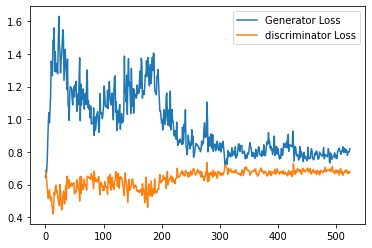

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_10500.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 10625: Epoch: 34: Generator loss: 0.8474926609992981, discriminator loss: 0.6641385650634766 mean disc pred on real images: 0.5276119709014893, fake images: 0.47858890891075134


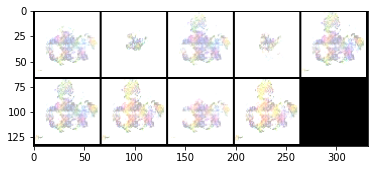

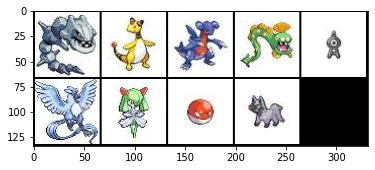

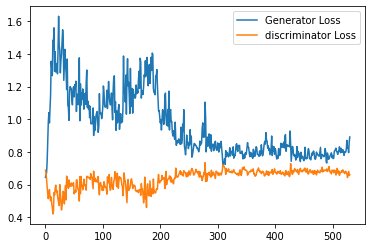

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 10750: Epoch: 34: Generator loss: 0.835457540512085, discriminator loss: 0.682669249534607 mean disc pred on real images: 0.5157814621925354, fake images: 0.4854886829853058


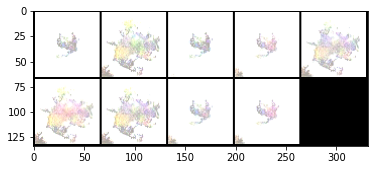

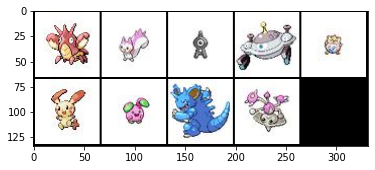

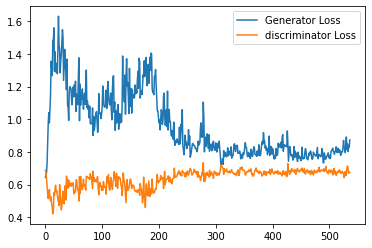

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_10750.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 10875: Epoch: 35: Generator loss: 0.8530176067352295, discriminator loss: 0.6616436676979065 mean disc pred on real images: 0.5340753197669983, fake images: 0.4776966869831085


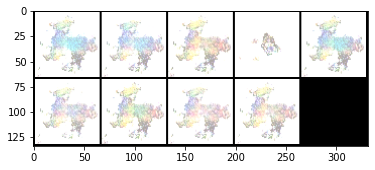

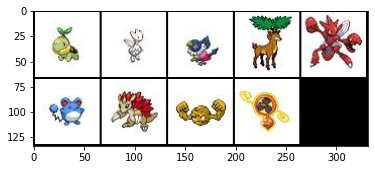

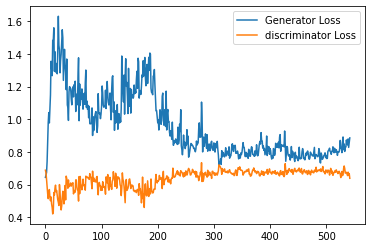

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 11000: Epoch: 35: Generator loss: 0.8513397450447082, discriminator loss: 0.6887019844055176 mean disc pred on real images: 0.5230893492698669, fake images: 0.48188120126724243


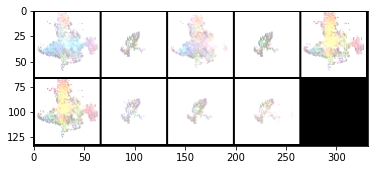

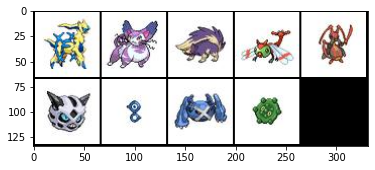

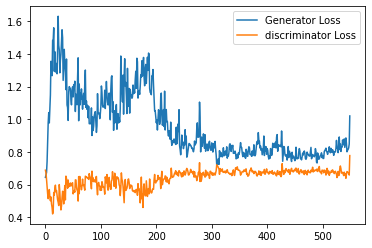

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_11000.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 11125: Epoch: 36: Generator loss: 0.7722326183319091, discriminator loss: 0.6834310712814331 mean disc pred on real images: 0.5087609887123108, fake images: 0.48865601420402527


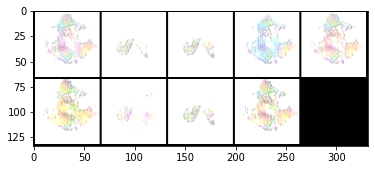

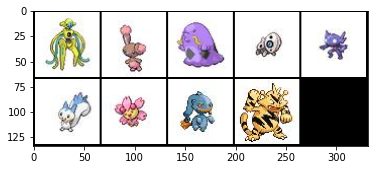

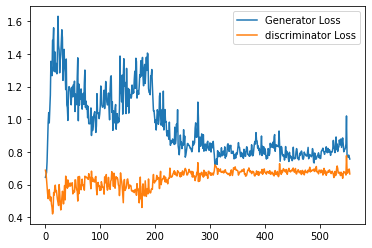

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 11250: Epoch: 36: Generator loss: 0.7911565341949462, discriminator loss: 0.6728862218856811 mean disc pred on real images: 0.5200638175010681, fake images: 0.48523691296577454


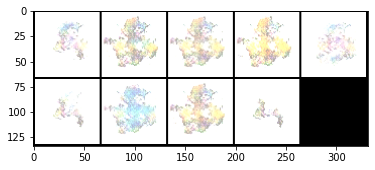

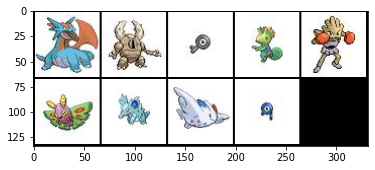

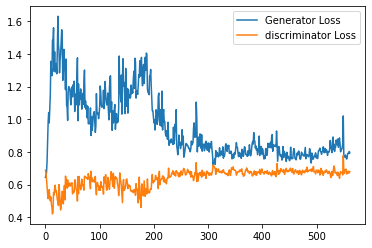

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_11250.pt !


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 11375: Epoch: 36: Generator loss: 0.8477487907409668, discriminator loss: 0.6546716237068176 mean disc pred on real images: 0.5325220227241516, fake images: 0.4712216556072235


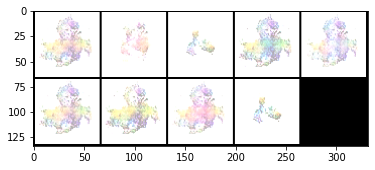

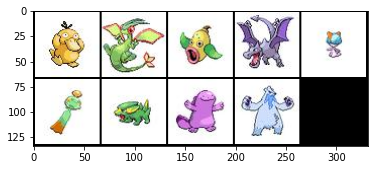

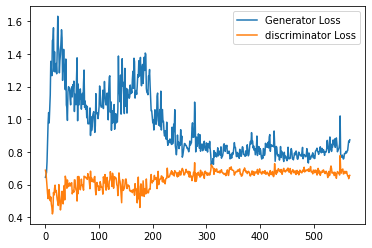

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 11500: Epoch: 37: Generator loss: 0.8259889316558838, discriminator loss: 0.6668011865615845 mean disc pred on real images: 0.5257561206817627, fake images: 0.47974973917007446


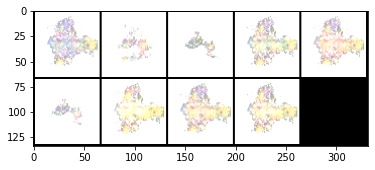

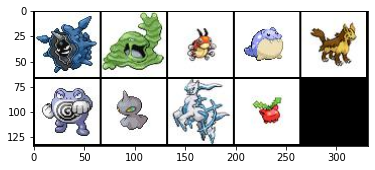

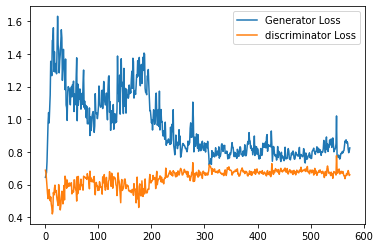

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_11500.pt !


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 11625: Epoch: 37: Generator loss: 0.8581597032546997, discriminator loss: 0.6592209329605102 mean disc pred on real images: 0.523284912109375, fake images: 0.4671175181865692


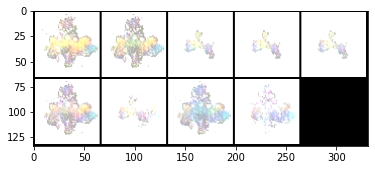

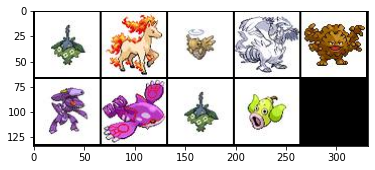

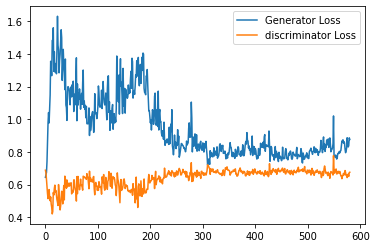

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 11750: Epoch: 38: Generator loss: 0.84688450050354, discriminator loss: 0.651399435043335 mean disc pred on real images: 0.5348960757255554, fake images: 0.47130057215690613


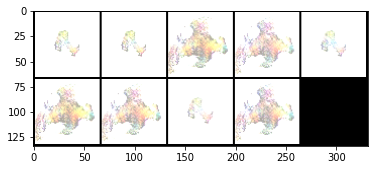

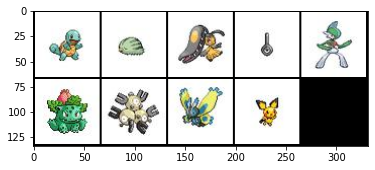

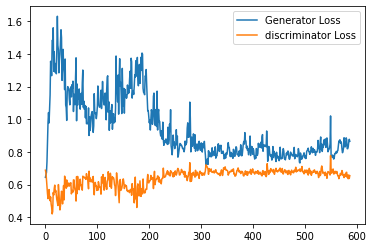

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_11750.pt !


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 11875: Epoch: 38: Generator loss: 0.8639628238677979, discriminator loss: 0.6697641935348511 mean disc pred on real images: 0.5204759836196899, fake images: 0.47563669085502625


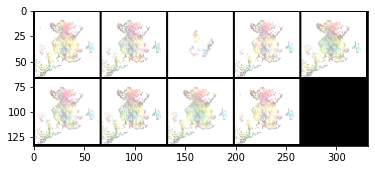

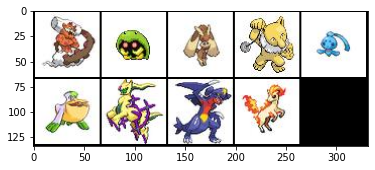

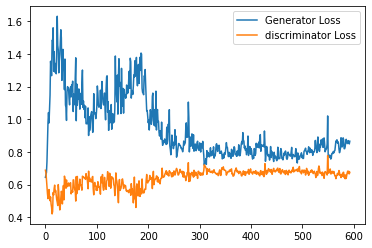

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 12000: Epoch: 38: Generator loss: 0.8554666891098023, discriminator loss: 0.688262315273285 mean disc pred on real images: 0.510906457901001, fake images: 0.4837437868118286


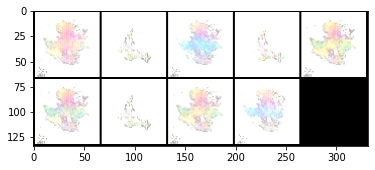

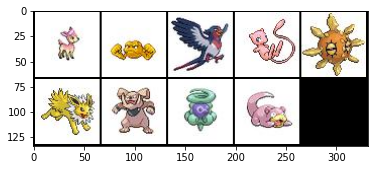

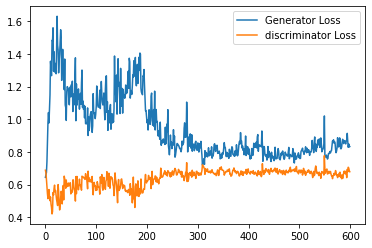

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_12000.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 12125: Epoch: 39: Generator loss: 0.8210488388538361, discriminator loss: 0.6873335304260254 mean disc pred on real images: 0.5158541202545166, fake images: 0.4841434359550476


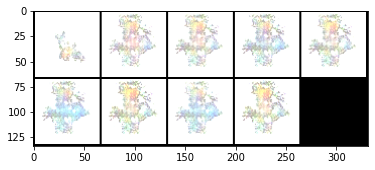

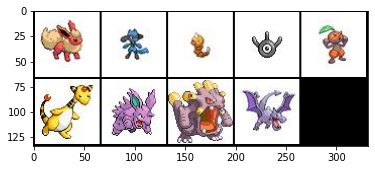

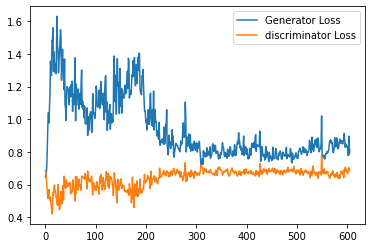

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 12250: Epoch: 39: Generator loss: 0.8419030110836029, discriminator loss: 0.6623023419380188 mean disc pred on real images: 0.5263177156448364, fake images: 0.47486111521720886


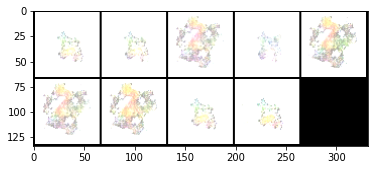

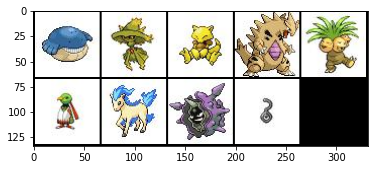

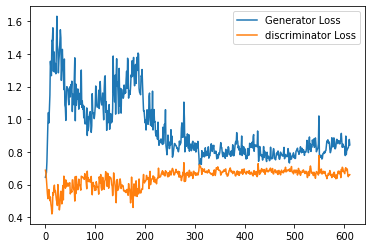

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_12250.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 12375: Epoch: 40: Generator loss: 0.851132301568985, discriminator loss: 0.6645456113815308 mean disc pred on real images: 0.527890682220459, fake images: 0.47482791543006897


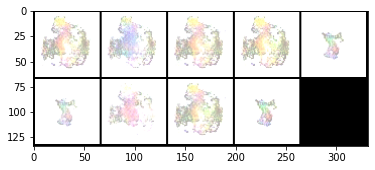

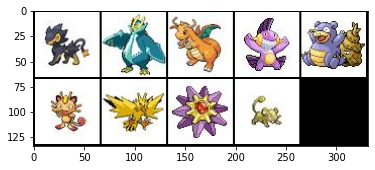

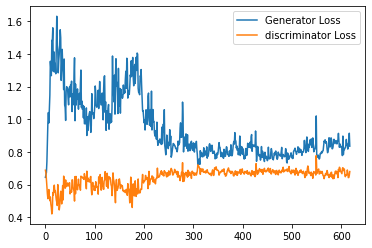

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 12500: Epoch: 40: Generator loss: 0.8801839284896851, discriminator loss: 0.6541967592239379 mean disc pred on real images: 0.5394476652145386, fake images: 0.47151753306388855


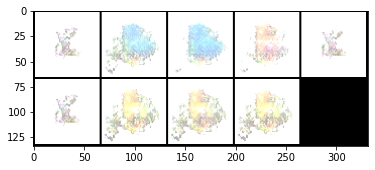

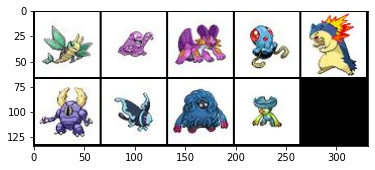

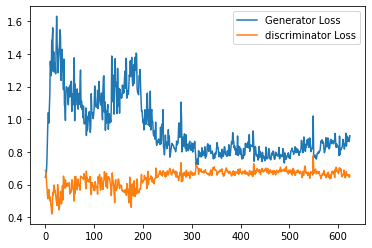

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_12500.pt !


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 12625: Epoch: 40: Generator loss: 0.8627884674072266, discriminator loss: 0.6921674036979675 mean disc pred on real images: 0.5064634084701538, fake images: 0.47990408539772034


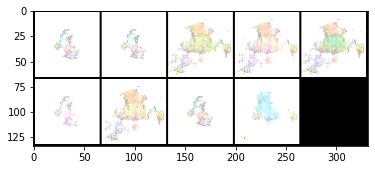

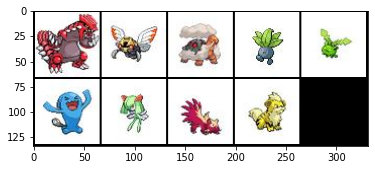

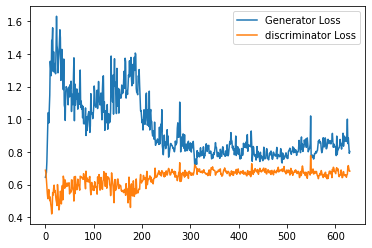

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 12750: Epoch: 41: Generator loss: 0.8278680958747864, discriminator loss: 0.6743999562263489 mean disc pred on real images: 0.5132026076316833, fake images: 0.47684839367866516


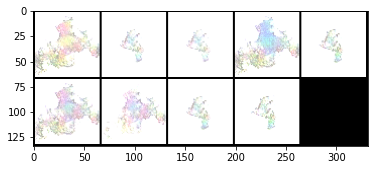

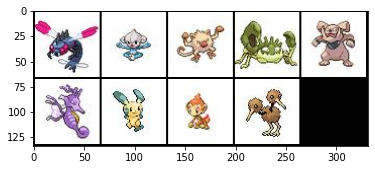

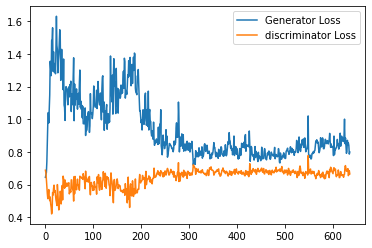

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_12750.pt !


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 12875: Epoch: 41: Generator loss: 0.8694874320030213, discriminator loss: 0.655560344696045 mean disc pred on real images: 0.5273600816726685, fake images: 0.4639946222305298


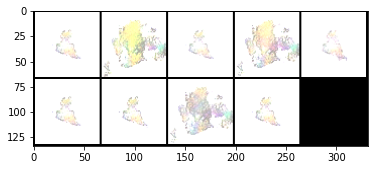

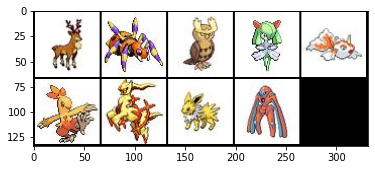

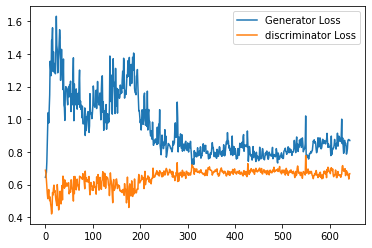

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 13000: Epoch: 42: Generator loss: 0.8427603144645691, discriminator loss: 0.6588110446929931 mean disc pred on real images: 0.52944415807724, fake images: 0.46993282437324524


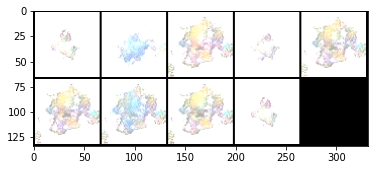

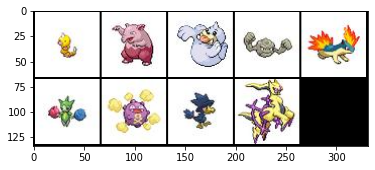

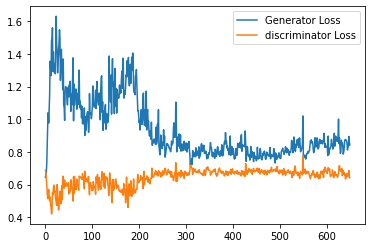

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_13000.pt !


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 13125: Epoch: 42: Generator loss: 0.837766972064972, discriminator loss: 0.6755424480438232 mean disc pred on real images: 0.5243653059005737, fake images: 0.4836882948875427


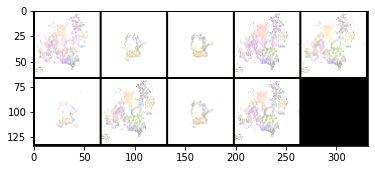

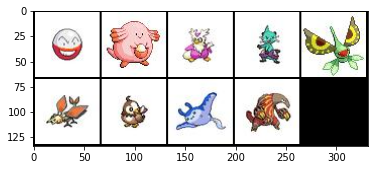

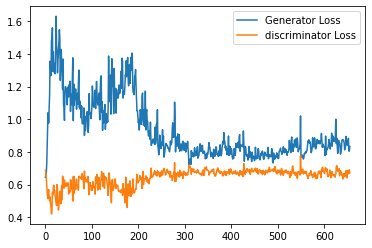

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 13250: Epoch: 42: Generator loss: 0.8789325308799744, discriminator loss: 0.6563715014457703 mean disc pred on real images: 0.5285893678665161, fake images: 0.4675000309944153


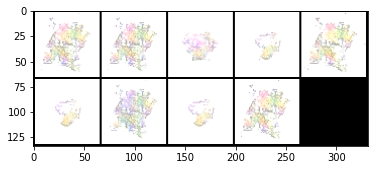

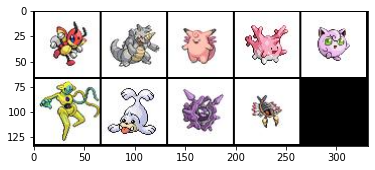

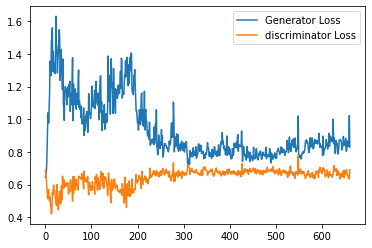

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_13250.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 13375: Epoch: 43: Generator loss: 0.845952018737793, discriminator loss: 0.6741320471763611 mean disc pred on real images: 0.5238927602767944, fake images: 0.48100486397743225


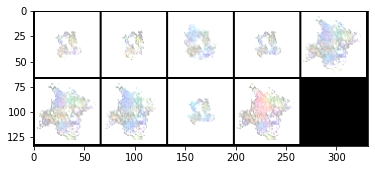

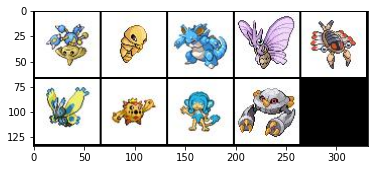

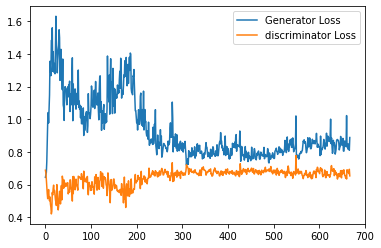

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 13500: Epoch: 43: Generator loss: 0.8846134703159332, discriminator loss: 0.6580457873344422 mean disc pred on real images: 0.5336069464683533, fake images: 0.4684147536754608


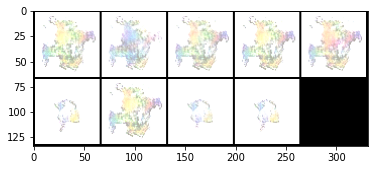

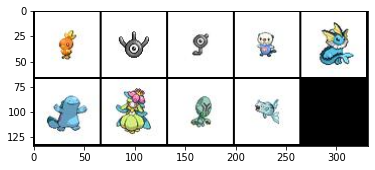

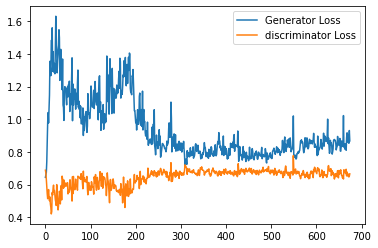

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_13500.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 13625: Epoch: 44: Generator loss: 0.8770392677783966, discriminator loss: 0.6620763273239135 mean disc pred on real images: 0.5260307192802429, fake images: 0.47001245617866516


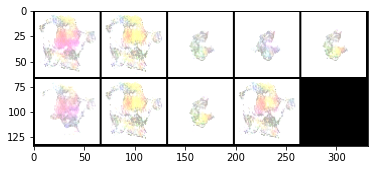

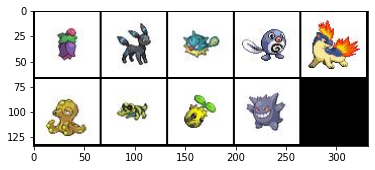

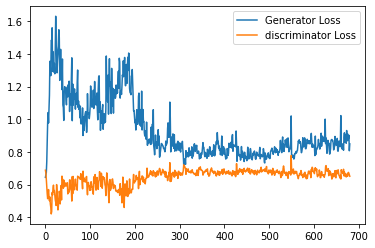

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 13750: Epoch: 44: Generator loss: 0.8161649260520935, discriminator loss: 0.6913228888511658 mean disc pred on real images: 0.5096974968910217, fake images: 0.489370733499527


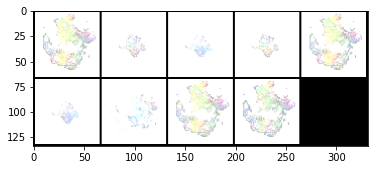

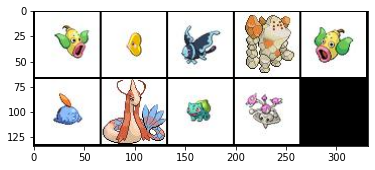

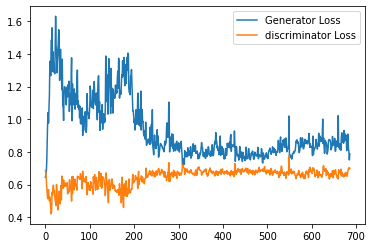

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_13750.pt !


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 13875: Epoch: 44: Generator loss: 0.8087616856098175, discriminator loss: 0.6724629392623901 mean disc pred on real images: 0.5189921855926514, fake images: 0.4795931279659271


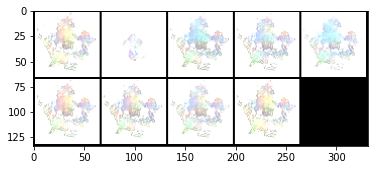

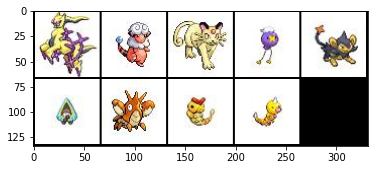

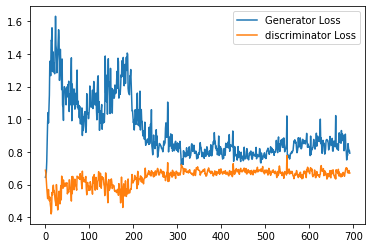

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 14000: Epoch: 45: Generator loss: 0.7950691270828247, discriminator loss: 0.6746264863014221 mean disc pred on real images: 0.5174121856689453, fake images: 0.48301205039024353


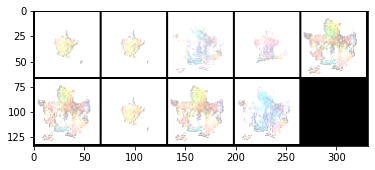

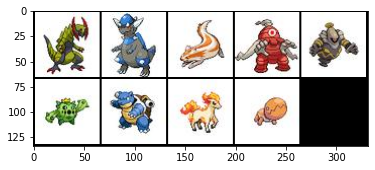

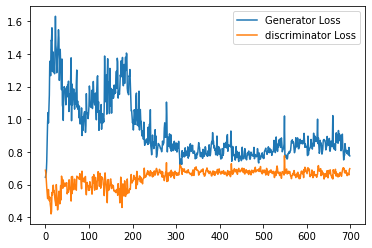

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_14000.pt !


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 14125: Epoch: 45: Generator loss: 0.8178420104980468, discriminator loss: 0.6750569767951965 mean disc pred on real images: 0.5191701054573059, fake images: 0.48057737946510315


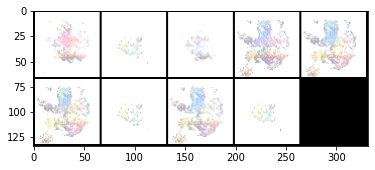

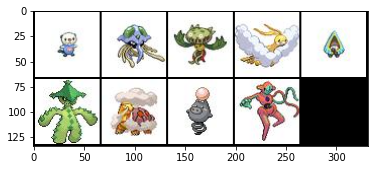

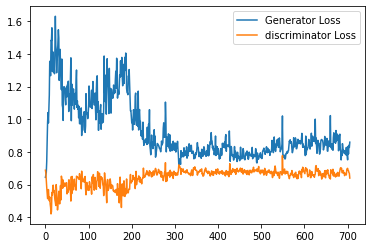

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 14250: Epoch: 46: Generator loss: 0.848847629070282, discriminator loss: 0.6642390189170837 mean disc pred on real images: 0.5231773853302002, fake images: 0.4693419933319092


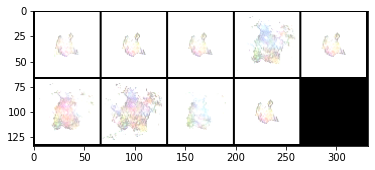

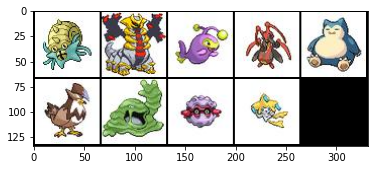

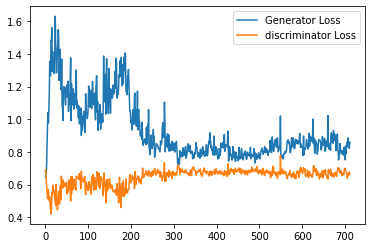

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_14250.pt !


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 14375: Epoch: 46: Generator loss: 0.8737619981765747, discriminator loss: 0.6580461893081665 mean disc pred on real images: 0.5363408327102661, fake images: 0.47078433632850647


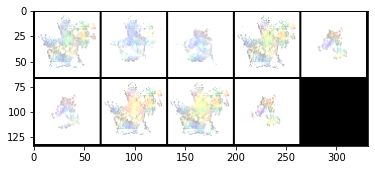

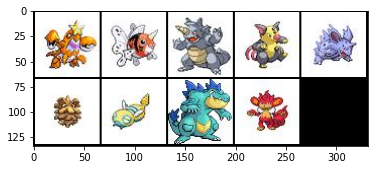

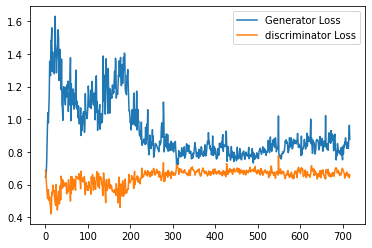

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 14500: Epoch: 46: Generator loss: 0.8336556344032288, discriminator loss: 0.6661488952636718 mean disc pred on real images: 0.5245931148529053, fake images: 0.4740975499153137


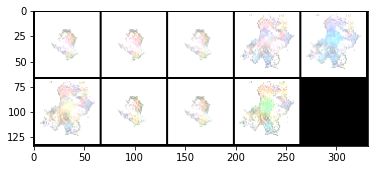

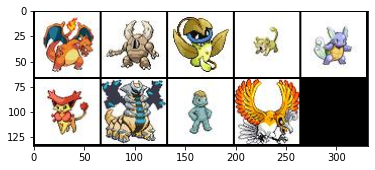

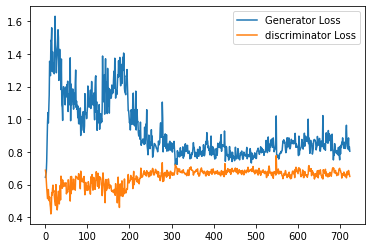

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_14500.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 14625: Epoch: 47: Generator loss: 0.8269388344287872, discriminator loss: 0.6679854855537415 mean disc pred on real images: 0.5229792594909668, fake images: 0.47557470202445984


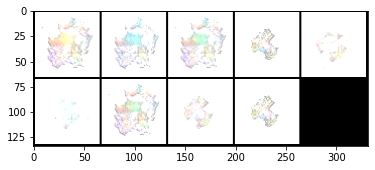

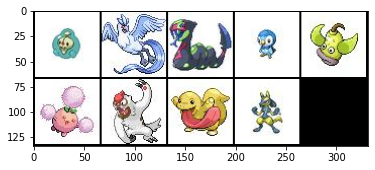

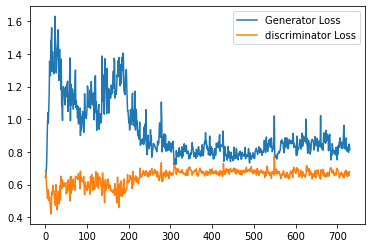

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 14750: Epoch: 47: Generator loss: 0.8426427450180054, discriminator loss: 0.6697057414054871 mean disc pred on real images: 0.5206257104873657, fake images: 0.47458675503730774


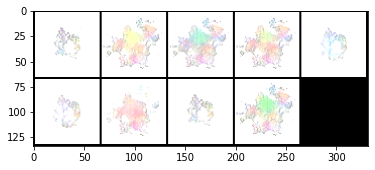

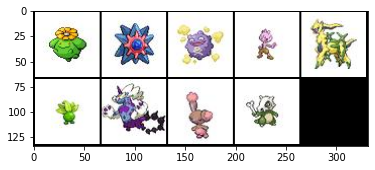

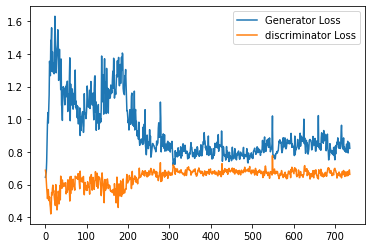

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_14750.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 14875: Epoch: 48: Generator loss: 0.8414856524467468, discriminator loss: 0.6653240914344788 mean disc pred on real images: 0.5268415212631226, fake images: 0.47514063119888306


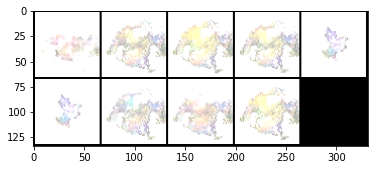

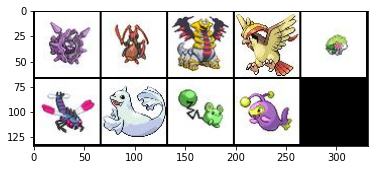

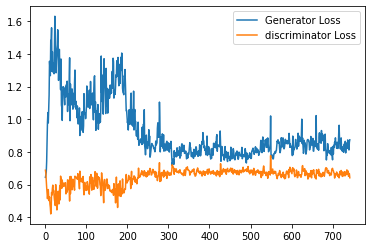

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 15000: Epoch: 48: Generator loss: 0.8854323275089264, discriminator loss: 0.665982789516449 mean disc pred on real images: 0.5245929956436157, fake images: 0.4679298400878906


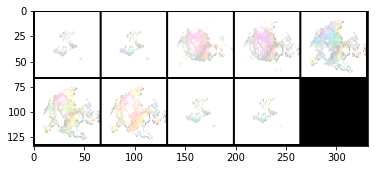

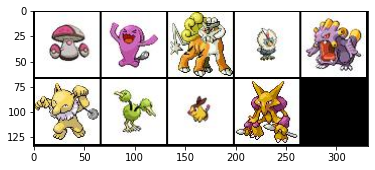

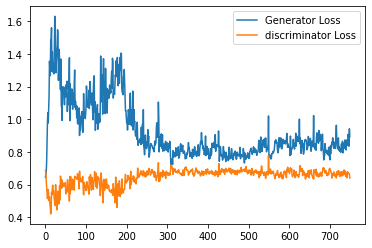

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_15000.pt !


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 15125: Epoch: 48: Generator loss: 0.8547987937927246, discriminator loss: 0.671841164112091 mean disc pred on real images: 0.5178564190864563, fake images: 0.47091251611709595


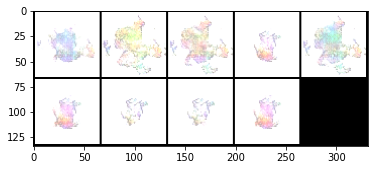

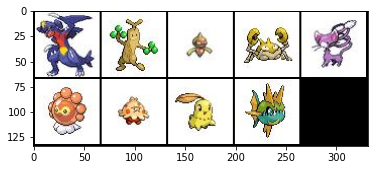

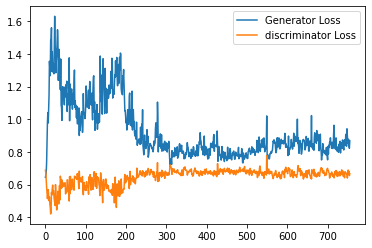

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 15250: Epoch: 49: Generator loss: 0.8464923160076141, discriminator loss: 0.6658903698921204 mean disc pred on real images: 0.5275792479515076, fake images: 0.472713828086853


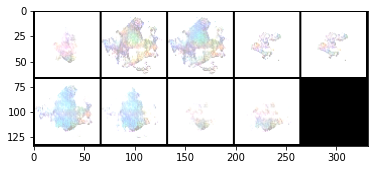

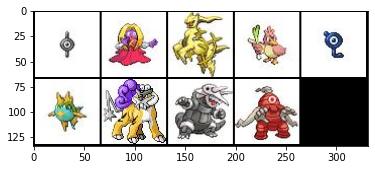

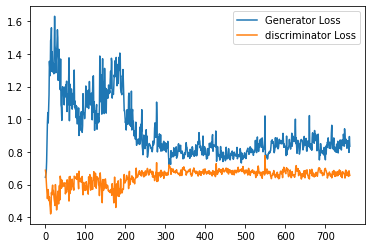

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_15250.pt !


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 15375: Epoch: 49: Generator loss: 0.8890340213775635, discriminator loss: 0.6445277328491211 mean disc pred on real images: 0.5359527468681335, fake images: 0.4569718539714813


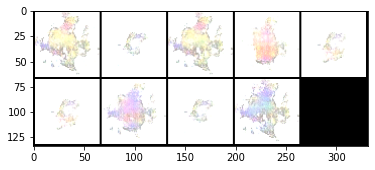

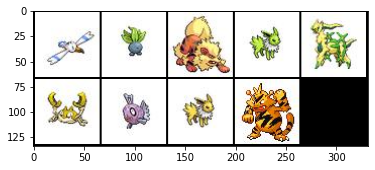

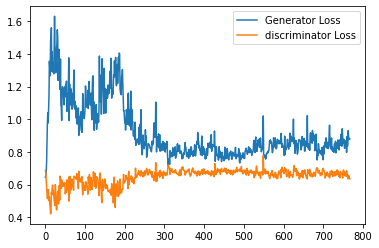

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 15500: Epoch: 50: Generator loss: 0.8715100238323211, discriminator loss: 0.6606096472740174 mean disc pred on real images: 0.5312778949737549, fake images: 0.46988973021507263


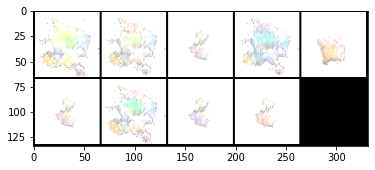

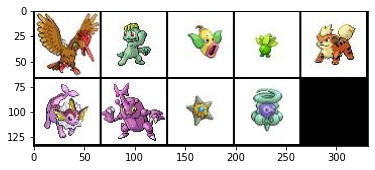

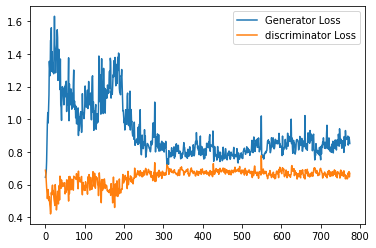

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_15500.pt !


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 15625: Epoch: 50: Generator loss: 0.8816997940540314, discriminator loss: 0.6611677694320679 mean disc pred on real images: 0.5335715413093567, fake images: 0.46741431951522827


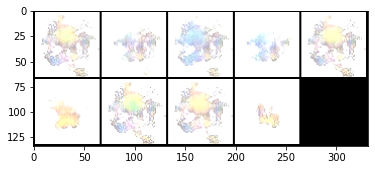

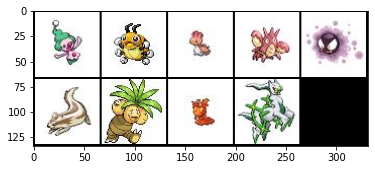

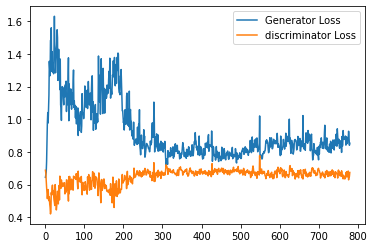

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 15750: Epoch: 50: Generator loss: 0.9026843543052674, discriminator loss: 0.6474908595085144 mean disc pred on real images: 0.5375072360038757, fake images: 0.4612296521663666


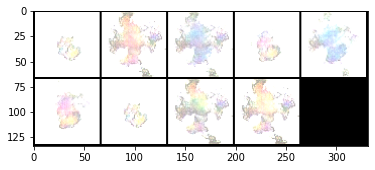

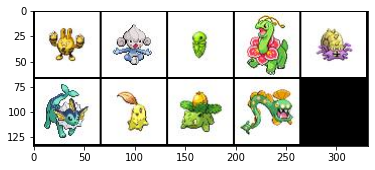

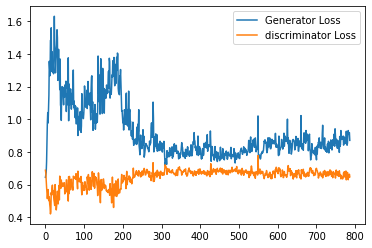

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_15750.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 15875: Epoch: 51: Generator loss: 0.8952987961769104, discriminator loss: 0.6539139671325683 mean disc pred on real images: 0.5396009683609009, fake images: 0.46506983041763306


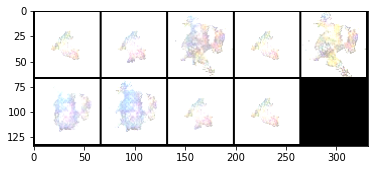

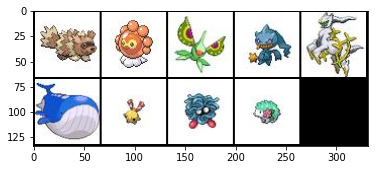

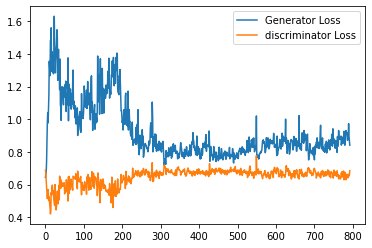

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 16000: Epoch: 51: Generator loss: 0.8943530797958374, discriminator loss: 0.6488296480178833 mean disc pred on real images: 0.5438769459724426, fake images: 0.46321073174476624


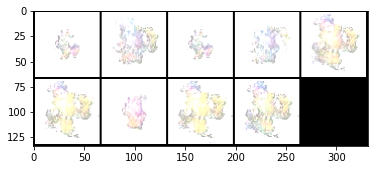

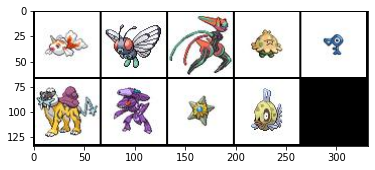

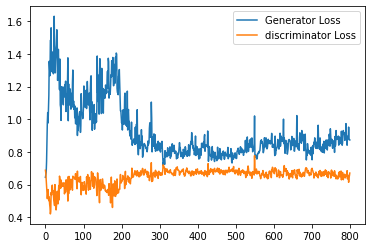

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_16000.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 16125: Epoch: 52: Generator loss: 0.8731374173164368, discriminator loss: 0.6710036973953247 mean disc pred on real images: 0.5259658694267273, fake images: 0.4734894335269928


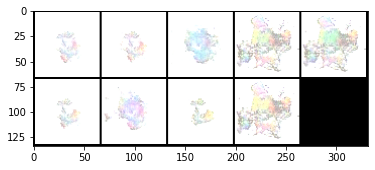

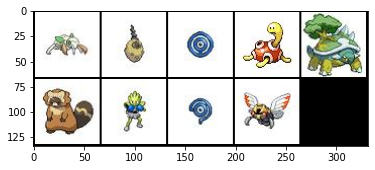

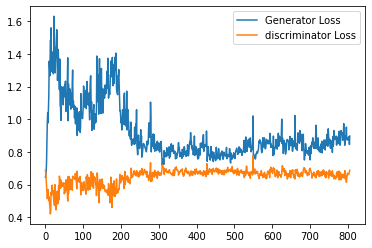

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 16250: Epoch: 52: Generator loss: 0.8947502279281616, discriminator loss: 0.6554450097084046 mean disc pred on real images: 0.5317041873931885, fake images: 0.4649328589439392


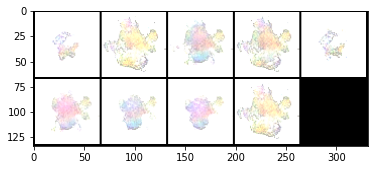

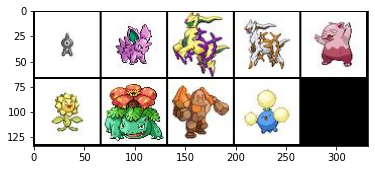

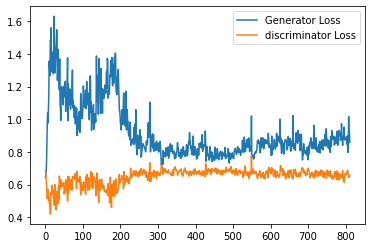

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_16250.pt !


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 16375: Epoch: 52: Generator loss: 0.888681426525116, discriminator loss: 0.6449083275794983 mean disc pred on real images: 0.5452464818954468, fake images: 0.4609677195549011


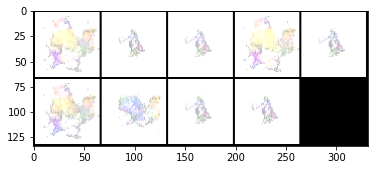

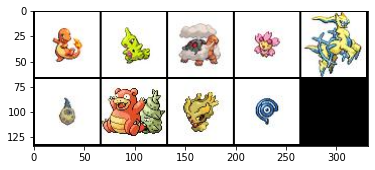

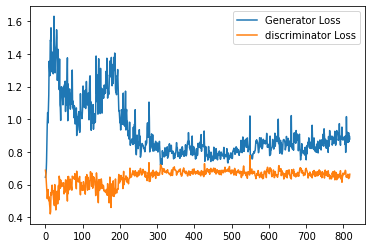

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 16500: Epoch: 53: Generator loss: 0.881498679637909, discriminator loss: 0.6568629069328308 mean disc pred on real images: 0.5323532223701477, fake images: 0.4605545699596405


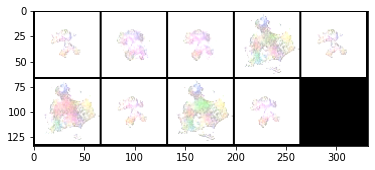

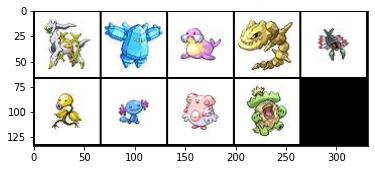

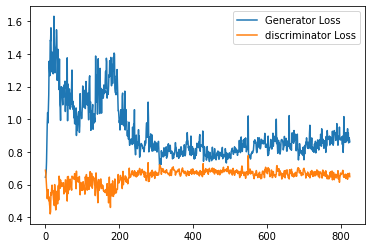

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_16500.pt !


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 16625: Epoch: 53: Generator loss: 0.8693990378379822, discriminator loss: 0.6619579210281372 mean disc pred on real images: 0.5325076580047607, fake images: 0.46701157093048096


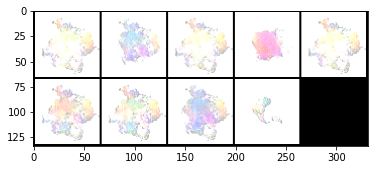

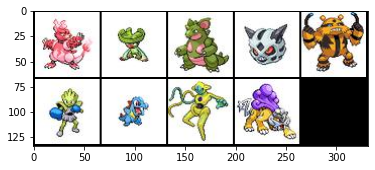

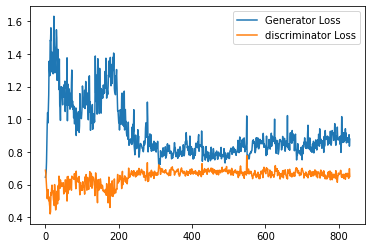

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 16750: Epoch: 54: Generator loss: 0.8788176364898682, discriminator loss: 0.6479789562225342 mean disc pred on real images: 0.5347338914871216, fake images: 0.45997560024261475


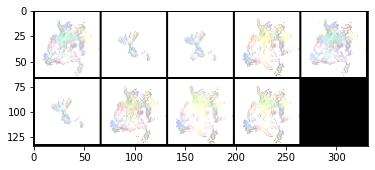

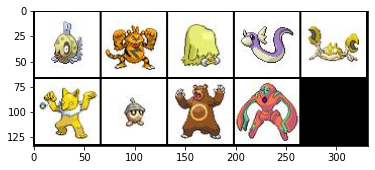

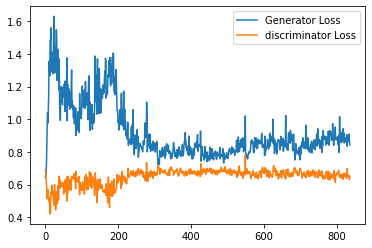

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_16750.pt !


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 16875: Epoch: 54: Generator loss: 0.8696590709686279, discriminator loss: 0.6484999070167542 mean disc pred on real images: 0.5343118906021118, fake images: 0.4617883563041687


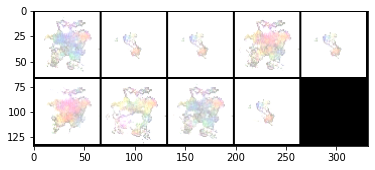

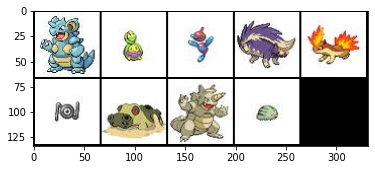

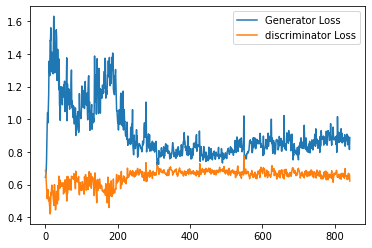

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 17000: Epoch: 55: Generator loss: 0.8898107478618622, discriminator loss: 0.6619605803489685 mean disc pred on real images: 0.5361781120300293, fake images: 0.46778231859207153


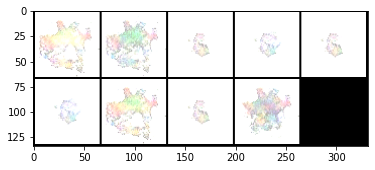

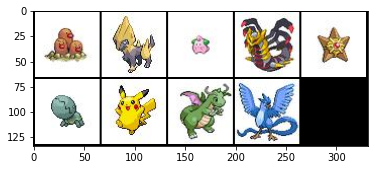

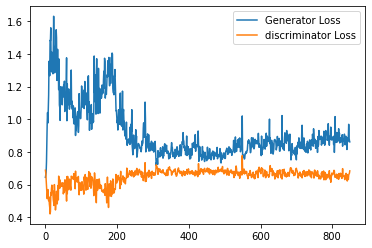

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_17000.pt !


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 17125: Epoch: 55: Generator loss: 0.849328145980835, discriminator loss: 0.6722697911262512 mean disc pred on real images: 0.5263842344284058, fake images: 0.473548024892807


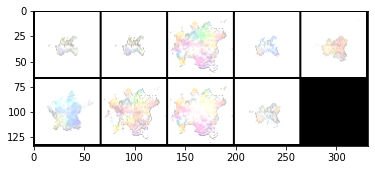

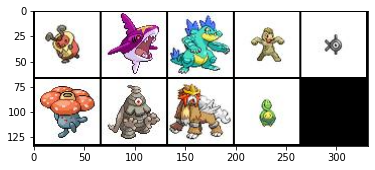

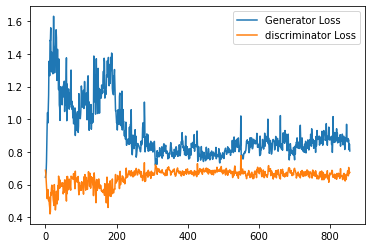

Step 17250: Epoch: 55: Generator loss: 0.8664295129776001, discriminator loss: 0.6606104373931885 mean disc pred on real images: 0.5276229977607727, fake images: 0.46900925040245056


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


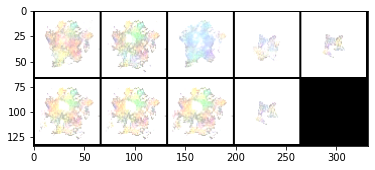

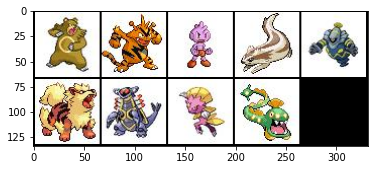

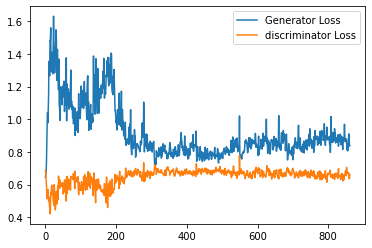

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_17250.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 17375: Epoch: 56: Generator loss: 0.8473698644638061, discriminator loss: 0.6702888956069947 mean disc pred on real images: 0.5213979482650757, fake images: 0.47343918681144714


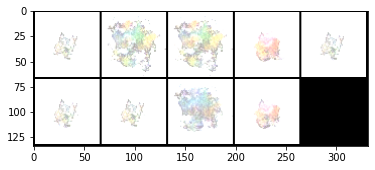

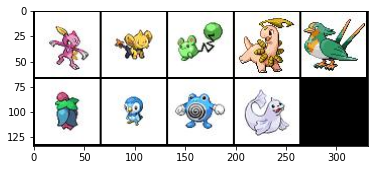

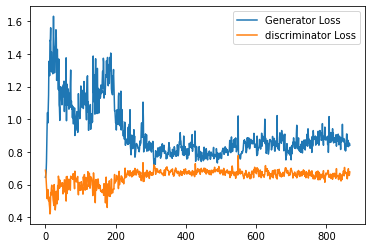

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 17500: Epoch: 56: Generator loss: 0.8971493473052978, discriminator loss: 0.6555787425041198 mean disc pred on real images: 0.5332521200180054, fake images: 0.46596768498420715


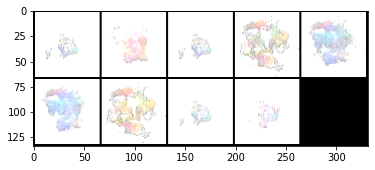

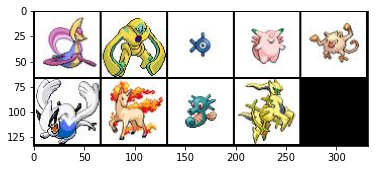

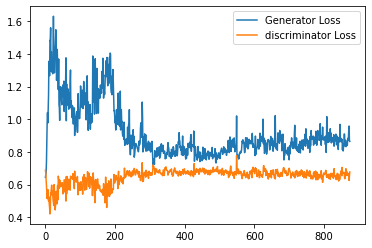

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_17500.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 17625: Epoch: 57: Generator loss: 0.8253761553764343, discriminator loss: 0.6793089113235473 mean disc pred on real images: 0.5267881155014038, fake images: 0.4845200181007385


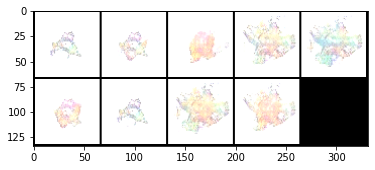

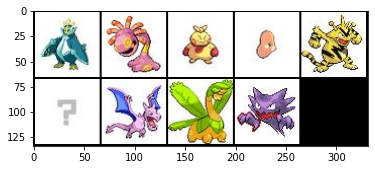

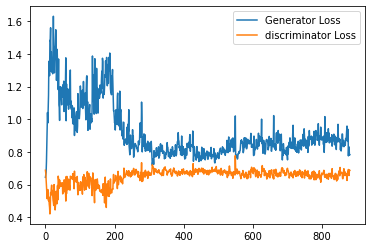

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 17750: Epoch: 57: Generator loss: 0.827125005722046, discriminator loss: 0.679028754234314 mean disc pred on real images: 0.5191636681556702, fake images: 0.47880056500434875


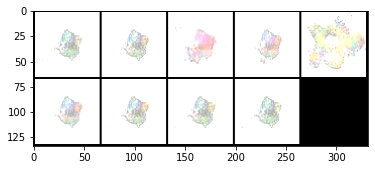

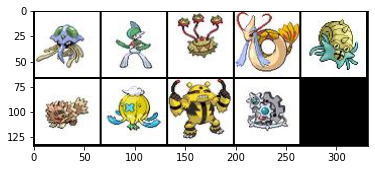

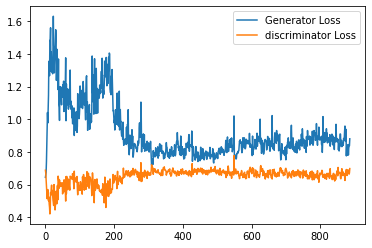

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_17750.pt !


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 17875: Epoch: 57: Generator loss: 0.8382819743156433, discriminator loss: 0.6595676770210266 mean disc pred on real images: 0.5262883305549622, fake images: 0.4679229259490967


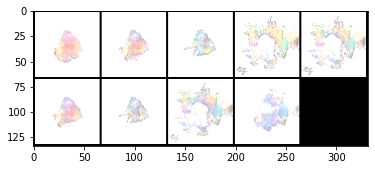

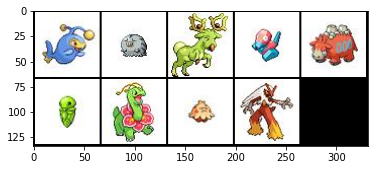

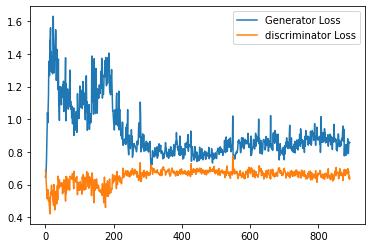

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 18000: Epoch: 58: Generator loss: 0.8434635705947876, discriminator loss: 0.6552772822380066 mean disc pred on real images: 0.5359672904014587, fake images: 0.4668278098106384


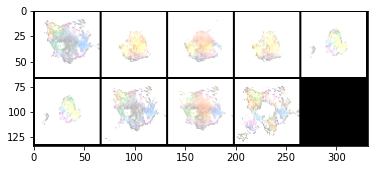

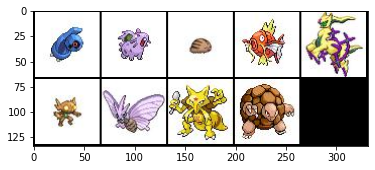

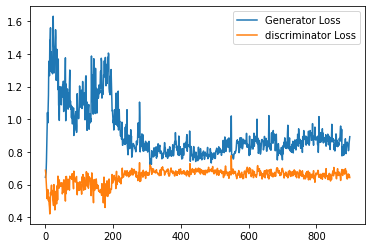

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_18000.pt !


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 18125: Epoch: 58: Generator loss: 0.8685046036243439, discriminator loss: 0.6581770372390747 mean disc pred on real images: 0.5327571630477905, fake images: 0.4639492928981781


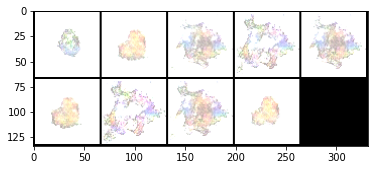

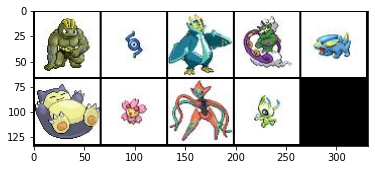

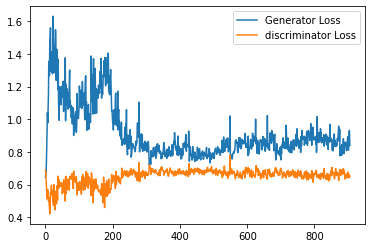

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 18250: Epoch: 59: Generator loss: 0.8414447755813599, discriminator loss: 0.6673352165222168 mean disc pred on real images: 0.5233375430107117, fake images: 0.47359776496887207


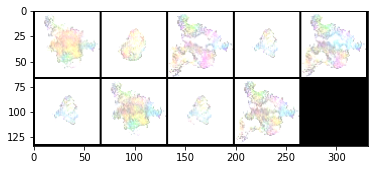

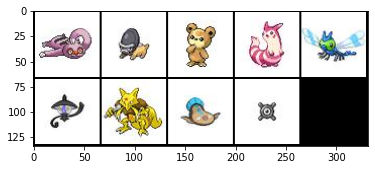

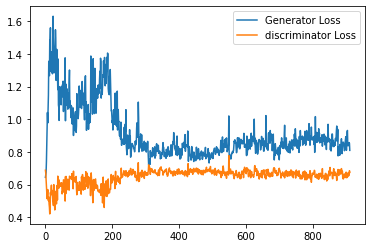

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_18250.pt !


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 18375: Epoch: 59: Generator loss: 0.901777766942978, discriminator loss: 0.6642142372131348 mean disc pred on real images: 0.5237393975257874, fake images: 0.46426159143447876


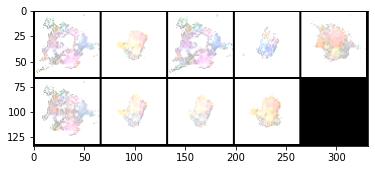

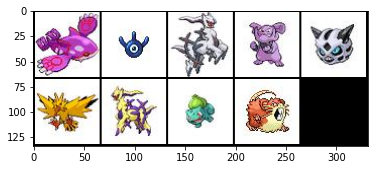

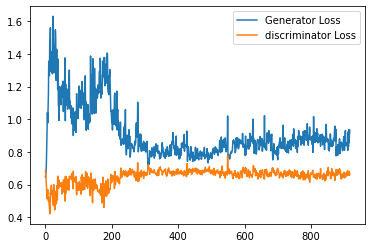

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 18500: Epoch: 59: Generator loss: 0.8896509704589843, discriminator loss: 0.646162567615509 mean disc pred on real images: 0.5365530848503113, fake images: 0.4600818157196045


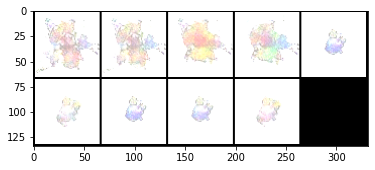

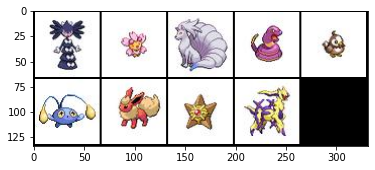

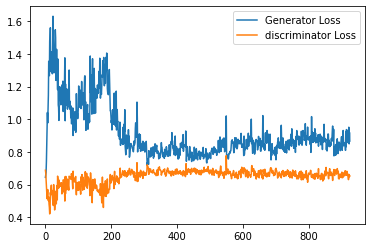

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_18500.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 18625: Epoch: 60: Generator loss: 0.8688416209220886, discriminator loss: 0.6640529804229737 mean disc pred on real images: 0.5300791263580322, fake images: 0.47028347849845886


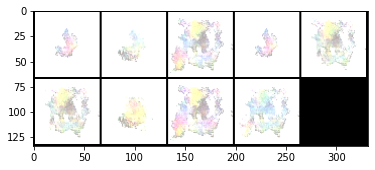

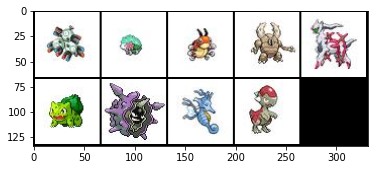

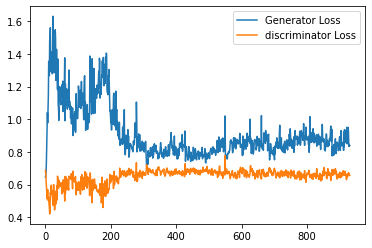

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 18750: Epoch: 60: Generator loss: 0.8906862735748291, discriminator loss: 0.6581952848434448 mean disc pred on real images: 0.5354465246200562, fake images: 0.46499067544937134


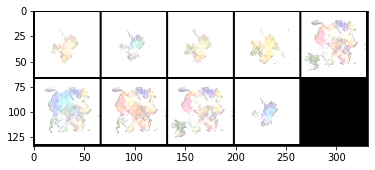

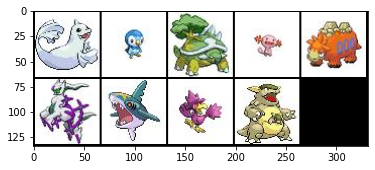

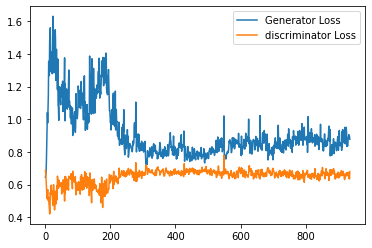

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_18750.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 18875: Epoch: 61: Generator loss: 0.8553389921188355, discriminator loss: 0.6535425844192505 mean disc pred on real images: 0.5362122654914856, fake images: 0.46904510259628296


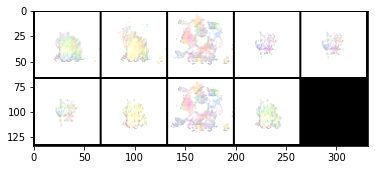

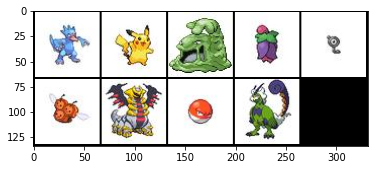

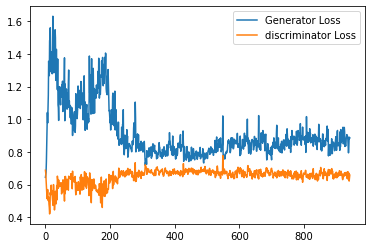

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 19000: Epoch: 61: Generator loss: 0.899810037612915, discriminator loss: 0.6461780161857605 mean disc pred on real images: 0.5379630327224731, fake images: 0.45826098322868347


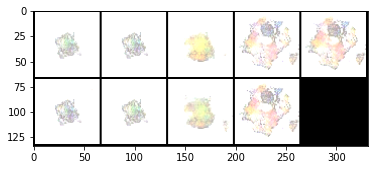

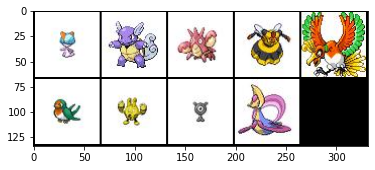

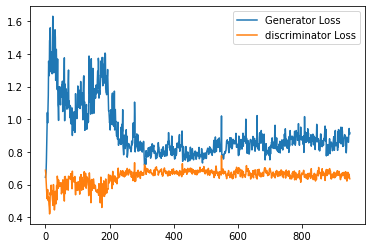

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_19000.pt !


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 19125: Epoch: 61: Generator loss: 0.8870095009803772, discriminator loss: 0.645744167804718 mean disc pred on real images: 0.5427548885345459, fake images: 0.46096155047416687


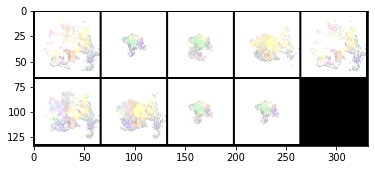

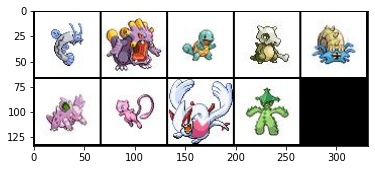

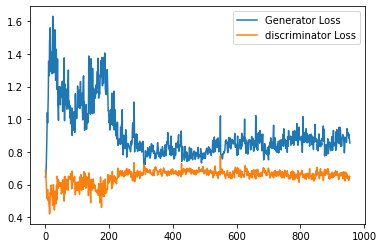

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fd068fc50e0>
Traceback (most recent call last):
  File "/Users/moose_abdool/miniconda3/envs/cs236g_py37/lib/python3.7/site-packages/torch/utils/data/dataloader.py", line 1328, in __del__
    self._shutdown_workers()
  File "/Users/moose_abdool/miniconda3/envs/cs236g_py37/lib/python3.7/site-packages/torch/utils/data/dataloader.py", line 1320, in _shutdown_workers
    if w.is_alive():
  File "/Users/moose_abdool/miniconda3/envs/cs236g_py37/lib/python3.7/multiprocessing/process.py", line 151, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fd068fc50e0>
Traceba

Step 19250: Epoch: 62: Generator loss: 0.8219411692619324, discriminator loss: 0.6793105616569519 mean disc pred on real images: 0.5199400782585144, fake images: 0.48099371790885925


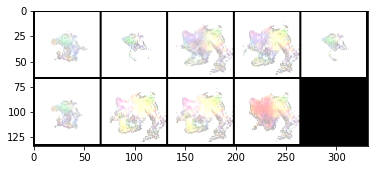

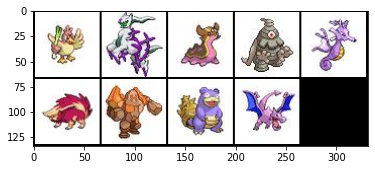

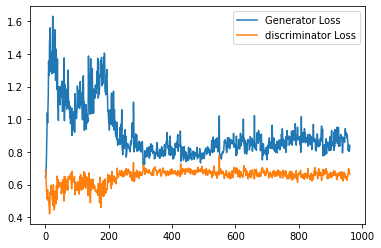

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_19250.pt !


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 19375: Epoch: 62: Generator loss: 0.8563572988510132, discriminator loss: 0.6717586574554444 mean disc pred on real images: 0.522613525390625, fake images: 0.47159355878829956


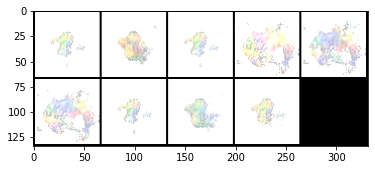

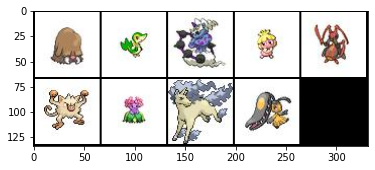

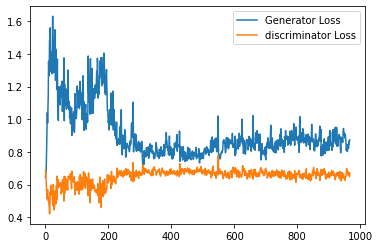

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 19500: Epoch: 63: Generator loss: 0.8586671731472015, discriminator loss: 0.6657100987434387 mean disc pred on real images: 0.5287500023841858, fake images: 0.47178027033805847


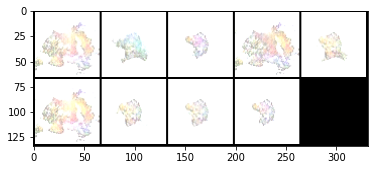

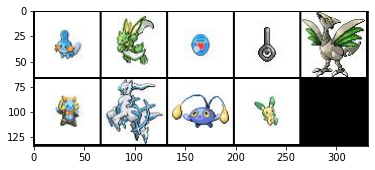

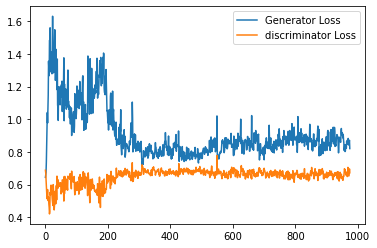

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_19500.pt !


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 19625: Epoch: 63: Generator loss: 0.877260968208313, discriminator loss: 0.6537026324272156 mean disc pred on real images: 0.534429669380188, fake images: 0.4662008583545685


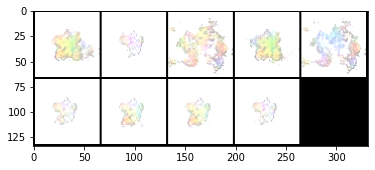

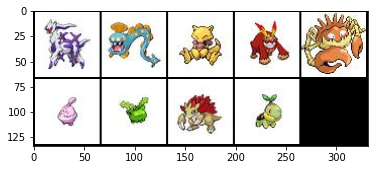

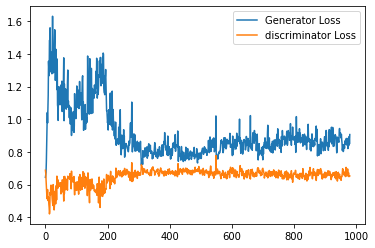

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 19750: Epoch: 63: Generator loss: 0.9307939422130584, discriminator loss: 0.6518308620452881 mean disc pred on real images: 0.5490698218345642, fake images: 0.4648159146308899


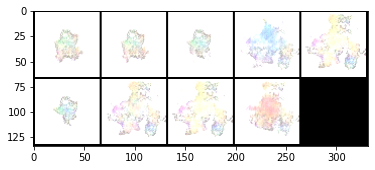

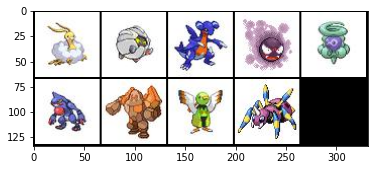

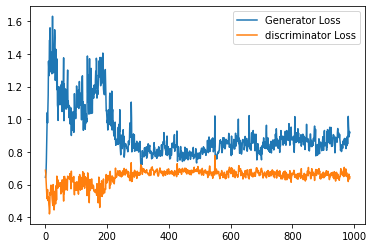

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_19750.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 19875: Epoch: 64: Generator loss: 0.8741902182102204, discriminator loss: 0.6519308876991272 mean disc pred on real images: 0.537036657333374, fake images: 0.46532124280929565


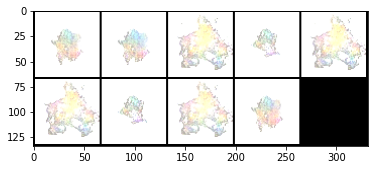

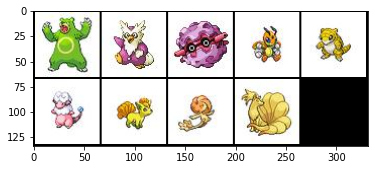

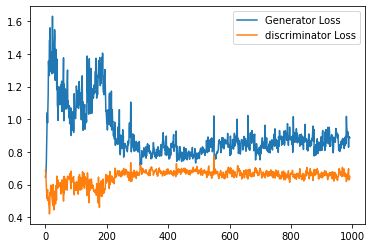

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 20000: Epoch: 64: Generator loss: 0.8520455718040466, discriminator loss: 0.6674476203918457 mean disc pred on real images: 0.5220995545387268, fake images: 0.47124403715133667


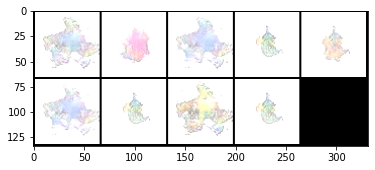

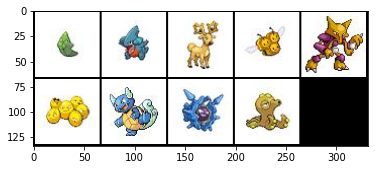

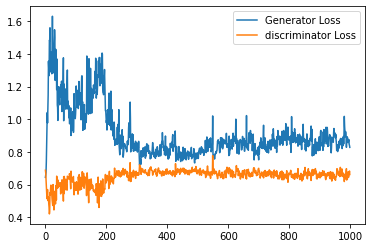

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_20000.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 20125: Epoch: 65: Generator loss: 0.8637275881767273, discriminator loss: 0.654596535205841 mean disc pred on real images: 0.5371760725975037, fake images: 0.46961960196495056


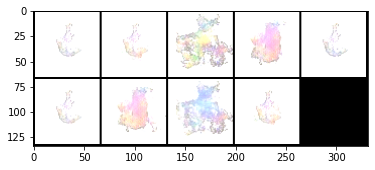

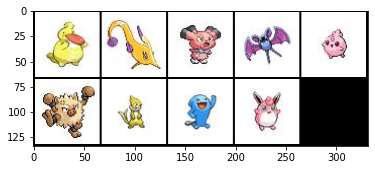

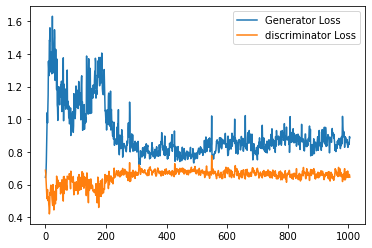

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 20250: Epoch: 65: Generator loss: 0.914482566833496, discriminator loss: 0.6473069653511048 mean disc pred on real images: 0.5422106981277466, fake images: 0.4596175253391266


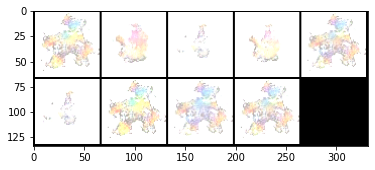

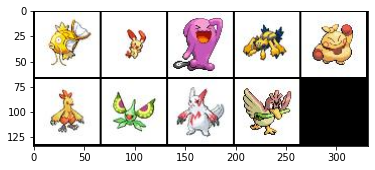

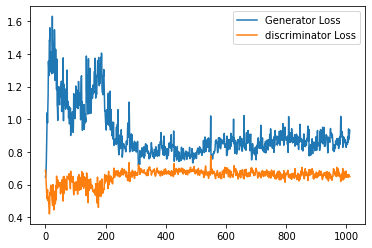

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_20250.pt !


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 20375: Epoch: 65: Generator loss: 0.8956759519577027, discriminator loss: 0.6561631145477295 mean disc pred on real images: 0.5371862053871155, fake images: 0.4620360732078552


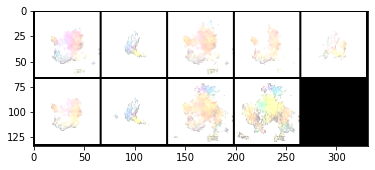

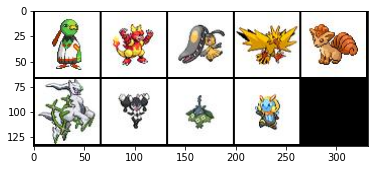

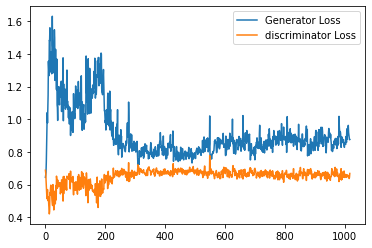

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 20500: Epoch: 66: Generator loss: 0.8818094882965087, discriminator loss: 0.6657995848655701 mean disc pred on real images: 0.5320591330528259, fake images: 0.46790438890457153


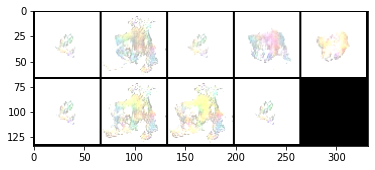

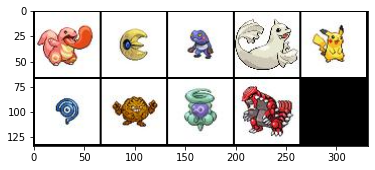

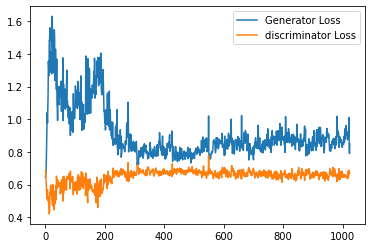

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_20500.pt !
Step 20625: Epoch: 66: Generator loss: 0.8581461381912231, discriminator loss: 0.6631120724678039 mean disc pred on real images: 0.5354276895523071, fake images: 0.472385436296463


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


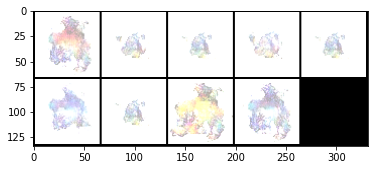

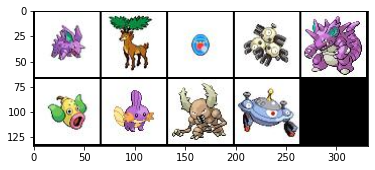

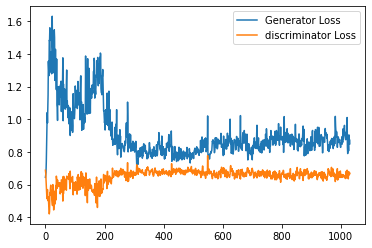

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 20750: Epoch: 67: Generator loss: 0.8869754774570465, discriminator loss: 0.6502204051017761 mean disc pred on real images: 0.5379160642623901, fake images: 0.4570719301700592


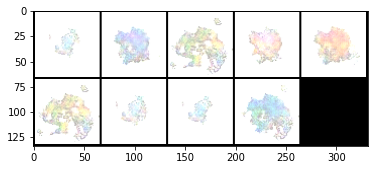

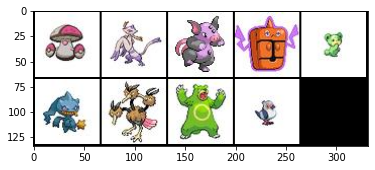

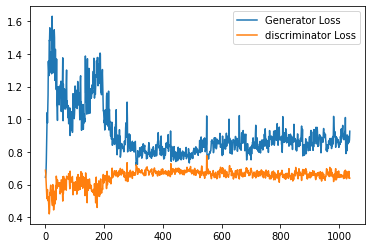

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_20750.pt !


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 20875: Epoch: 67: Generator loss: 0.90697815823555, discriminator loss: 0.6518028855323792 mean disc pred on real images: 0.5419981479644775, fake images: 0.45965251326560974


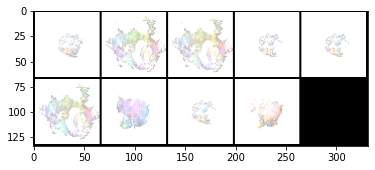

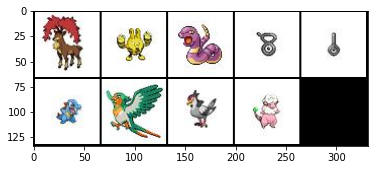

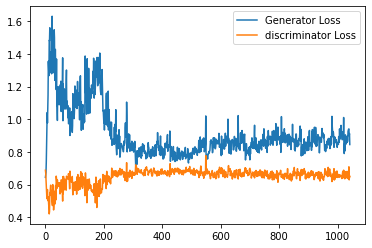

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 21000: Epoch: 67: Generator loss: 0.9185226926803589, discriminator loss: 0.645936222076416 mean disc pred on real images: 0.5503818392753601, fake images: 0.4575028419494629


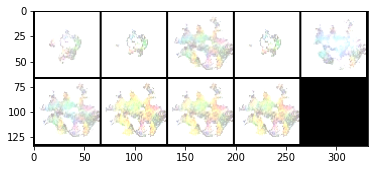

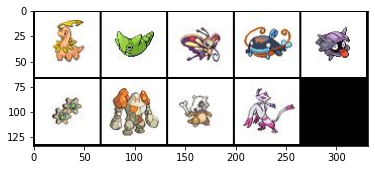

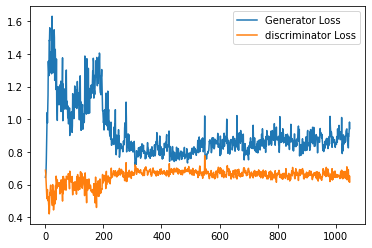

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_21000.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 21125: Epoch: 68: Generator loss: 0.9387891595363617, discriminator loss: 0.6343876342773438 mean disc pred on real images: 0.5475224256515503, fake images: 0.4498712718486786


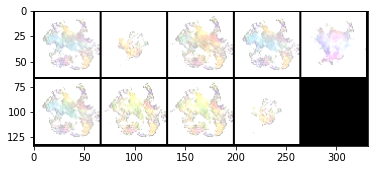

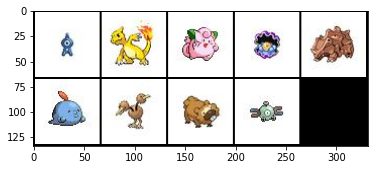

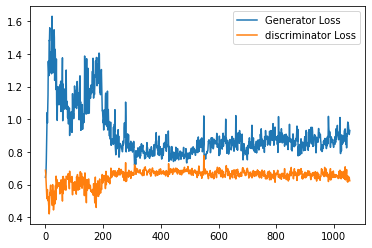

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 21250: Epoch: 68: Generator loss: 0.91284339594841, discriminator loss: 0.6501324596405029 mean disc pred on real images: 0.5397716164588928, fake images: 0.4586643874645233


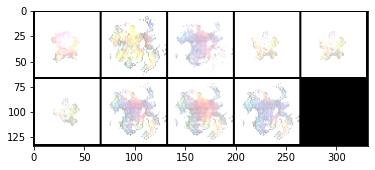

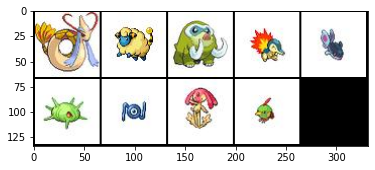

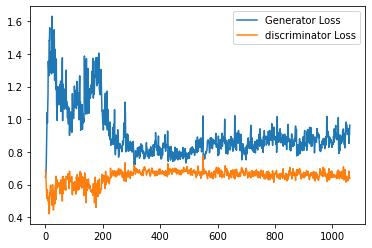

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_21250.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 21375: Epoch: 69: Generator loss: 0.9228679234981537, discriminator loss: 0.6558233289718628 mean disc pred on real images: 0.5427811741828918, fake images: 0.46160179376602173


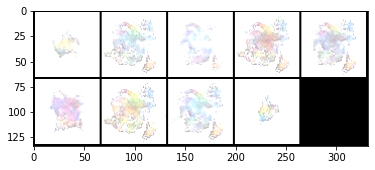

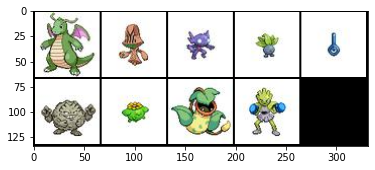

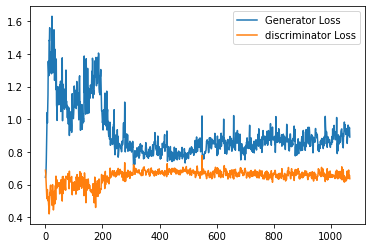

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 21500: Epoch: 69: Generator loss: 0.9763363320827484, discriminator loss: 0.6480106511116028 mean disc pred on real images: 0.5467941761016846, fake images: 0.4518226683139801


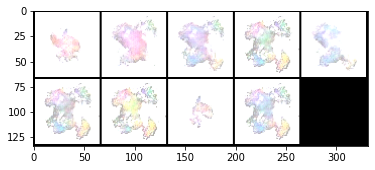

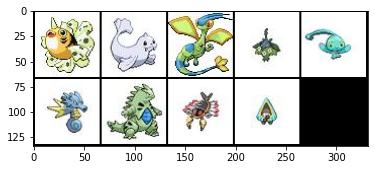

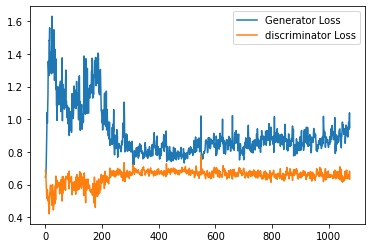

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_21500.pt !


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 21625: Epoch: 69: Generator loss: 0.9708469593524933, discriminator loss: 0.6225925664901734 mean disc pred on real images: 0.5576668977737427, fake images: 0.44100064039230347


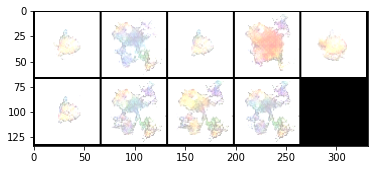

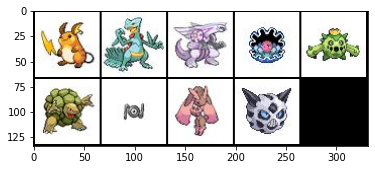

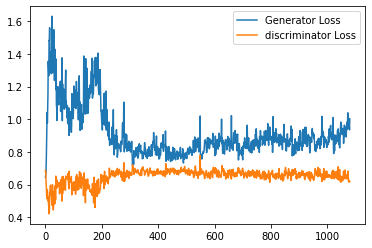

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 21750: Epoch: 70: Generator loss: 0.9788249387741089, discriminator loss: 0.6234444046020508 mean disc pred on real images: 0.5605781674385071, fake images: 0.4432237148284912


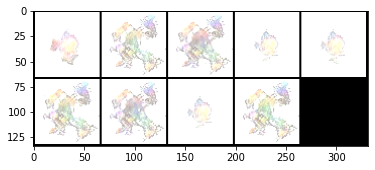

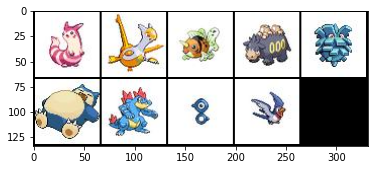

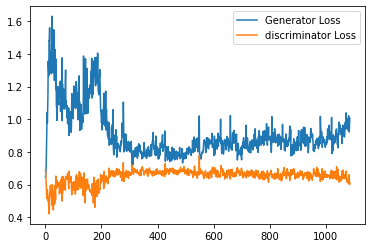

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_21750.pt !


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 21875: Epoch: 70: Generator loss: 0.9978730676174163, discriminator loss: 0.6205254254341126 mean disc pred on real images: 0.5644633173942566, fake images: 0.4377100169658661


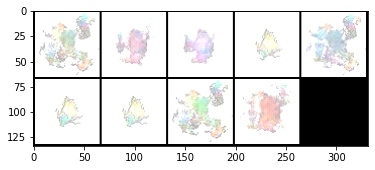

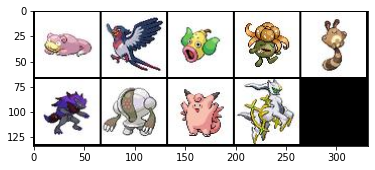

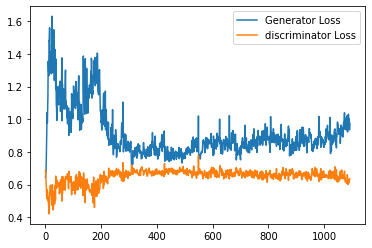

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 22000: Epoch: 71: Generator loss: 0.9997785768508911, discriminator loss: 0.6140816583633423 mean disc pred on real images: 0.5636667609214783, fake images: 0.4314640164375305


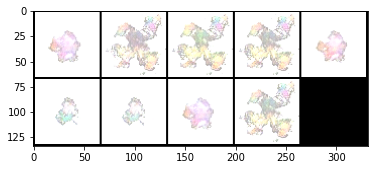

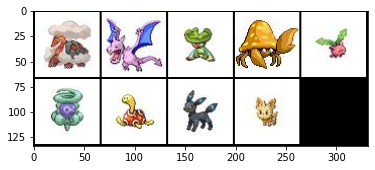

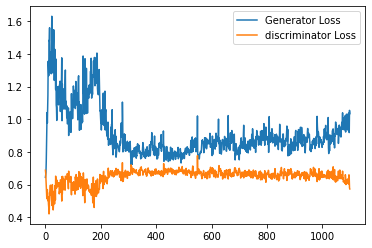

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_22000.pt !


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 22125: Epoch: 71: Generator loss: 0.9926768665313721, discriminator loss: 0.6307564077377319 mean disc pred on real images: 0.5601462721824646, fake images: 0.44224655628204346


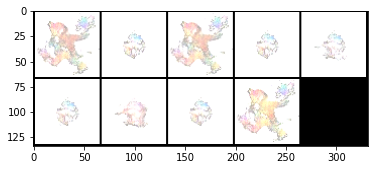

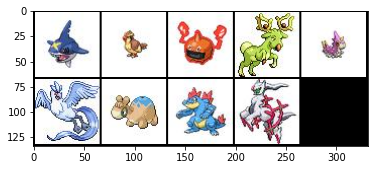

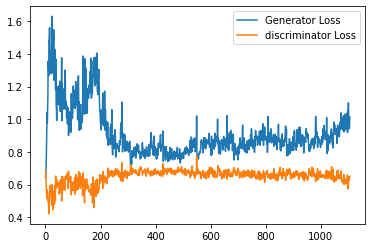

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 22250: Epoch: 72: Generator loss: 1.031326502084732, discriminator loss: 0.6444446883201599 mean disc pred on real images: 0.5555763840675354, fake images: 0.44004201889038086


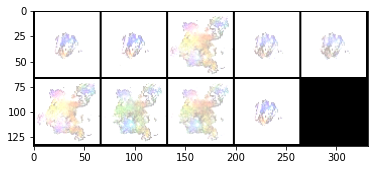

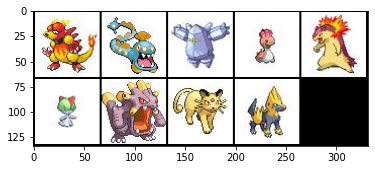

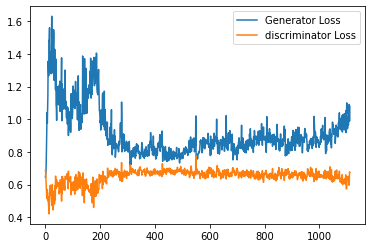

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_22250.pt !


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 22375: Epoch: 72: Generator loss: 0.9557728080749511, discriminator loss: 0.6449165658950806 mean disc pred on real images: 0.5515656471252441, fake images: 0.4528694748878479


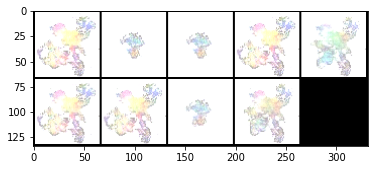

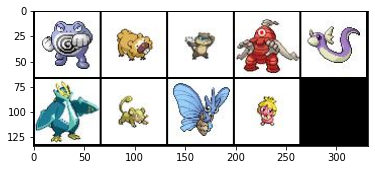

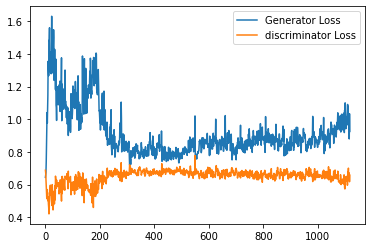

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 22500: Epoch: 72: Generator loss: 0.9121901960372925, discriminator loss: 0.666376473903656 mean disc pred on real images: 0.539570689201355, fake images: 0.4593401253223419


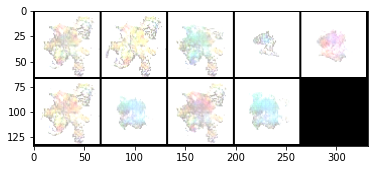

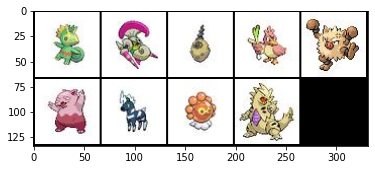

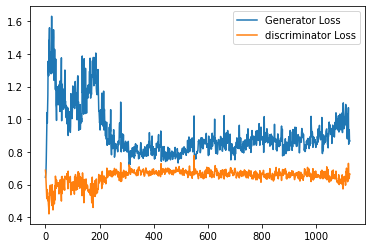

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_22500.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 22625: Epoch: 73: Generator loss: 0.9898925256729126, discriminator loss: 0.628019820690155 mean disc pred on real images: 0.5569179058074951, fake images: 0.4433493912220001


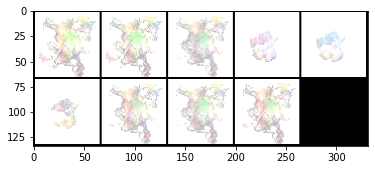

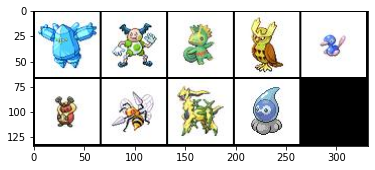

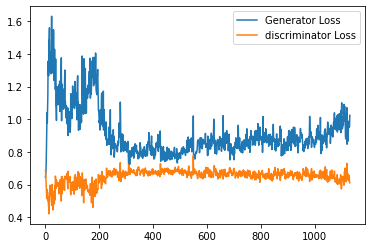

Step 22750: Epoch: 73: Generator loss: 0.9369294660091401, discriminator loss: 0.6473922629356385 mean disc pred on real images: 0.5562551021575928, fake images: 0.45378580689430237


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


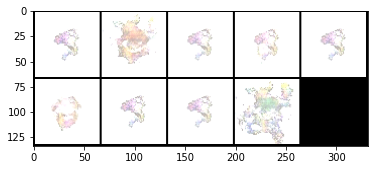

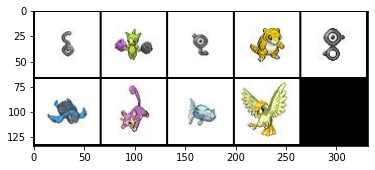

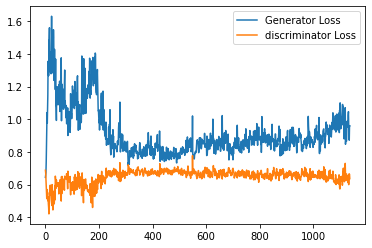

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_22750.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 22875: Epoch: 74: Generator loss: 0.9455492100715637, discriminator loss: 0.639593976020813 mean disc pred on real images: 0.5548815131187439, fake images: 0.44843414425849915


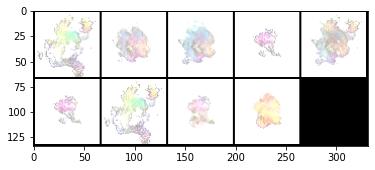

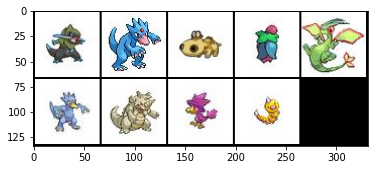

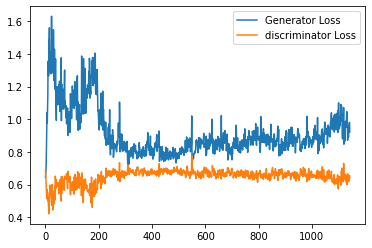

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 23000: Epoch: 74: Generator loss: 0.9699250073432922, discriminator loss: 0.630659170627594 mean disc pred on real images: 0.5514601469039917, fake images: 0.439959317445755


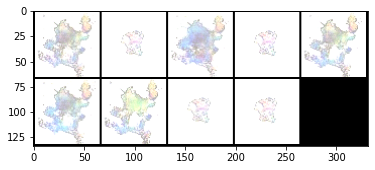

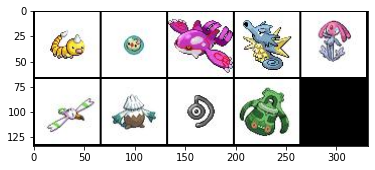

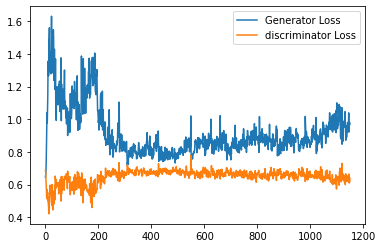

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_23000.pt !


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 23125: Epoch: 74: Generator loss: 0.9803340497016907, discriminator loss: 0.6215580649375916 mean disc pred on real images: 0.5593476891517639, fake images: 0.43631383776664734


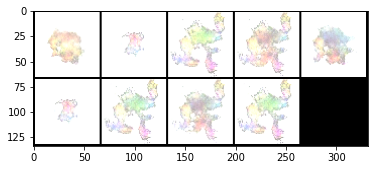

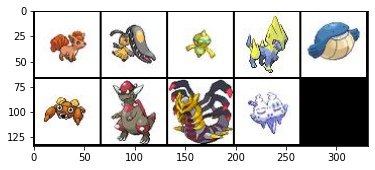

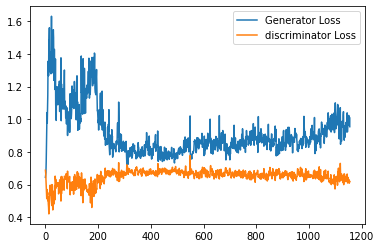

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 23250: Epoch: 75: Generator loss: 0.9834464151859283, discriminator loss: 0.607414731502533 mean disc pred on real images: 0.563801646232605, fake images: 0.43038254976272583


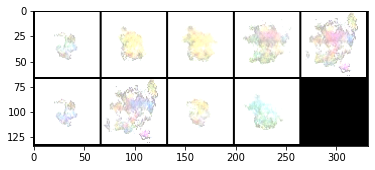

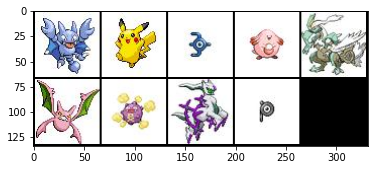

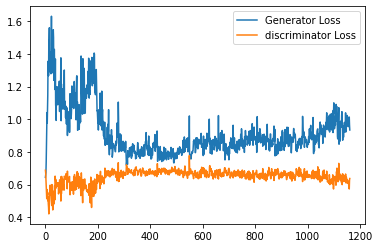

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_23250.pt !


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 23375: Epoch: 75: Generator loss: 0.9918236911296845, discriminator loss: 0.6256733784675598 mean disc pred on real images: 0.5653672218322754, fake images: 0.4388774037361145


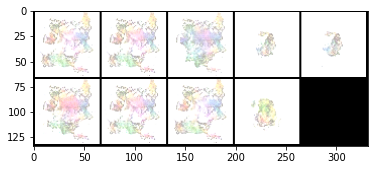

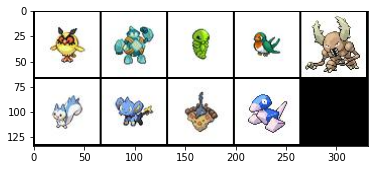

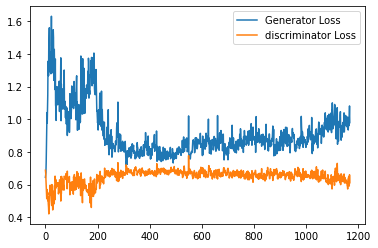

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 23500: Epoch: 76: Generator loss: 0.9831108634471893, discriminator loss: 0.6377374339103699 mean disc pred on real images: 0.5638092160224915, fake images: 0.44897785782814026


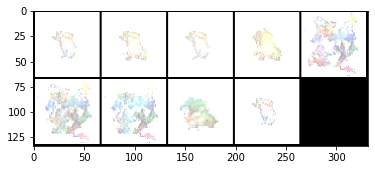

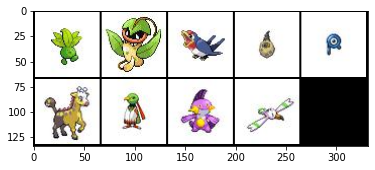

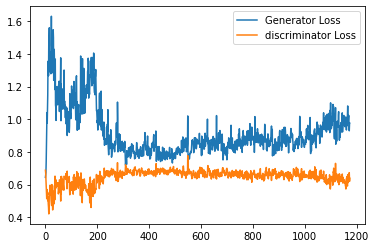

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_23500.pt !


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 23625: Epoch: 76: Generator loss: 0.975563594341278, discriminator loss: 0.638140974521637 mean disc pred on real images: 0.5563883781433105, fake images: 0.44720694422721863


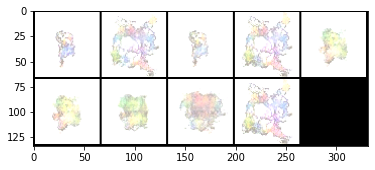

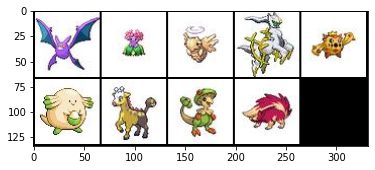

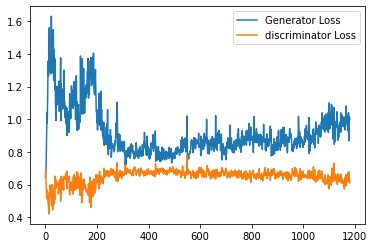

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 23750: Epoch: 76: Generator loss: 0.9711648788452149, discriminator loss: 0.6452718110084533 mean disc pred on real images: 0.5537338256835938, fake images: 0.45005732774734497


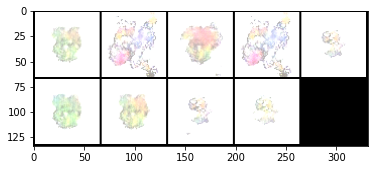

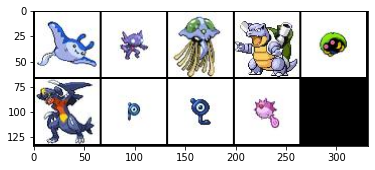

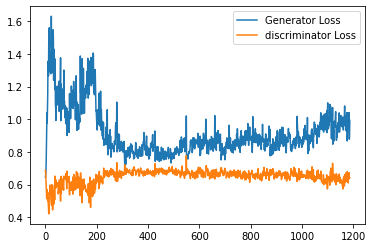

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_23750.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 23875: Epoch: 77: Generator loss: 0.9167296307086945, discriminator loss: 0.657590877532959 mean disc pred on real images: 0.5401822328567505, fake images: 0.46026504039764404


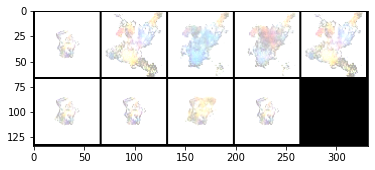

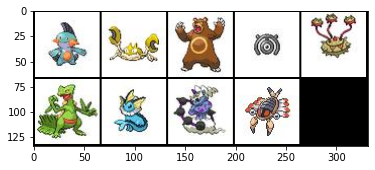

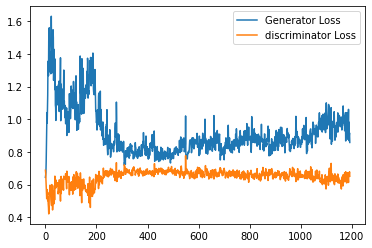

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 24000: Epoch: 77: Generator loss: 0.946842393875122, discriminator loss: 0.6368166580200195 mean disc pred on real images: 0.5557978749275208, fake images: 0.44529634714126587


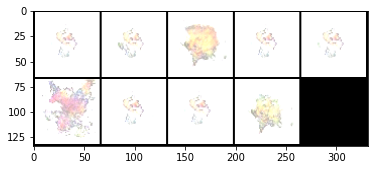

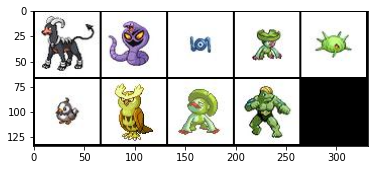

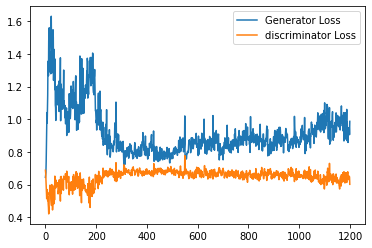

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_24000.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 24125: Epoch: 78: Generator loss: 0.9758204479217529, discriminator loss: 0.6406928071975708 mean disc pred on real images: 0.552726686000824, fake images: 0.44368958473205566


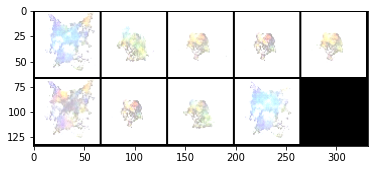

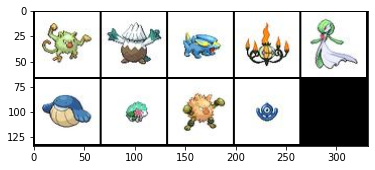

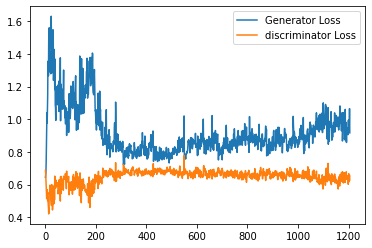

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 24250: Epoch: 78: Generator loss: 0.9819839458465576, discriminator loss: 0.5998231024742127 mean disc pred on real images: 0.5758470892906189, fake images: 0.4291228652000427


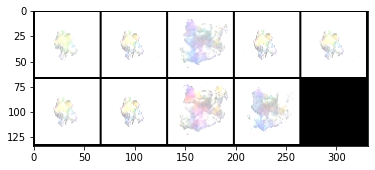

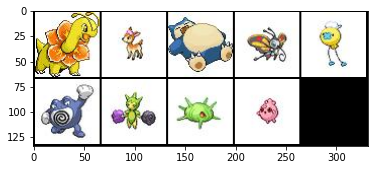

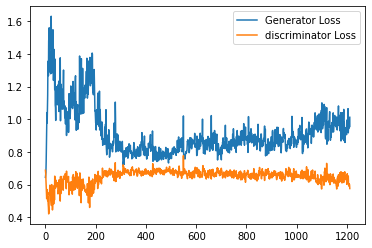

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_24250.pt !


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 24375: Epoch: 78: Generator loss: 0.9741744706630707, discriminator loss: 0.6243051238059998 mean disc pred on real images: 0.5699356198310852, fake images: 0.43445685505867004


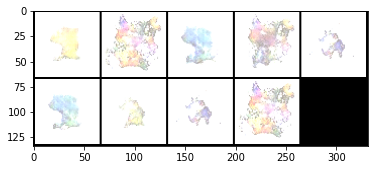

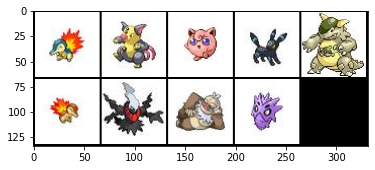

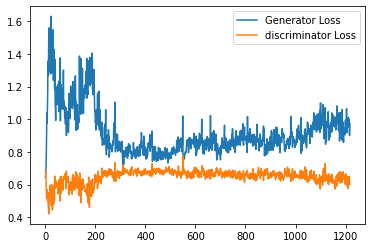

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 24500: Epoch: 79: Generator loss: 0.98810981965065, discriminator loss: 0.6228209943771362 mean disc pred on real images: 0.5667227506637573, fake images: 0.4388892352581024


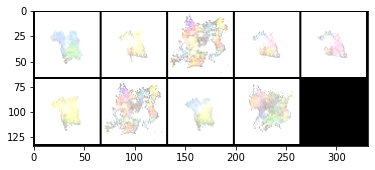

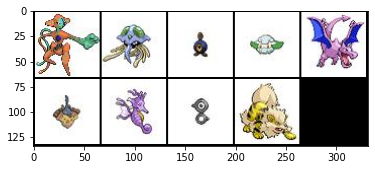

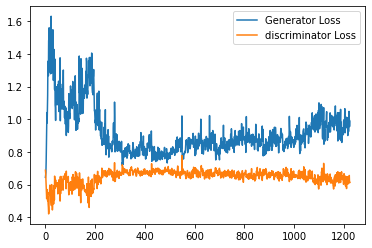

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_24500.pt !


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 24625: Epoch: 79: Generator loss: 0.9602371850013733, discriminator loss: 0.6185132455825806 mean disc pred on real images: 0.5707242488861084, fake images: 0.4391940236091614


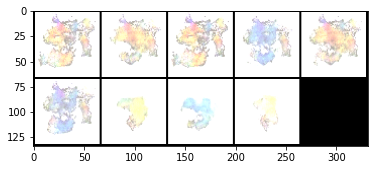

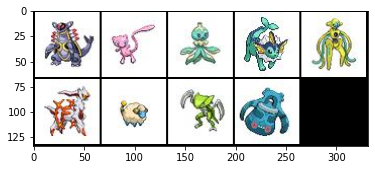

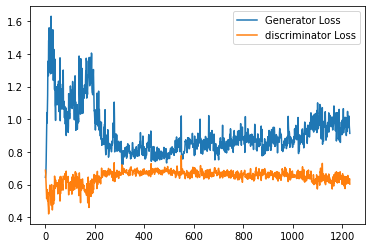

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 24750: Epoch: 80: Generator loss: 0.995215892791748, discriminator loss: 0.643821008682251 mean disc pred on real images: 0.5538350939750671, fake images: 0.4484482407569885


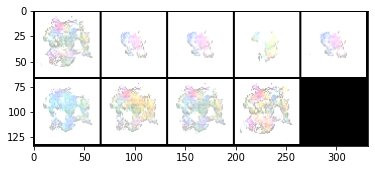

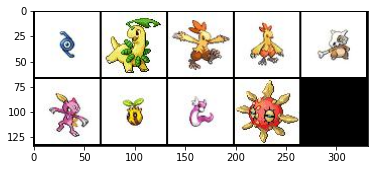

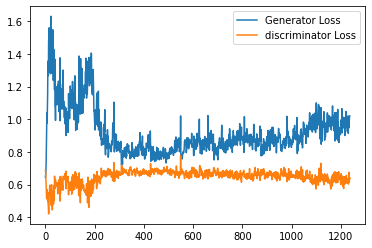

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_24750.pt !
Step 24875: Epoch: 80: Generator loss: 0.9938435115814209, discriminator loss: 0.6179723720550537 mean disc pred on real images: 0.5587241053581238, fake images: 0.4305160641670227


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


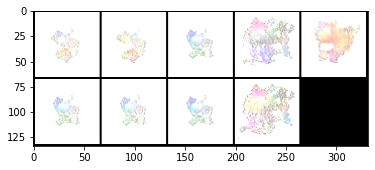

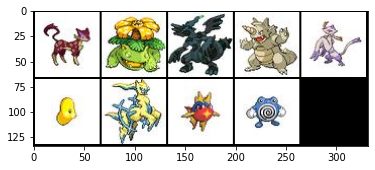

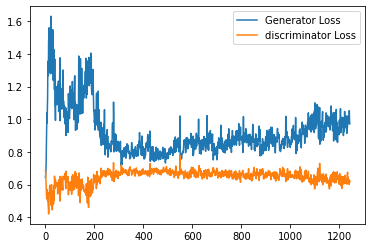

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 25000: Epoch: 80: Generator loss: 0.966380764245987, discriminator loss: 0.6326922731399536 mean disc pred on real images: 0.5557977557182312, fake images: 0.4427660405635834


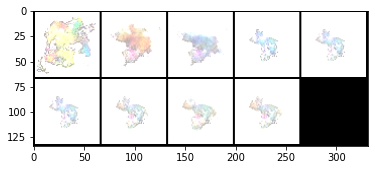

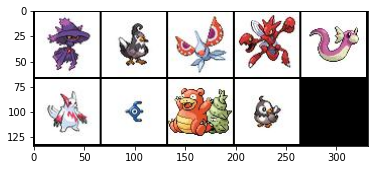

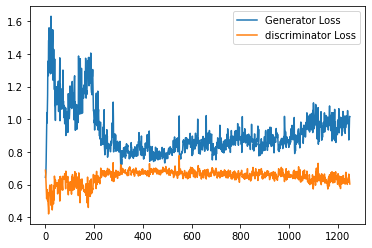

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_25000.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 25125: Epoch: 81: Generator loss: 0.9883641145229339, discriminator loss: 0.6192064318656921 mean disc pred on real images: 0.5668990612030029, fake images: 0.432661235332489


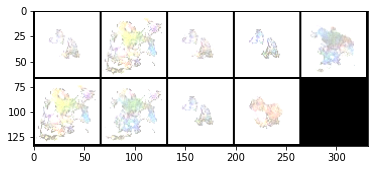

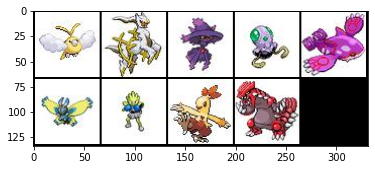

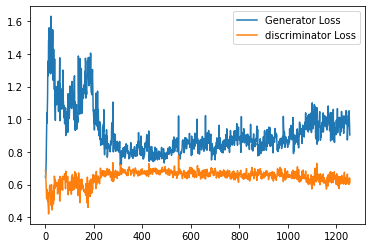

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 25250: Epoch: 81: Generator loss: 0.9906978346109391, discriminator loss: 0.6200930018424988 mean disc pred on real images: 0.5752661824226379, fake images: 0.43278437852859497


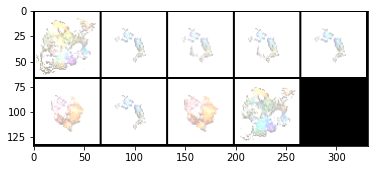

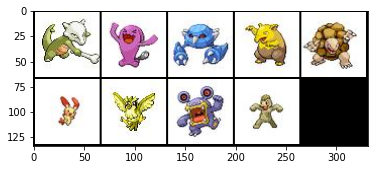

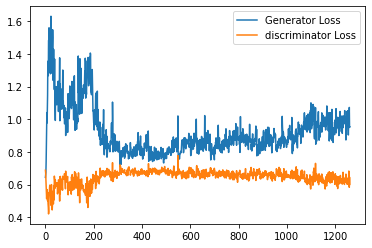

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_25250.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 25375: Epoch: 82: Generator loss: 0.976616621017456, discriminator loss: 0.6517749466896057 mean disc pred on real images: 0.5538033843040466, fake images: 0.45023149251937866


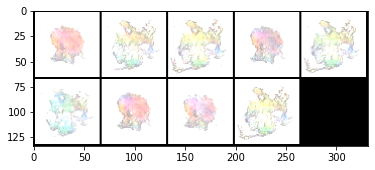

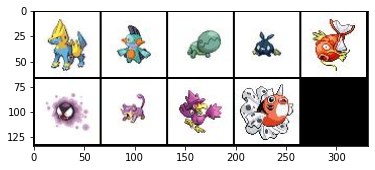

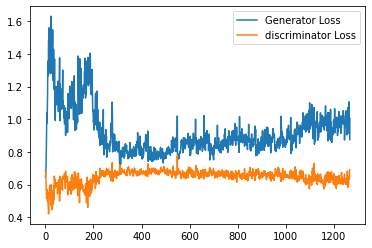

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 25500: Epoch: 82: Generator loss: 0.9815529217720032, discriminator loss: 0.6425471258163452 mean disc pred on real images: 0.543944776058197, fake images: 0.4419265389442444


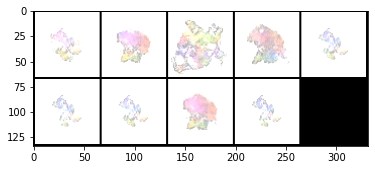

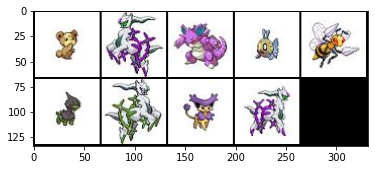

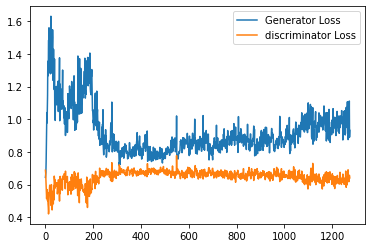

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_25500.pt !


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 25625: Epoch: 82: Generator loss: 0.9836644601821899, discriminator loss: 0.6378659172058105 mean disc pred on real images: 0.5545116066932678, fake images: 0.44165468215942383


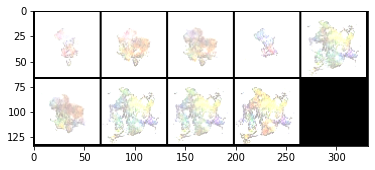

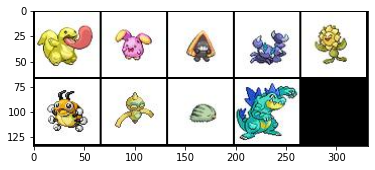

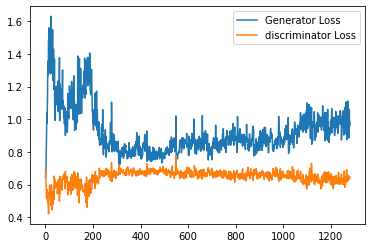

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 25750: Epoch: 83: Generator loss: 0.9723655996322632, discriminator loss: 0.6348523354530334 mean disc pred on real images: 0.5622850060462952, fake images: 0.44492900371551514


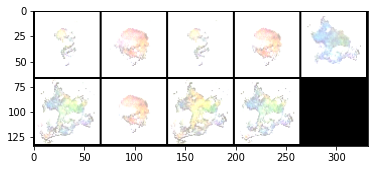

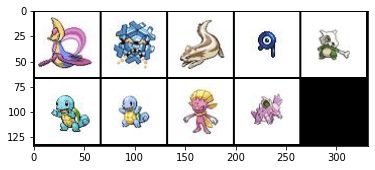

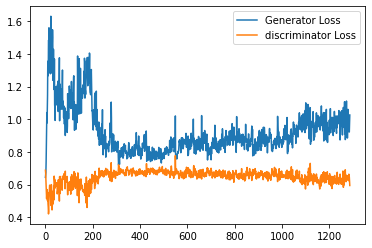

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_25750.pt !


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 25875: Epoch: 83: Generator loss: 0.9943609580993652, discriminator loss: 0.600345627784729 mean disc pred on real images: 0.5790010690689087, fake images: 0.4232812821865082


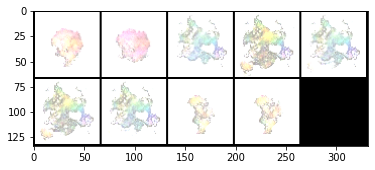

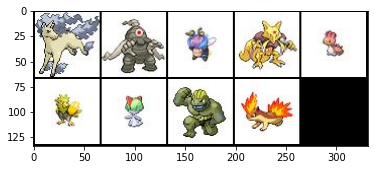

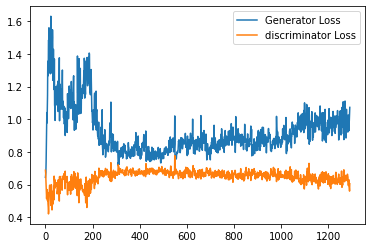

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 26000: Epoch: 84: Generator loss: 0.9855002963542938, discriminator loss: 0.6307954483032227 mean disc pred on real images: 0.5565282702445984, fake images: 0.4366566240787506


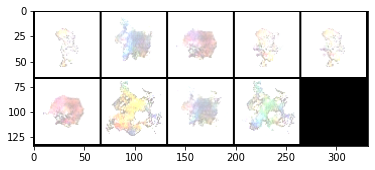

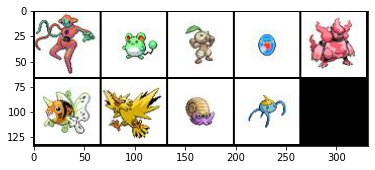

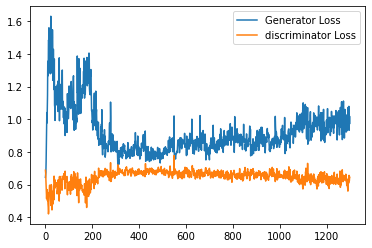

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_26000.pt !


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 26125: Epoch: 84: Generator loss: 0.9809719376564026, discriminator loss: 0.6287580575942994 mean disc pred on real images: 0.5612975358963013, fake images: 0.4415321946144104


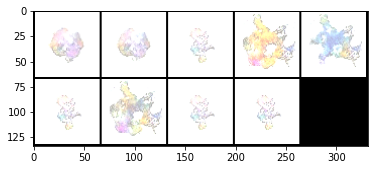

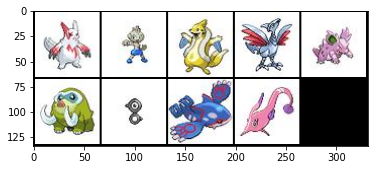

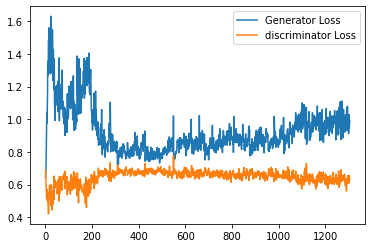

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 26250: Epoch: 84: Generator loss: 1.0353600835800172, discriminator loss: 0.6244457473754883 mean disc pred on real images: 0.5650462508201599, fake images: 0.4275462031364441


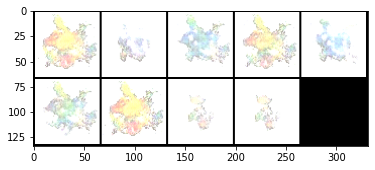

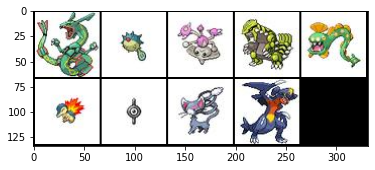

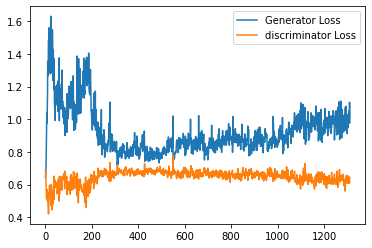

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_26250.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 26375: Epoch: 85: Generator loss: 1.0093814883232117, discriminator loss: 0.6122780413627624 mean disc pred on real images: 0.5655952095985413, fake images: 0.42488595843315125


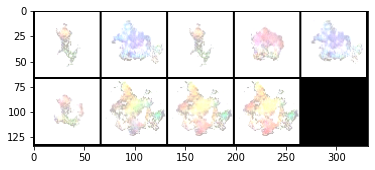

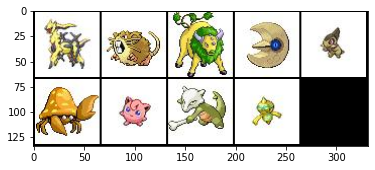

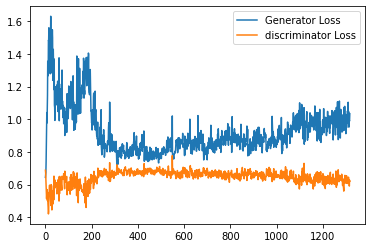

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 26500: Epoch: 85: Generator loss: 1.08487584733963, discriminator loss: 0.5830698466300964 mean disc pred on real images: 0.5880922079086304, fake images: 0.403237521648407


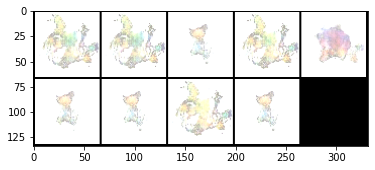

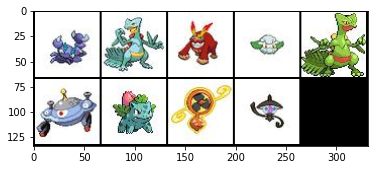

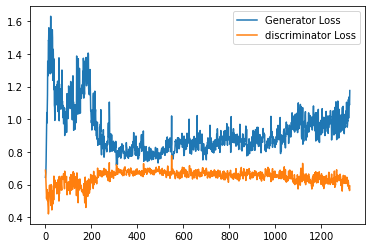

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_26500.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 26625: Epoch: 86: Generator loss: 1.0075904767513275, discriminator loss: 0.6312687697410584 mean disc pred on real images: 0.5680153369903564, fake images: 0.44393888115882874


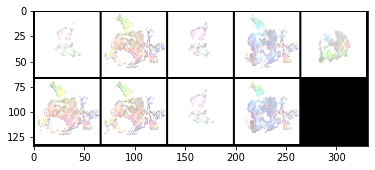

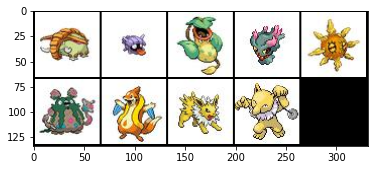

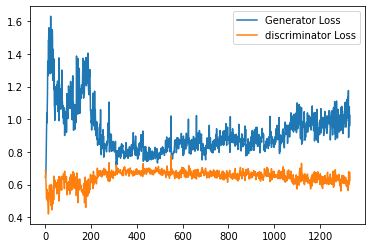

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 26750: Epoch: 86: Generator loss: 1.060400553703308, discriminator loss: 0.6033559222221374 mean disc pred on real images: 0.5772089958190918, fake images: 0.4206794202327728


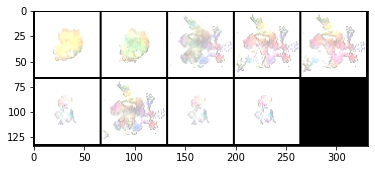

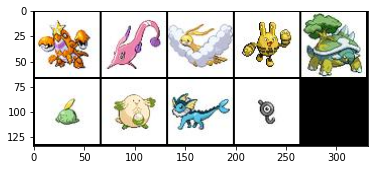

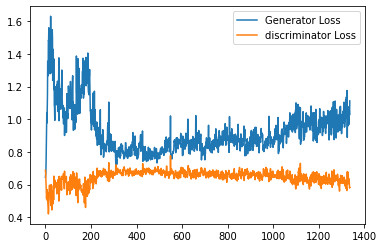

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_26750.pt !


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 26875: Epoch: 86: Generator loss: 0.9792050604820252, discriminator loss: 0.6411143093109131 mean disc pred on real images: 0.555939257144928, fake images: 0.43993014097213745


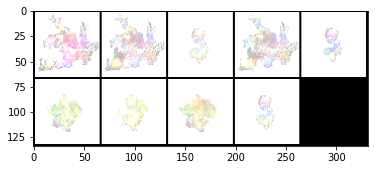

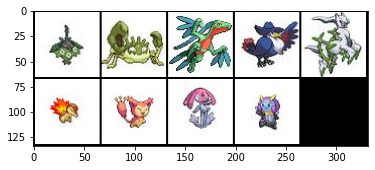

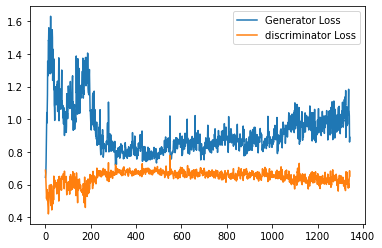

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 27000: Epoch: 87: Generator loss: 0.9359430463314057, discriminator loss: 0.6511464829444885 mean disc pred on real images: 0.5492387413978577, fake images: 0.4489859938621521


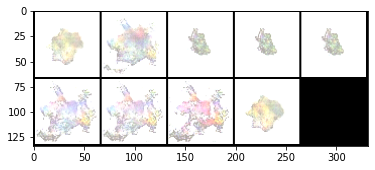

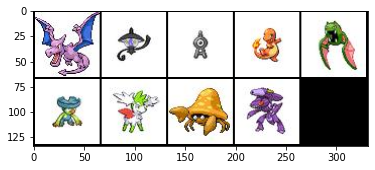

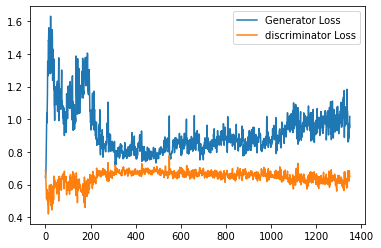

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_27000.pt !


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 27125: Epoch: 87: Generator loss: 1.0261755549907685, discriminator loss: 0.6249518537521362 mean disc pred on real images: 0.5663051009178162, fake images: 0.42913129925727844


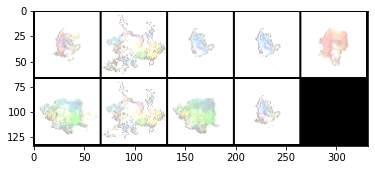

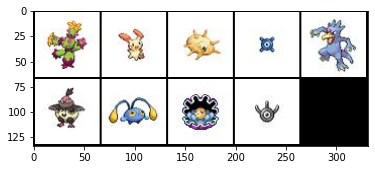

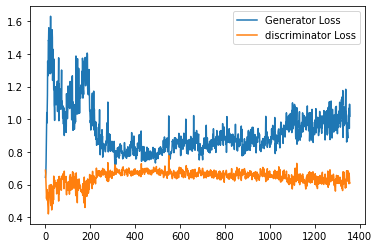

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 27250: Epoch: 88: Generator loss: 1.0299625535011292, discriminator loss: 0.6226038551330566 mean disc pred on real images: 0.5687208771705627, fake images: 0.42687511444091797


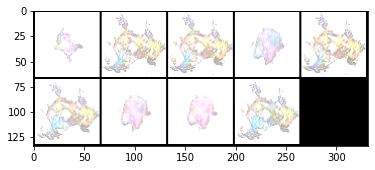

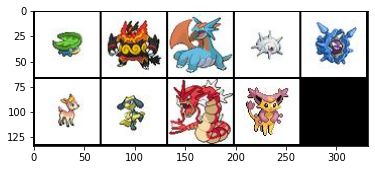

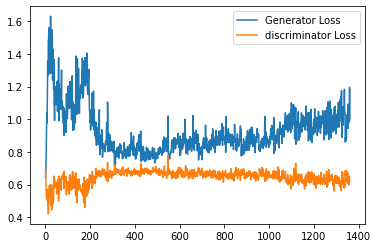

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_27250.pt !


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 27375: Epoch: 88: Generator loss: 1.048783315181732, discriminator loss: 0.6117363781929016 mean disc pred on real images: 0.5741230249404907, fake images: 0.42142996191978455


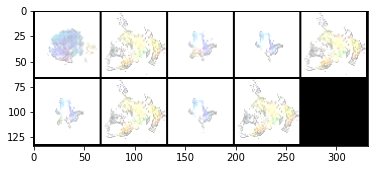

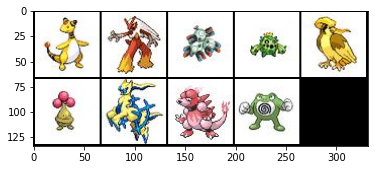

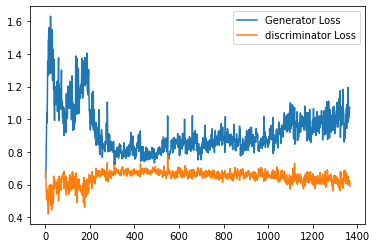

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 27500: Epoch: 88: Generator loss: 1.0508837060928344, discriminator loss: 0.6046495580673218 mean disc pred on real images: 0.5815710425376892, fake images: 0.4181453585624695


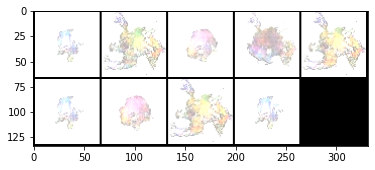

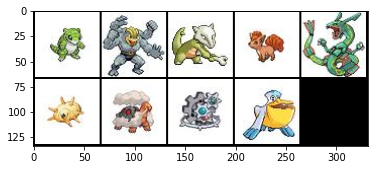

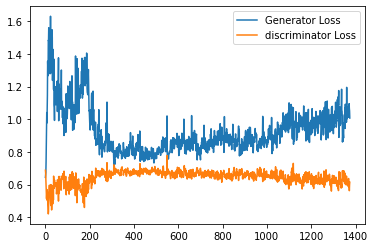

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_27500.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 27625: Epoch: 89: Generator loss: 1.0726716887950898, discriminator loss: 0.6184998233318328 mean disc pred on real images: 0.5801950097084045, fake images: 0.4281924068927765


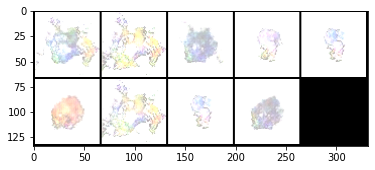

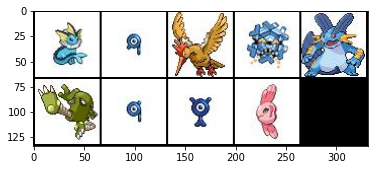

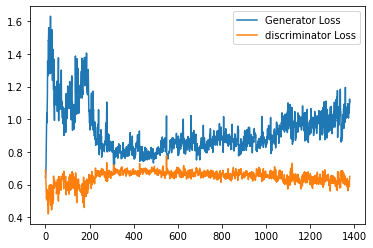

Step 27750: Epoch: 89: Generator loss: 1.0302989857196807, discriminator loss: 0.6323723702430725 mean disc pred on real images: 0.5596221089363098, fake images: 0.42932841181755066


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


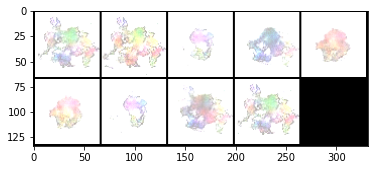

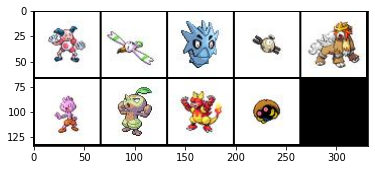

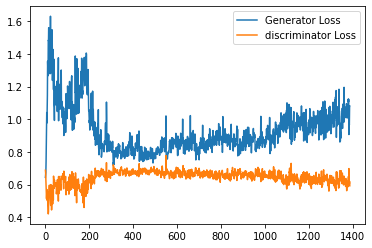

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_27750.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 27875: Epoch: 90: Generator loss: 1.0452981028556825, discriminator loss: 0.6013579542636871 mean disc pred on real images: 0.5829195976257324, fake images: 0.41948938369750977


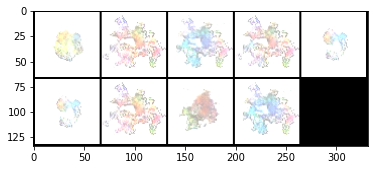

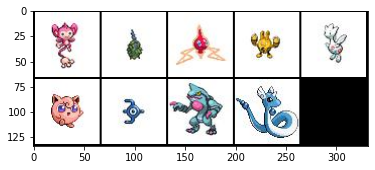

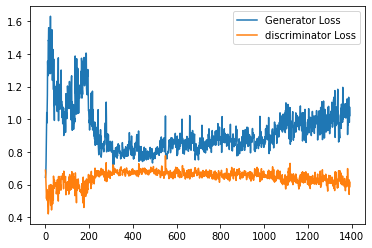

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 28000: Epoch: 90: Generator loss: 0.9885509386062622, discriminator loss: 0.6128481044769287 mean disc pred on real images: 0.5696747303009033, fake images: 0.42673084139823914


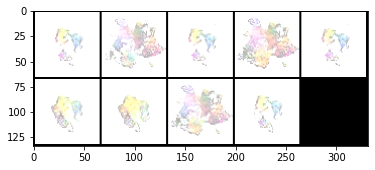

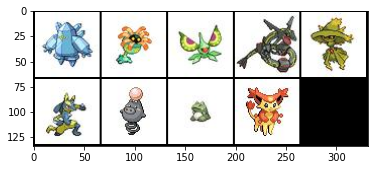

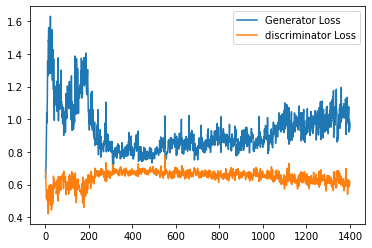

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_28000.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 28125: Epoch: 91: Generator loss: 1.0835584497451782, discriminator loss: 0.6004670057296753 mean disc pred on real images: 0.5907025933265686, fake images: 0.41389769315719604


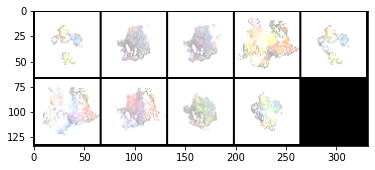

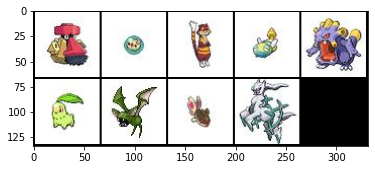

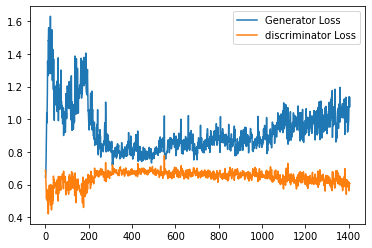

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 28250: Epoch: 91: Generator loss: 1.053634328365326, discriminator loss: 0.6020789864063263 mean disc pred on real images: 0.5811516046524048, fake images: 0.41750332713127136


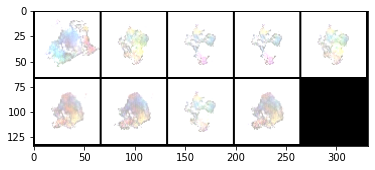

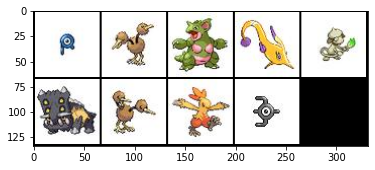

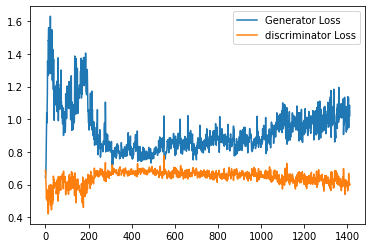

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_28250.pt !


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 28375: Epoch: 91: Generator loss: 1.1384367153644561, discriminator loss: 0.59452854347229 mean disc pred on real images: 0.5911964774131775, fake images: 0.40868520736694336


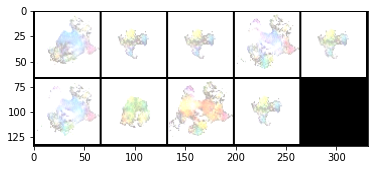

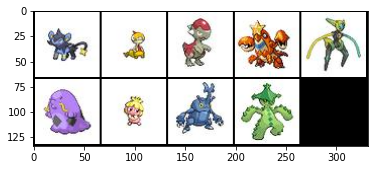

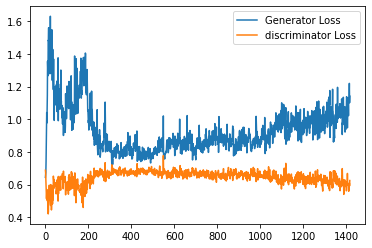

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 28500: Epoch: 92: Generator loss: 1.0588251824378967, discriminator loss: 0.6031972181797027 mean disc pred on real images: 0.5816754102706909, fake images: 0.41818228363990784


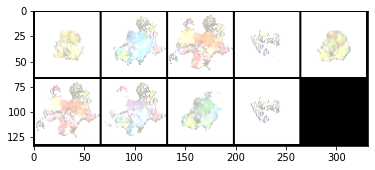

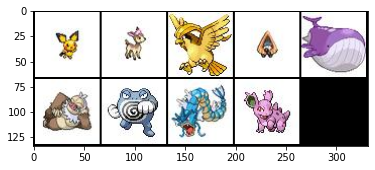

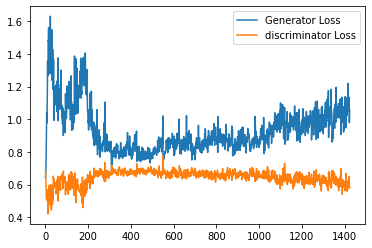

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_28500.pt !


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 28625: Epoch: 92: Generator loss: 1.1027945261001586, discriminator loss: 0.5876412315368652 mean disc pred on real images: 0.5975624322891235, fake images: 0.4116119146347046


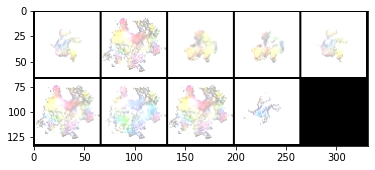

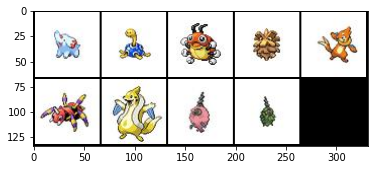

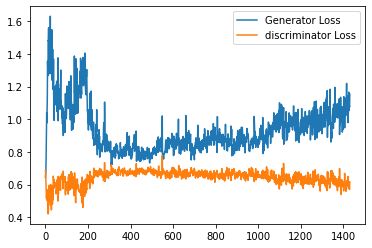

  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 28750: Epoch: 93: Generator loss: 1.020056030511856, discriminator loss: 0.6163049683570861 mean disc pred on real images: 0.5776282548904419, fake images: 0.425202876329422


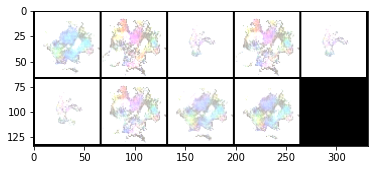

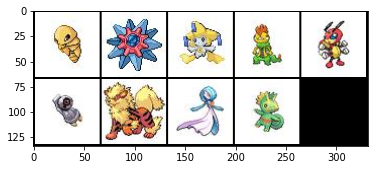

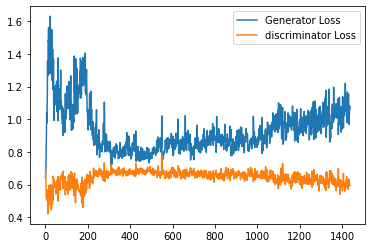

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_28750.pt !
Step 28875: Epoch: 93: Generator loss: 1.0984945911169053, discriminator loss: 0.6038367445468903 mean disc pred on real images: 0.5870615243911743, fake images: 0.4114261865615845


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


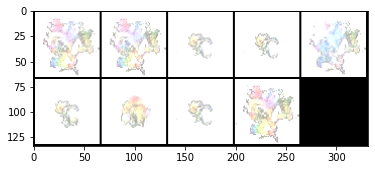

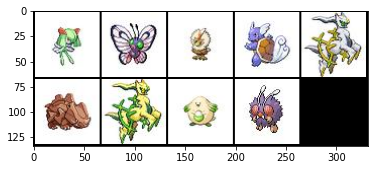

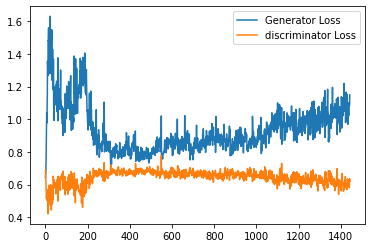

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 29000: Epoch: 93: Generator loss: 1.1009366285800934, discriminator loss: 0.6020103948116302 mean disc pred on real images: 0.5946902632713318, fake images: 0.4171234965324402


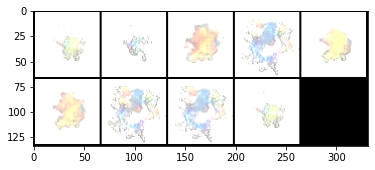

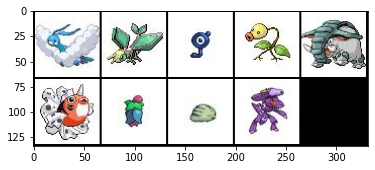

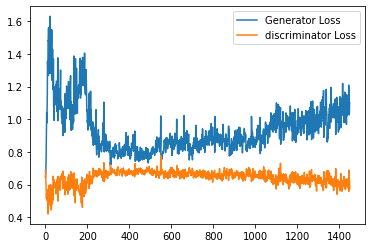

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_29000.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 29125: Epoch: 94: Generator loss: 1.1129651799201965, discriminator loss: 0.573498752117157 mean disc pred on real images: 0.600305438041687, fake images: 0.3998987674713135


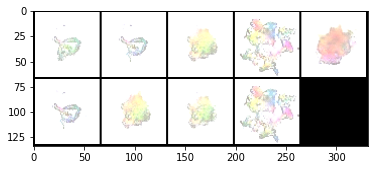

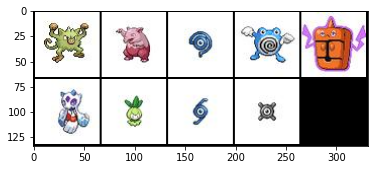

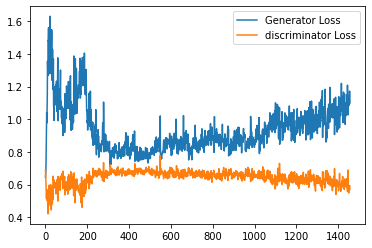

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 29250: Epoch: 94: Generator loss: 1.1823878479003906, discriminator loss: 0.5890084598064422 mean disc pred on real images: 0.6023212671279907, fake images: 0.39310958981513977


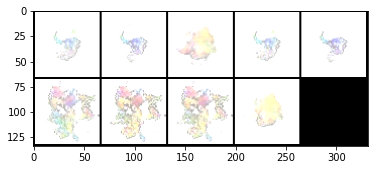

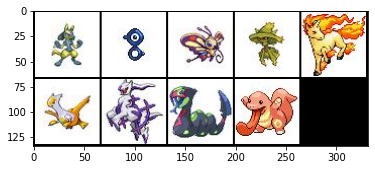

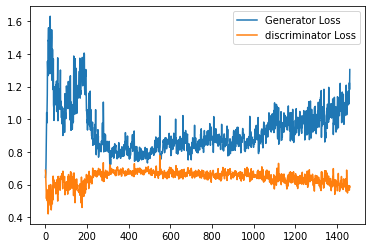

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_29250.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 29375: Epoch: 95: Generator loss: 1.0956543128490448, discriminator loss: 0.6128615779876709 mean disc pred on real images: 0.5848978161811829, fake images: 0.41236206889152527


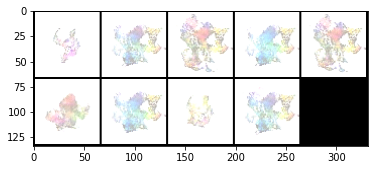

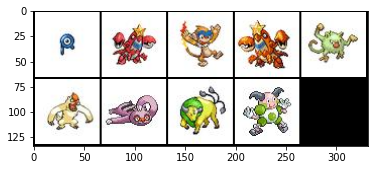

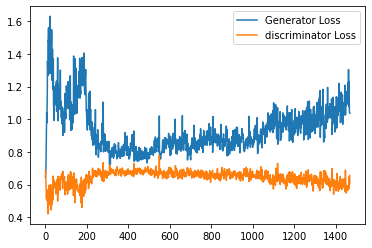

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 29500: Epoch: 95: Generator loss: 1.0557519729137421, discriminator loss: 0.5864776012897491 mean disc pred on real images: 0.5945845246315002, fake images: 0.4090479910373688


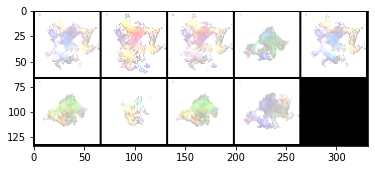

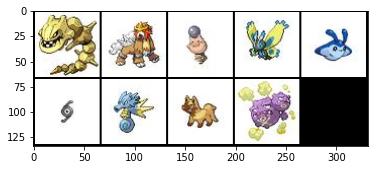

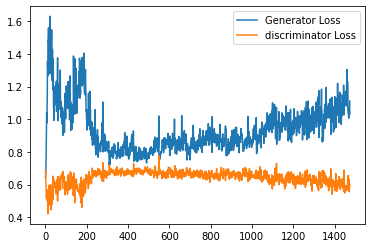

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_29500.pt !


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 29625: Epoch: 95: Generator loss: 1.085747435927391, discriminator loss: 0.6107022812366486 mean disc pred on real images: 0.5842767357826233, fake images: 0.4185716509819031


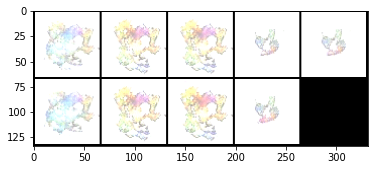

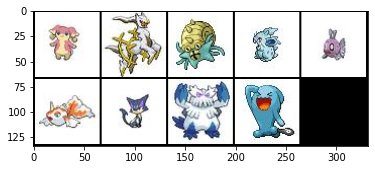

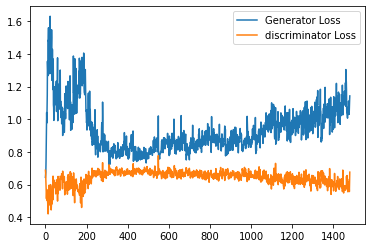

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 29750: Epoch: 96: Generator loss: 1.133527676343918, discriminator loss: 0.6183639006614685 mean disc pred on real images: 0.5814502239227295, fake images: 0.41525787115097046


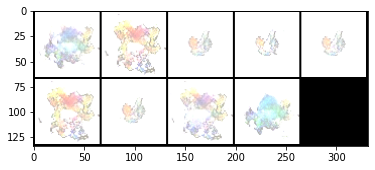

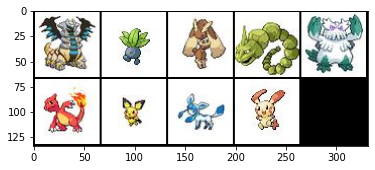

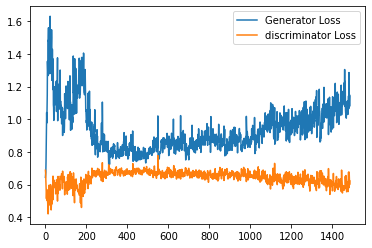

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_29750.pt !


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 29875: Epoch: 96: Generator loss: 1.080332317352295, discriminator loss: 0.5959663486480713 mean disc pred on real images: 0.5878996253013611, fake images: 0.4108378291130066


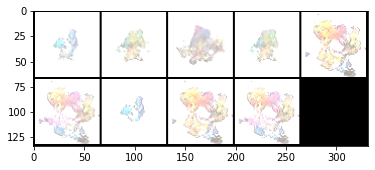

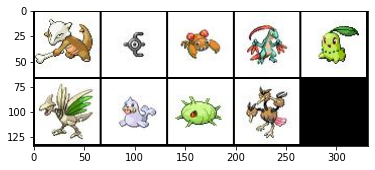

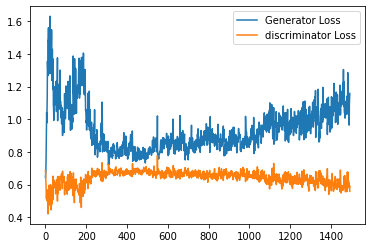

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 30000: Epoch: 97: Generator loss: 1.1079632053375243, discriminator loss: 0.5959319400787354 mean disc pred on real images: 0.5886954665184021, fake images: 0.40422356128692627


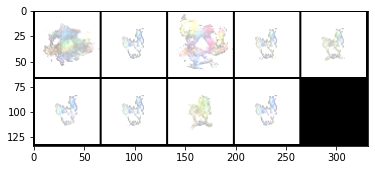

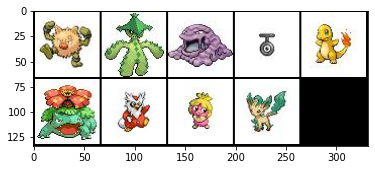

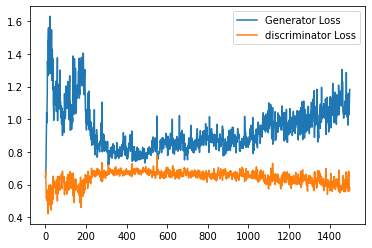

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_30000.pt !


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 30125: Epoch: 97: Generator loss: 1.1234250199794769, discriminator loss: 0.5804186036586761 mean disc pred on real images: 0.600023627281189, fake images: 0.40245985984802246


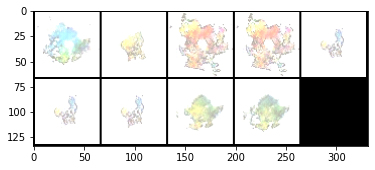

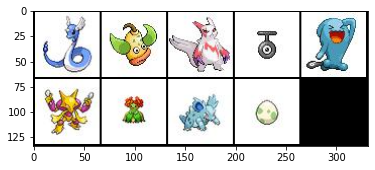

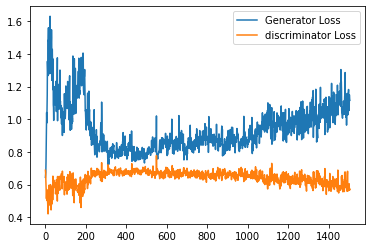

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 30250: Epoch: 97: Generator loss: 1.0384412240982055, discriminator loss: 0.6060952358245849 mean disc pred on real images: 0.5871196389198303, fake images: 0.4240066409111023


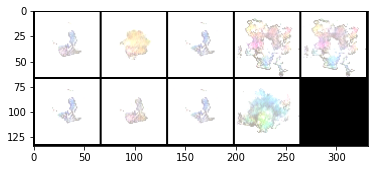

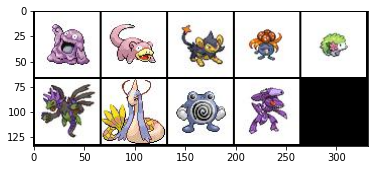

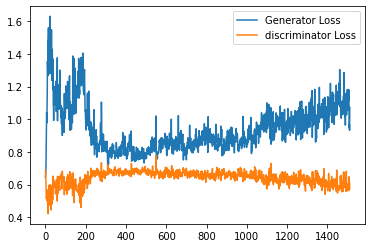

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_30250.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 30375: Epoch: 98: Generator loss: 1.0894939486980437, discriminator loss: 0.586052476644516 mean disc pred on real images: 0.5970179438591003, fake images: 0.4074033498764038


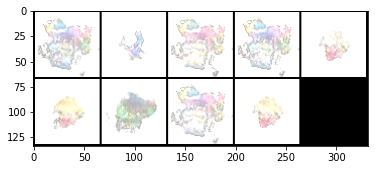

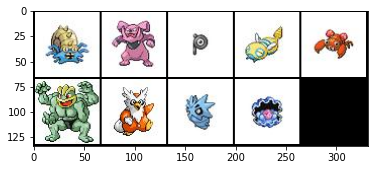

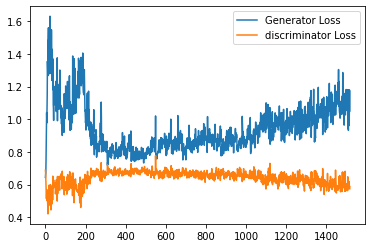

Step 30500: Epoch: 98: Generator loss: 1.11996874666214, discriminator loss: 0.5925869600772857 mean disc pred on real images: 0.60088711977005, fake images: 0.4043731093406677


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


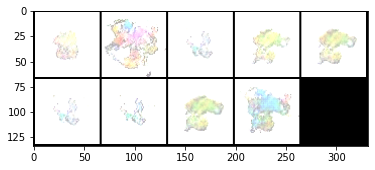

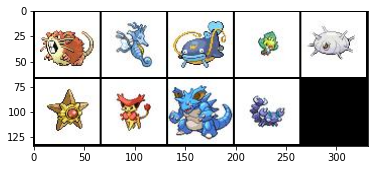

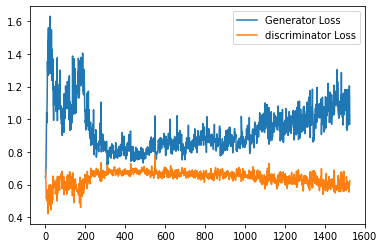

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_30500.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 30625: Epoch: 99: Generator loss: 1.0293961510658265, discriminator loss: 0.6229801161289215 mean disc pred on real images: 0.5684237480163574, fake images: 0.42719897627830505


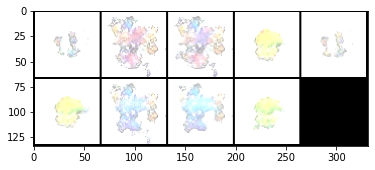

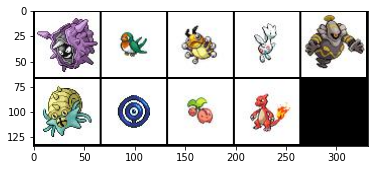

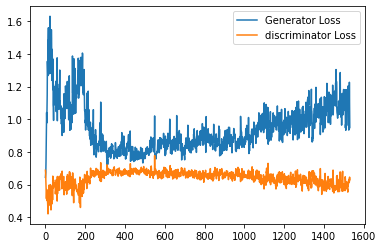

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 30750: Epoch: 99: Generator loss: 1.058733167886734, discriminator loss: 0.5901231288909912 mean disc pred on real images: 0.591427743434906, fake images: 0.4086048901081085


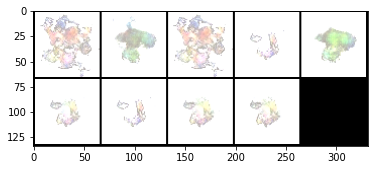

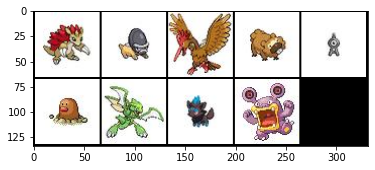

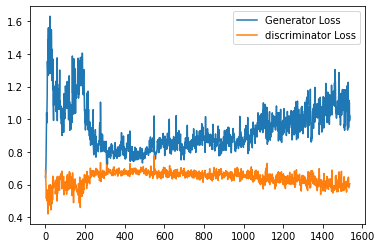

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_30750.pt !


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 30875: Epoch: 99: Generator loss: 1.123802660703659, discriminator loss: 0.596198528766632 mean disc pred on real images: 0.5956733226776123, fake images: 0.4121544063091278


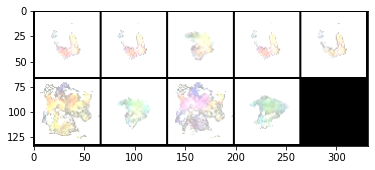

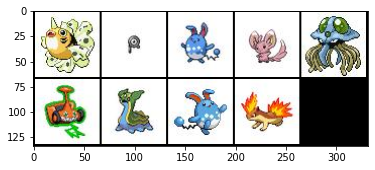

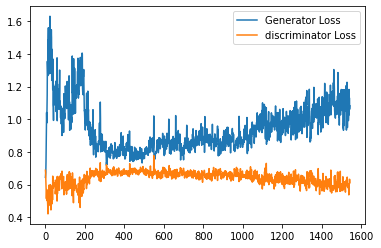

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 31000: Epoch: 100: Generator loss: 1.1480057542324067, discriminator loss: 0.5841958360671997 mean disc pred on real images: 0.5995331406593323, fake images: 0.393649160861969


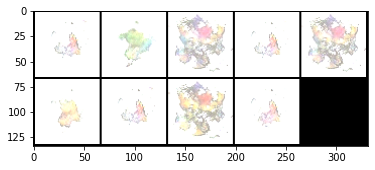

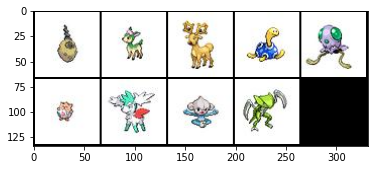

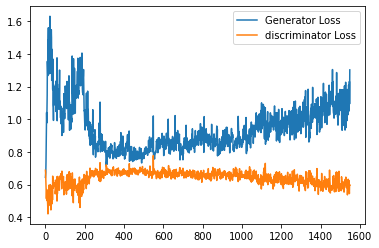

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_31000.pt !


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 31125: Epoch: 100: Generator loss: 1.0754138588905335, discriminator loss: 0.5871037185192108 mean disc pred on real images: 0.597920835018158, fake images: 0.4081494212150574


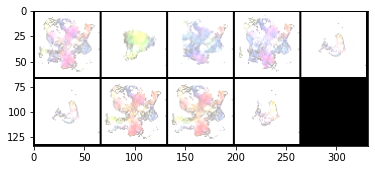

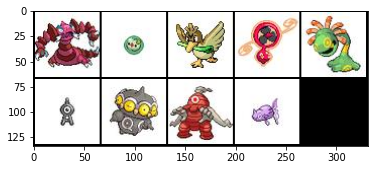

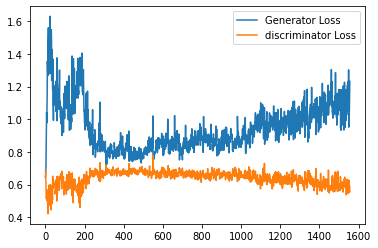

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 31250: Epoch: 101: Generator loss: 1.0823568534851074, discriminator loss: 0.5914956750869751 mean disc pred on real images: 0.599306046962738, fake images: 0.40868210792541504


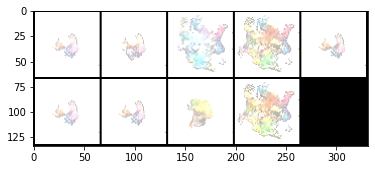

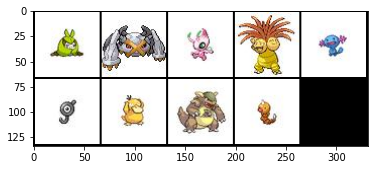

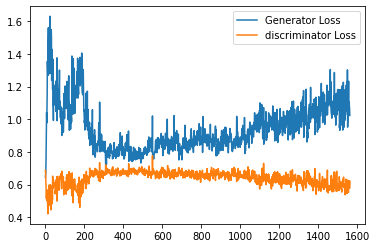

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_31250.pt !


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 31375: Epoch: 101: Generator loss: 1.1397924852371215, discriminator loss: 0.5812072417736054 mean disc pred on real images: 0.6065643429756165, fake images: 0.3965396583080292


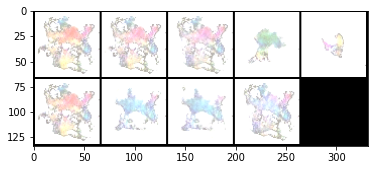

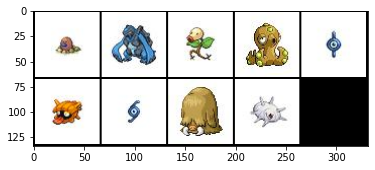

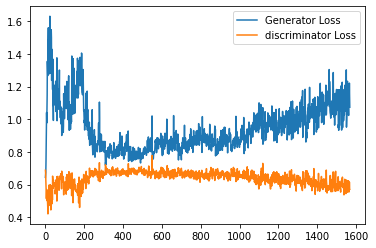

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 31500: Epoch: 101: Generator loss: 1.1252444934844972, discriminator loss: 0.5978894865512848 mean disc pred on real images: 0.60040682554245, fake images: 0.39920276403427124


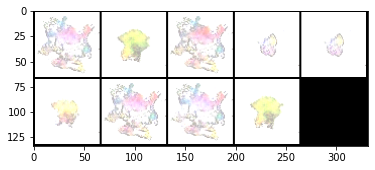

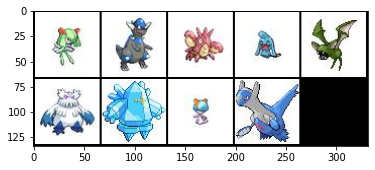

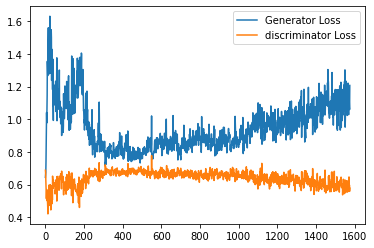

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_31500.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 31625: Epoch: 102: Generator loss: 1.1141279892921447, discriminator loss: 0.5818681175708771 mean disc pred on real images: 0.6077752709388733, fake images: 0.4071659743785858


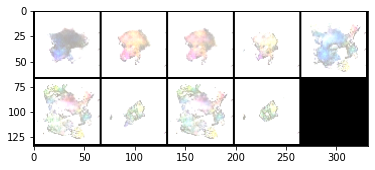

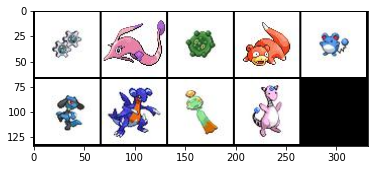

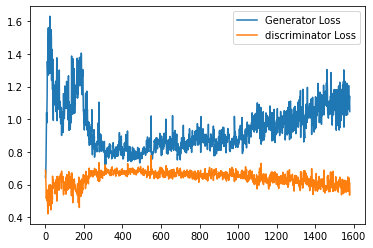

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 31750: Epoch: 102: Generator loss: 1.1246147375106812, discriminator loss: 0.5864075174331665 mean disc pred on real images: 0.6024911403656006, fake images: 0.4047923982143402


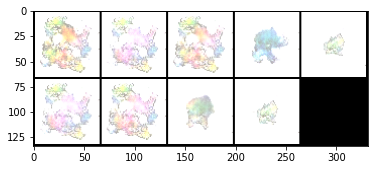

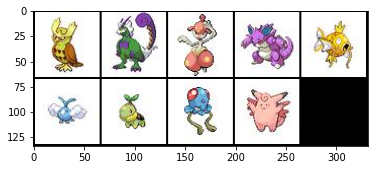

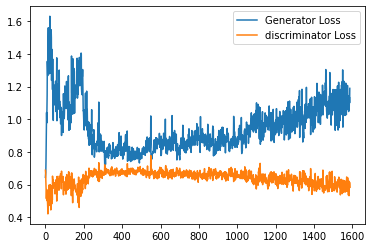

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_31750.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 31875: Epoch: 103: Generator loss: 1.0596497988700866, discriminator loss: 0.6448174610137939 mean disc pred on real images: 0.5678857564926147, fake images: 0.43039488792419434


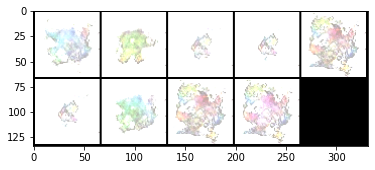

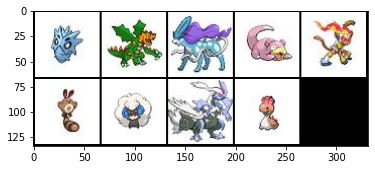

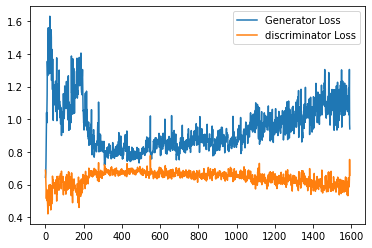

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 32000: Epoch: 103: Generator loss: 1.1059273037910462, discriminator loss: 0.5835054502487182 mean disc pred on real images: 0.6071037650108337, fake images: 0.4019649624824524


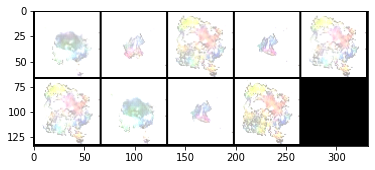

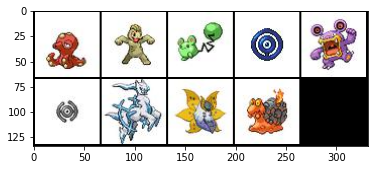

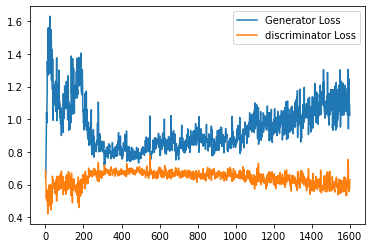

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_32000.pt !


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 32125: Epoch: 103: Generator loss: 1.140309940099716, discriminator loss: 0.5906123371124268 mean disc pred on real images: 0.5995976328849792, fake images: 0.4003883898258209


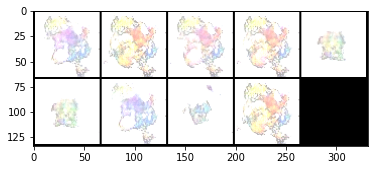

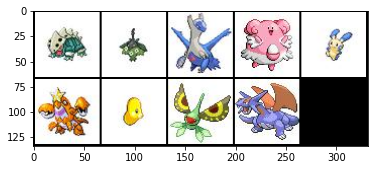

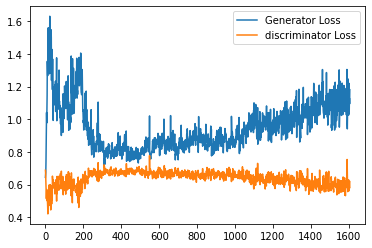

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 32250: Epoch: 104: Generator loss: 1.0379517843723298, discriminator loss: 0.5905577654838562 mean disc pred on real images: 0.5943590402603149, fake images: 0.4094338119029999


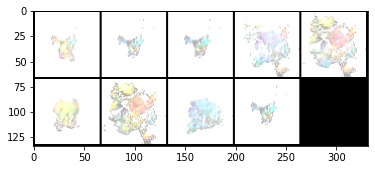

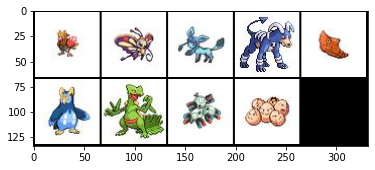

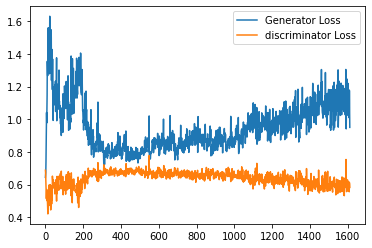

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_32250.pt !


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 32375: Epoch: 104: Generator loss: 1.1880851840972901, discriminator loss: 0.5692191212177277 mean disc pred on real images: 0.6127327680587769, fake images: 0.38733920454978943


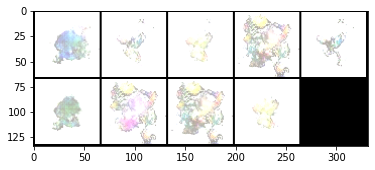

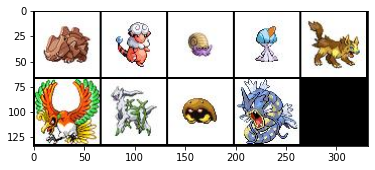

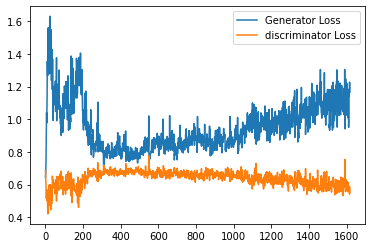

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 32500: Epoch: 105: Generator loss: 1.1900397429466247, discriminator loss: 0.5981677927970886 mean disc pred on real images: 0.5944574475288391, fake images: 0.39963483810424805


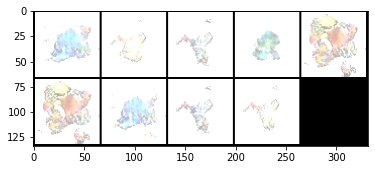

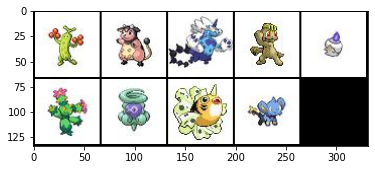

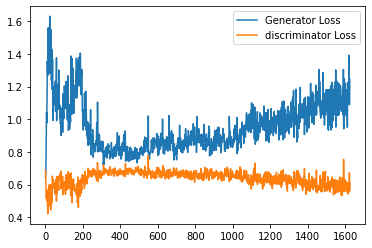

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_32500.pt !


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 32625: Epoch: 105: Generator loss: 1.2014625658988953, discriminator loss: 0.5477114360332489 mean disc pred on real images: 0.6254170536994934, fake images: 0.3824191689491272


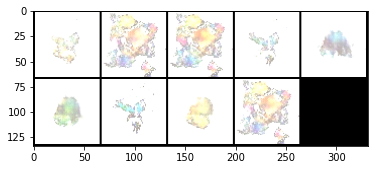

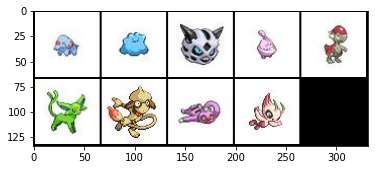

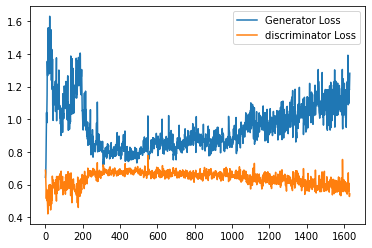

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 32750: Epoch: 105: Generator loss: 1.1499785168170928, discriminator loss: 0.5778060936927796 mean disc pred on real images: 0.6214072704315186, fake images: 0.3993132710456848


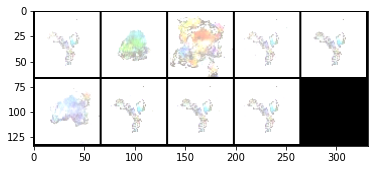

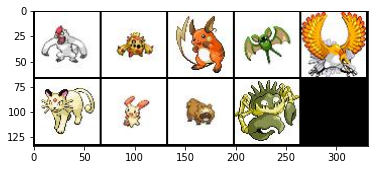

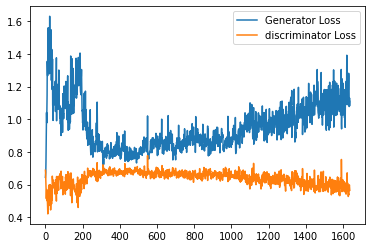

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_32750.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 32875: Epoch: 106: Generator loss: 1.1973426406383514, discriminator loss: 0.5778082230091095 mean disc pred on real images: 0.6179928183555603, fake images: 0.388649046421051


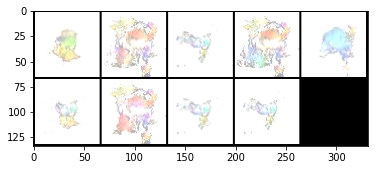

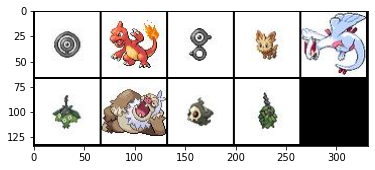

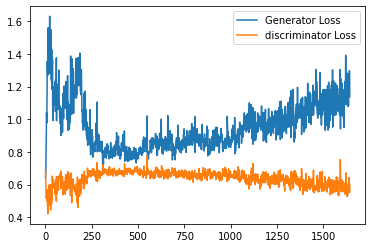

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 33000: Epoch: 106: Generator loss: 1.1896901071071624, discriminator loss: 0.5600231301784515 mean disc pred on real images: 0.6246000528335571, fake images: 0.3846889138221741


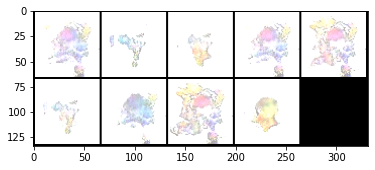

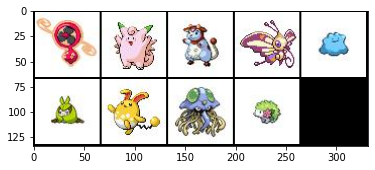

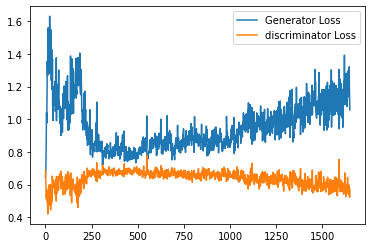

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_33000.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 33125: Epoch: 107: Generator loss: 1.1509795784950256, discriminator loss: 0.5693145325183868 mean disc pred on real images: 0.618388295173645, fake images: 0.3913741111755371


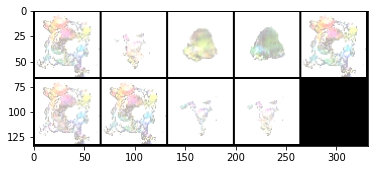

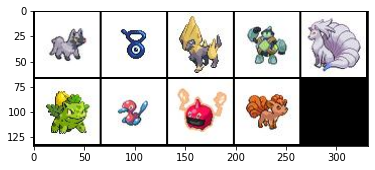

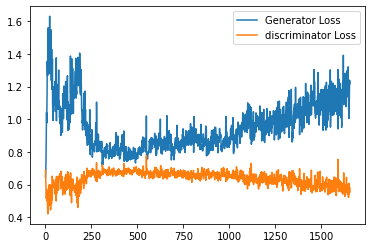

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 33250: Epoch: 107: Generator loss: 1.112626886367798, discriminator loss: 0.579116269826889 mean disc pred on real images: 0.6021187901496887, fake images: 0.40020251274108887


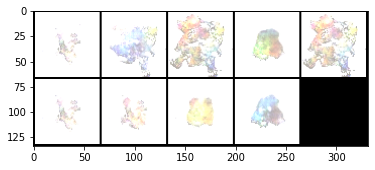

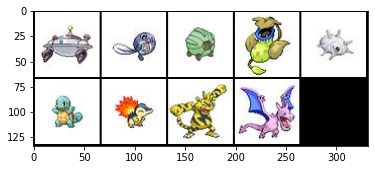

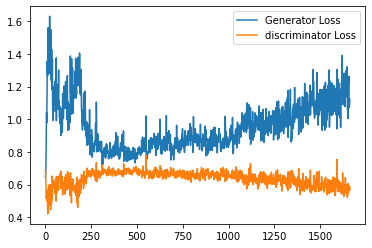

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_33250.pt !


[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)


  0%|          | 0/309 [00:00<?, ?it/s]

[W ParallelNative.cpp:214] Warning: Cannot set number of intraop threads after parallel work has started or after set_num_threads call when using native parallel backend (function set_num_threads)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 33375: Epoch: 108: Generator loss: 1.1409902381896972, discriminator loss: 0.639060628414154 mean disc pred on real images: 0.5915939211845398, fake images: 0.4112912118434906


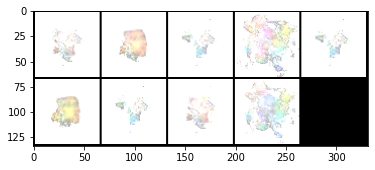

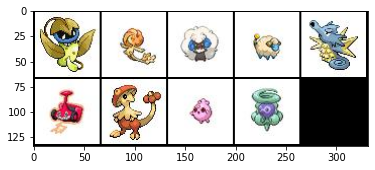

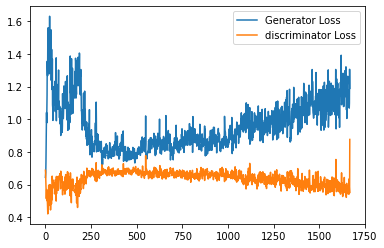

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 33500: Epoch: 108: Generator loss: 1.0900451941490172, discriminator loss: 0.6433731865882873 mean disc pred on real images: 0.577560544013977, fake images: 0.4308260679244995


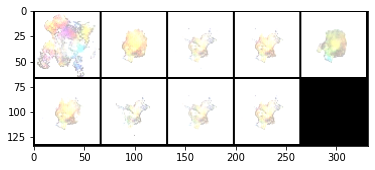

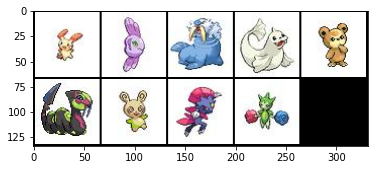

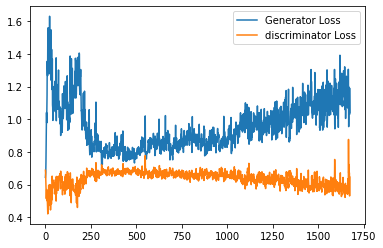

Saving intermediate model with name experiment_3/dc_gen_standard_dc_disc_custom_p01_33500.pt !


Traceback (most recent call last):
  File "/Users/moose_abdool/miniconda3/envs/cs236g_py37/lib/python3.7/multiprocessing/queues.py", line 242, in _feed
    send_bytes(obj)
  File "/Users/moose_abdool/miniconda3/envs/cs236g_py37/lib/python3.7/multiprocessing/connection.py", line 200, in send_bytes
    self._send_bytes(m[offset:offset + size])
  File "/Users/moose_abdool/miniconda3/envs/cs236g_py37/lib/python3.7/multiprocessing/connection.py", line 404, in _send_bytes
    self._send(header + buf)
  File "/Users/moose_abdool/miniconda3/envs/cs236g_py37/lib/python3.7/multiprocessing/connection.py", line 368, in _send
    n = write(self._handle, buf)
BrokenPipeError: [Errno 32] Broken pipe


KeyboardInterrupt: 

In [10]:
import matplotlib.pyplot as plt
from tqdm.auto import tqdm

cur_step = 0
generator_losses = []
discriminator_losses = []
discriminator_fake_preds = [] # median value of P(real) the discriminator predicts on the fake images (per batch)
discriminator_real_preds = [] # median value of P(real) the discriminator predicts on the real images (per batch)


for epoch in range(n_epochs):
    # Dataloader returns the (real_images, labels)
    for real, true_labels in tqdm(pkmn_dataloader):
        cur_batch_size = len(real)
        real = real.to(device)

        mean_iteration_discriminator_loss = 0
        for _ in range(disc_repeats):
            ### Update discriminator ###
            disc_opt.zero_grad()
            fake_noise = get_noise(cur_batch_size, z_dim, device=device)
            fake = gen(fake_noise)
            disc_fake_pred = disc(fake.detach())
            disc_real_pred = disc(real)

            # compute discriminator loss
            disc_loss = disc_loss_func(disc_fake_pred, disc_real_pred, device)

            # Keep track of the average discriminator loss in this batch
            mean_iteration_discriminator_loss += disc_loss.item() / disc_repeats
            # Update gradients
            # when using WGAN, we have retain_graph = True, but it probably takes longer
            disc_loss.backward(retain_graph=False)
            # Update optimizer
            disc_opt.step()
            
        discriminator_losses += [mean_iteration_discriminator_loss]
        # notice this only takes the last one from the iteration
        discriminator_fake_preds += [torch.mean(disc_fake_pred)]
        discriminator_real_preds += [torch.mean(disc_real_pred)]

        ### Update generator ###
        mean_iteration_gen_loss = 0
        for _ in range(gen_repeats):
          gen_opt.zero_grad()
          fake_noise_2 = get_noise(cur_batch_size, z_dim, device=device)
          fake_2 = gen(fake_noise_2)
          disc_fake_pred = disc(fake_2)

          # compute gen loss
          gen_loss = gen_loss_func(disc_fake_pred, device)
          
          mean_iteration_gen_loss += gen_loss.item() / gen_repeats
          
          gen_loss.backward()

          # Update the weights
          gen_opt.step()

        # Keep track of the average generator loss
        generator_losses += [mean_iteration_gen_loss]
        

        ### Visualization code ###
        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            disc_mean = sum(discriminator_losses[-display_step:]) / display_step
            # maybe print out the last values here ? To see how stable it is overtime ? These all seem to be very close to 0.5 / 1
            disc_prediction_real = sum(discriminator_real_preds[-display_step:]) / display_step
            disc_prediction_fake = sum(discriminator_fake_preds[-display_step:]) / display_step
            print(f"Step {cur_step}: Epoch: {epoch}: Generator loss: {gen_mean}, discriminator loss: {disc_mean} mean disc pred on real images: {disc_prediction_real}, fake images: {disc_prediction_fake}")
            show_tensor_images(fake[0:imgs_to_display], imgs_to_display, size = (3,64,64), denorm_transform = denorm_transform)
            show_tensor_images(real[0:imgs_to_display], imgs_to_display, size = (3,64,64), denorm_transform = denorm_transform)
            step_bins = 20
            
            # todo: add proper labels to this plot
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(discriminator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="discriminator Loss"
            )
            plt.legend()
            plt.show()
        
        # increase the current step (ie. one batch)
        cur_step += 1
        
    if periodic_saving and epoch % epoch_save_step == 0:
      outfile_name = "{}_{}.pt".format(save_prefix, cur_step)
      print("===== Saving intermediate model with name {} ! ====".format(outfile_name))
      save_model(gen, outfile_name)

In [ ]:
# Save the final model

out_file = "second_gan_with_standard_dcgan_arch_after_149epochs.pt"
  
#save_model(gen, out_file)

In [ ]:
# Load model for inference

gen.load_state_dict(torch.load("dcgan_standard_snapshots/{}".format(out_file)))

# Performing inference - actually, maybe I ran some other cell after this so it's not really well defined
num_samples = 10

sample_vector = get_noise(num_samples, z_dim)

fake_images = gen(sample_vector)

print("Shape of fake images are: {}".format(fake_images.shape))

output_size = gen.output_dim
# + 0.9
show_tensor_images(fake_images, num_images=num_samples, size=(1,256, 256), use_uniform_transform = True, denorm_transform = None)

In [ ]:
# Originally, the image is in the [0, 1] space
# After some normalization, it's another another space, hopefully around N(0,1)
# but we undo that transformation, so theorectically, we should be back in the [0, 1] space
# maybe we can use a feature matching loss as well ?